**Общая информация**

**Срок сдачи:** 13 марта 2017, 06:00 <br\>
**Штраф за опоздание:** -2 балла после 06:00 13 марта, -4 балла после 06:00 20 марта, -6 баллов после 06:00 27 марта

При отправлении ДЗ указывайте фамилию в названии файла
Присылать ДЗ необходимо в виде ссылки на свой github репозиторий в slack @alkhamush

Необходимо в slack создать таск в приватный чат:
/todo Фамилия Имя ссылка на гитхаб @alkhamush
Пример:
/todo Ксения Стройкова https://github.com/stroykova/spheremailru/stroykova_hw1.ipynb @alkhamush

Используйте данный Ipython Notebook при оформлении домашнего задания.

###### Задание 1 (2 баллов)
Реализовать KNN в классе MyKNeighborsClassifier (обязательное условие: точность не ниже sklearn реализации)
Разберитесь самостоятельно, какая мера расстояния используется в KNeighborsClassifier дефолтно и реализуйте свой алгоритм именно с этой мерой. Самостоятельно разберитесь, как считается score из KNeighborsClassifier и реализуйте аналог в своём классе.

###### Задание 2 (2 балла)
Добиться скорости работы на fit,  predict и predict_proba сравнимой со sklearn 4 балла для iris и mnist
Для этого используем numpy

###### Задание 3 (2 балла)
Для iris найдите такой параметр n_neighbors, при котором выдаётся наилучший score. Нарисуйте график зависимости score от n_neighbors

###### Задание 3 (2 балла)
Выполнить требования pep8

###### Задание 5 (2 балла)
Описать для чего нужны следующие библиотеки/классы/функции (список будет ниже)


In [166]:
import numpy as np
import matplotlib.pyplot as plt

import seaborn as sns
from sklearn import datasets
from scipy import stats
from scipy.sparse import issparse
from sklearn.base import ClassifierMixin
from sklearn.datasets import fetch_mldata
from sklearn.neighbors.base import NeighborsBase, KNeighborsMixin, SupervisedIntegerMixin 
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
%load_ext pycodestyle_magic

The pycodestyle_magic extension is already loaded. To reload it, use:
  %reload_ext pycodestyle_magic


In [174]:
class MyKNeighborsClassifier(NeighborsBase, KNeighborsMixin,
                             SupervisedIntegerMixin, ClassifierMixin):

    def __init__(self, n_neighbors=5):
        self.n_neighbors = n_neighbors
    def numpy_dist(self, X, Y):
        x_dist = (X ** 2).sum(axis=1)
        y_dist = (Y ** 2).sum(axis=1)
        xy_dist = X.dot(Y.T)
        dist =np.abs(- 2 * xy_dist + y_dist + x_dist.reshape(-1, 1))
        return np.sqrt(dist)
    def my_kneighbors(self, X, n_neighbors=None):
        if n_neighbors is None:
            n_neighbors = self.n_neighbors
        shift =  5000
        Y = self._fit_X[0: shift, :]
        dist = self.numpy_dist(X, Y)
        old_neighbors_ind = np.argsort(dist, axis=1)[:, :n_neighbors]
        start_shift = shift
        #print("Old_neighbors = \n", old_neighbors_ind)
        while (start_shift < self._fit_X.shape[0]):
            Y = self._fit_X[start_shift:start_shift + shift, :]
            dist = self.numpy_dist(X, Y)
            new_neighbors_ind = np.argsort(dist, axis=1)[:, :n_neighbors]
            new_neighbors_ind = new_neighbors_ind + start_shift
            old_neighbors_ind = np.concatenate((old_neighbors_ind, new_neighbors_ind), axis=1)
            start_shift += shift
        
        if (start_shift > shift):
            #print("old_neighbors_ind = \n", old_neighbors_ind)
            neighbors = np.empty(((X.shape[0], n_neighbors)), dtype=np.int)
            for i, row in enumerate(X):
                #print("old_neighbors_ind[i,:]", old_neighbors_ind[i,:])
                Y = self._fit_X[old_neighbors_ind[i,:], :]
                dist = self.numpy_dist(row.reshape(1, row.shape[0]), Y)
                n = np.argsort(dist, axis=1)[:, :n_neighbors]
                #print("-n = ",old_neighbors_ind[i,:][n])
                neighbors[i] = old_neighbors_ind[i,:][n]
        else:
            neighbors = old_neighbors_ind
        return neighbors

    def fit(self, X, y):
        self.classes_, _ = np.unique(y, return_inverse=True)
        self._fit_X = np.array(X, dtype = np.float32)
        self._y = np.array(y, dtype=np.int16)
        return self

    def predict(self, X):
        neigh_ind = self.my_kneighbors(X)
        classes_ = self.classes_
        _y = self._y
        n_samples = X.shape[0]
        y_pred = np.empty(n_samples, dtype=classes_[0].dtype)
        mode, _ = stats.mode(_y[neigh_ind], axis=1)
        y_pred = mode
        return y_pred.ravel()

    def predict_proba(self, X):
        neigh_ind = self.my_kneighbors(X)
        classes_ = self.classes_
        _y = self._y
        n_samples = X.shape[0]
        weights = np.ones_like(neigh_ind, dtype=np.int)
        all_rows = np.arange(X.shape[0])
        pred_labels = np.array(_y[neigh_ind], dtype=np.int)
        proba = np.zeros((n_samples, classes_.size))
        for i, idx in enumerate(pred_labels.T):
            proba[all_rows, idx] += weights[:, i]
        return proba / weights.shape[1]

    def score(self, X, y):
        y_pred = self.predict(X)
        score = y == y_pred
        return np.sum(score) / score.shape[0]

**IRIS**

In [146]:
iris = datasets.load_iris()

In [147]:
X_train, X_test, y_train, y_test = train_test_split(iris.data, iris.target, test_size=0.1, stratify=iris.target)

In [148]:
clf = KNeighborsClassifier(n_neighbors=2)
my_clf = MyKNeighborsClassifier(n_neighbors=2)

In [149]:
%time clf.fit(X_train, y_train)

CPU times: user 2.29 ms, sys: 4.26 ms, total: 6.55 ms
Wall time: 388 ms


KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
           metric_params=None, n_jobs=1, n_neighbors=2, p=2,
           weights='uniform')

In [62]:
my_clf._fit_X


AttributeError: 'MyKNeighborsClassifier' object has no attribute '_fit_X'

In [150]:
%time my_clf.fit(X_train, y_train)

CPU times: user 160 µs, sys: 17 µs, total: 177 µs
Wall time: 143 µs


MyKNeighborsClassifier(n_neighbors=2)

In [151]:
%time clf.predict(X_test)

CPU times: user 1.29 ms, sys: 144 µs, total: 1.44 ms
Wall time: 1.93 ms


array([1, 0, 2, 0, 2, 1, 1, 2, 1, 0, 0, 2, 0, 2, 2])

In [152]:
%time my_clf.predict(X_test)

CPU times: user 1.03 ms, sys: 4.12 ms, total: 5.15 ms
Wall time: 1.67 s


array([1, 0, 2, 0, 2, 1, 1, 2, 1, 0, 0, 2, 0, 2, 2], dtype=int16)

In [153]:
%time clf.predict_proba(X_test)

CPU times: user 1.07 ms, sys: 119 µs, total: 1.19 ms
Wall time: 879 µs


array([[0., 1., 0.],
       [1., 0., 0.],
       [0., 0., 1.],
       [1., 0., 0.],
       [0., 0., 1.],
       [0., 1., 0.],
       [0., 1., 0.],
       [0., 0., 1.],
       [0., 1., 0.],
       [1., 0., 0.],
       [1., 0., 0.],
       [0., 0., 1.],
       [1., 0., 0.],
       [0., 0., 1.],
       [0., 0., 1.]])

In [154]:
%time my_clf.predict_proba(X_test)

CPU times: user 910 µs, sys: 101 µs, total: 1.01 ms
Wall time: 688 µs


array([[0., 1., 0.],
       [1., 0., 0.],
       [0., 0., 1.],
       [1., 0., 0.],
       [0., 0., 1.],
       [0., 1., 0.],
       [0., 1., 0.],
       [0., 0., 1.],
       [0., 1., 0.],
       [1., 0., 0.],
       [1., 0., 0.],
       [0., 0., 1.],
       [1., 0., 0.],
       [0., 0., 1.],
       [0., 0., 1.]])

In [155]:
clf.score(X_test, y_test)

0.9333333333333333

In [156]:
my_clf.score(X_test, y_test)

0.9333333333333333

In [ ]:
# Задание 3

Old_neighbors = 
 [[45]
 [44]
 [32]
 [ 6]
 [29]
 [26]
 [ 5]
 [43]
 [18]
 [ 8]
 [23]
 [27]
 [32]
 [ 4]
 [43]]
old_neighbors_ind = 
 [[45 55]
 [44 68]
 [32 72]
 [ 6 81]
 [29 80]
 [26 90]
 [ 5 86]
 [43 94]
 [18 84]
 [ 8 95]
 [23 59]
 [27 90]
 [32 72]
 [ 4 90]
 [43 64]]
old_neighbors_ind = 
 [[ 45  55 124]
 [ 44  68 129]
 [ 32  72 129]
 [  6  81 101]
 [ 29  80 106]
 [ 26  90 104]
 [  5  86 106]
 [ 43  94 122]
 [ 18  84 103]
 [  8  95 124]
 [ 23  59 118]
 [ 27  90 114]
 [ 32  72 128]
 [  4  90 100]
 [ 43  64 102]]
neighbors[i]
 [124]
neighbors[i]
 [129]
neighbors[i]
 [32]
neighbors[i]
 [101]
neighbors[i]
 [106]
neighbors[i]
 [26]
neighbors[i]
 [5]
neighbors[i]
 [43]
neighbors[i]
 [18]
neighbors[i]
 [95]
neighbors[i]
 [118]
neighbors[i]
 [27]
neighbors[i]
 [32]
neighbors[i]
 [100]
neighbors[i]
 [64]
Old_neighbors = 
 [[ 0]
 [ 1]
 [ 2]
 [ 3]
 [ 4]
 [ 5]
 [ 6]
 [ 7]
 [ 8]
 [ 9]
 [10]
 [11]
 [12]
 [13]
 [14]
 [15]
 [16]
 [17]
 [18]
 [19]
 [20]
 [21]
 [22]
 [23]
 [ 4]
 [24]
 [26]
 [21]
 [28]
 [2

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()



neighbors[i]
 [66 31  5 48 86 44]
neighbors[i]
 [ 55  45  89 124  12  87]
neighbors[i]
 [ 56  62 134  26 104  28]
neighbors[i]
 [57  2 88 67 18 39]
neighbors[i]
 [ 58  41 113  94 105  38]
neighbors[i]
 [ 59  37  78 107  67  13]
neighbors[i]
 [ 60  18   2  84  57 125]
neighbors[i]
 [ 61 104 110  26  62  28]
neighbors[i]
 [ 62  56  26 104 121  90]
neighbors[i]
 [ 63  22  92 106  80  40]
neighbors[i]
 [ 64   4 100 114 121  79]
neighbors[i]
 [65 16 71 42 46 19]
neighbors[i]
 [66 54  5 31 48 44]
neighbors[i]
 [ 88  13  23 107  59  57]
neighbors[i]
 [ 68  14  29  11 132 111]
neighbors[i]
 [ 69  63  49 127  86  22]
neighbors[i]
 [118  81 101  13   6 107]
neighbors[i]
 [71 16 65 42 20 46]
neighbors[i]
 [ 72 123 128  74  85  32]
neighbors[i]
 [119 101  50  39  81 107]
neighbors[i]
 [ 74 123  72 128  85  32]
neighbors[i]
 [ 75 111 116 132  68  29]
neighbors[i]
 [ 76  36   0  15  41 105]
neighbors[i]
 [ 86  19  48  54  46 127]
neighbors[i]
 [78 37 59 95 97  8]
neighbors[i]
 [ 79  90 109 121  64 

 [  7 110  28  96 115  56 134  62  47  61]
neighbors[i]
 [  6  95 101  97  78  39  37  59  13  50]
neighbors[i]
 [  9  15  36 120  76  38 102  58   0  94]
neighbors[i]
 [ 10 117 105  79   0  41 109  64 121  90]
neighbors[i]
 [ 14  68  29  92  55 129 124  87 132  98]
neighbors[i]
 [ 12  55 124  33  89  30  45  35 131  98]
neighbors[i]
 [ 13  88  67 107  39  59  23  50   8   6]
neighbors[i]
 [ 14  68  11  29  87 130   1  92 132 111]
neighbors[i]
 [ 15  36  58   0  76  41  38 120 105 113]
neighbors[i]
 [16 65 42 71 46 19 20 49 48 77]
neighbors[i]
 [ 17  99  84  34 103   2  60  83  18  57]
neighbors[i]
 [ 18  60  57   2 125  84 103 126  67  88]
neighbors[i]
 [19 46 48 86 77 20 54 66 31 49]
neighbors[i]
 [20 46 19 48 82 66 54 31 86 77]
neighbors[i]
 [ 21  51 112 100   4  90  27  64  24  93]
neighbors[i]
 [ 22  63  92 106  29  40  80   5  68 127]
neighbors[i]
 [ 23 107  88  67  13 118  59  39  81  50]
neighbors[i]
 [  4 113  51  94  64  25 117 100  43  41]
neighbors[i]
 [ 24 113  51  94   4 

neighbors[i]
 [  6  95 101  97  78  39  37  59  13  50 133  81  73 126 107]
neighbors[i]
 [  9  15  36 120  76  38 102  58  94   0  93  41 105 122  43]
neighbors[i]
 [ 10 117 105  79   0 109  41  64 121  90  24   4  76  36  58]
neighbors[i]
 [ 14  68  29  92  55 129 124  87 132  98 130  32  22 106   1]
neighbors[i]
 [ 12  55 124  33  89  30  45  35 131  98  87  11  14  97  92]
neighbors[i]
 [ 13  88  67 107  39  59  23  50   8   6 118  57  81  78  37]
neighbors[i]
 [ 14  68  11  29  87 130   1  92 132 111  55 124 129  45 116]
neighbors[i]
 [ 15  36  58   0  76  41  38 120 105 113  94 102 117 122  43]
neighbors[i]
 [16 65 42 71 46 19 20 49 48 77 86 82 66 54 31]
neighbors[i]
 [ 17  99  84  34 103   2  60  83  18  57  67  88 125  13  23]
neighbors[i]
 [ 18  60  57   2 125  84 103 126  67  88  39  50  83  13  59]
neighbors[i]
 [ 19  46  48  86  77  20  54  66  31  49   5  82  52 127 106]
neighbors[i]
 [20 46 19 48 82 66 54 31 86 77  5 52 44 49 80]
neighbors[i]
 [ 21  51 112 100   4  90  27

neighbors[i]
 [ 55  45  89 124  12  87  14  11  33  98  85  97   1  68  29 130 133 131
  35]
neighbors[i]
 [ 56  62 134  26 104  28  47  27 114 121 115  90 100 109  61  79   4 110
  91]
neighbors[i]
 [ 57   2  88  67  18  39 125  13  60  50 107  59  23 126  34   8  78  37
  73]
neighbors[i]
 [ 58  41 113  94 105  38 120  36  15   0  43 122 102 117  24  93  64   4
  76]
neighbors[i]
 [ 59  37  78 107  67  13  39  88  23   8  95   6 118  81  50  57 101  73
  70]
neighbors[i]
 [ 60  18   2  84  57 125 103  67 126  88  83  13  39  34  59  50  99 107
  17]
neighbors[i]
 [ 61 110 104  26  62  28  56  47 109  91 121  90 115  96   7  79 134 100
 114]
neighbors[i]
 [ 62  56  26 104 121  90 114 109 134 100  28  47  27  61  79   4 115  51
  91]
neighbors[i]
 [ 63  22  92 106  80  40 127   5  29 116  53  49  68  75 130  69  14  86
  31]
neighbors[i]
 [ 64   4 100 114 121  79  90 122  43  24  51 109 102 105  94  93 120 113
  38]
neighbors[i]
 [ 65  16  71  42  46  19  49  20  48  82  86  77  66  54

  11  30  14 133]
neighbors[i]
 [118  23  59  67 107  13  70  88  37  81  78  39   6  95   8  57  34  50
  73 101  97 119]
neighbors[i]
 [ 27 114 134  90 100  56  62 121  21  51   4 112  79  64 109  26  28  47
 115 104  93  24]
neighbors[i]
 [ 32  85  72 128 129 132 123  14  68  74  11 133 111  55  29  87  45  98
   1  44 130  33]
neighbors[i]
 [100 114 121  90  62   4 109  56  27  79  64  51  26 104 134  24  21 112
  43 122  47  28]
neighbors[i]
 [ 64 102 105  79 122 114  43  38 120   4 100 121  90  93  41 109  94  24
  51 117 113  58]
Old_neighbors = 
 [[ 0 36 41 ... 20 46 19]
 [ 1 45 14 ... 13 31 23]
 [ 2 18 13 ... 29 33 22]
 ...
 [32 14 29 ...  3 37 13]
 [45  8  6 ... 44 18 40]
 [27 28  4 ... 46 42 19]]
old_neighbors_ind = 
 [[ 0 36 41 ... 80 54 52]
 [ 1 45 14 ... 59 80 54]
 [ 2 18 13 ... 87 55 68]
 ...
 [32 14 29 ... 50 70 82]
 [45  8  6 ... 67 53 92]
 [27 28  4 ... 86 52 77]]
old_neighbors_ind = 
 [[  0  36  41 ... 128 116 111]
 [  1  45  14 ... 103 115 112]
 [  2  18  13 ... 127

neighbors[i]
 [129  44  29  68  14  32  11 132 106  40   5  92 128  31  54  66  98  80
  75 111  22  72  87 130  33  55]
neighbors[i]
 [ 32  85  72 129 132 128  14  68  87  55  45  11  29 133 111 123  98   1
 130  74  89  33 124  44  75 116]
neighbors[i]
 [101  81  73 133   6   8 119  50   1  39  70  97  45 111  87 130  13  95
  78 108  37 123 107  72 116 118]
neighbors[i]
 [106  29  40   5  80  44  22  68  92  75  66  54  14 129  63  31 132  11
 127 130 116  86  82 111  32  87]
neighbors[i]
 [ 26  90 104 109  62 121 112  79  51 100  56   4 114  91  47  28  21  64
  24  27  61 134 117  25 115 113]
neighbors[i]
 [  5 106 127  86  54  80  92  40  66  31  48  77  22  63  49  44  19  29
  82  46  68  11  52  14  20 129]
neighbors[i]
 [ 43 122  94  38 102  93  64 120 113  58 105   4  24  41 100 114  51 121
 117  90  79  25  21 109  36   0]
neighbors[i]
 [ 18  84  57  60 103   2  34  83 125  88  99  67  17  50  39 107  13  23
  59 126 119  73  37  78   8   6]
neighbors[i]
 [ 95 124  97   8  

neighbors[i]
 [ 95 124  97   8   6  12  55 126  35 131 108  78  89  45  37   1 101  87
  11  30  14 133 130  59  53  39  68  85 116]
neighbors[i]
 [118  23  59  67 107  13  70  88  37  81  78  39   6  95   8  57  34  50
  73 101  97 119   2   3 126 108  60 125  35]
neighbors[i]
 [ 27 114 134  90  56 100  62 121  21  51   4  79  64 112 109  26  47  28
 115 104  93  24  91 122  43 102  94 120  25]
neighbors[i]
 [ 32 128  72  85 129 132 123  14  68  74  11 133 111  55  29  87  45  98
   1  44 130  33  75 124  89  92 116 101  97]
neighbors[i]
 [100 114 121  90  62   4 109  56  27  79  64  51  26 104 134  24  21 112
  43 122  28  47  91  93  25  94 102 113  61]
neighbors[i]
 [ 64 102 105  79 122 114  43  38 120   4 100 121  90  93  41 109  94  24
  51 117 113  58 134  10  21   0  36 112  62]
Old_neighbors = 
 [[ 0 36 41 ... 40 44 22]
 [ 1 45 14 ... 46 20 18]
 [ 2 18 13 ... 48 49 19]
 ...
 [32 14 29 ... 23  2 18]
 [45  8  6 ... 19 49 20]
 [27 28  4 ...  5 40 22]]
old_neighbors_ind = 
 [[ 0 3

neighbors[i]
 [ 59  37  78 107  13  67  39  88  23   8  95   6 118  81  50  57 101  73
  70  97 126 119   2 125 133 108  89  18  34  60   3  45]
neighbors[i]
 [ 60  18   2  84  57 125 103  67 126  88  83  13  39  34  59  50  99 107
  17   8  23  78  37   6  95  73  97 119 101 133 118  81]
neighbors[i]
 [ 61 110 104  26  62  28  56  47 109  91 121  90 115  96   7  79 134 100
 114   4  27  51 112  24  64  25  21  10 117 113  43 122]
neighbors[i]
 [ 62  56  26 104 121  90 109 114 134 100  28  47  27  61  79   4 115  51
  91  64 112 110  21  24   7  25  43 122  93 117 113  94]
neighbors[i]
 [ 63  22  92 106  80  40 127   5  29 116  53  49  68  75 130  69  86  14
  31  54  11  66 108   1  35 131  77  48 124  44  30  87]
neighbors[i]
 [ 64   4 100 114 121  79  90  43 122  24  51 109 102 105  94  93 113 120
  38  41 117  21  58 112  62  27  26  25 104 134  56   0]
neighbors[i]
 [ 65  16  71  42  46  19  49  20  48  82  86  77  66  54   5  31  80 127
  52 106  40  69  44  63  92  22  29  98  3

neighbors[i]
 [ 32  85  72 129 132 128  14  68  87  55  45  11  29 133 111 123  98   1
 130  74  89  33 124  44  75 116 101  97  92 108  12 106  22  35 131  40]
neighbors[i]
 [101  81  73 133   6   8 119  50   1  39  70  97 111  45  87 130  13  95
  78 108 123  37  72 107 116 118  89  59  88 132  23 124  85 131  35  14]
neighbors[i]
 [106  29  40   5  80  44  22  68  92  75  66  54  14 129  63  31 132  11
 127 130 116  86  82 111  32  87  48   1  49 128  77  98  33  45  19  53]
neighbors[i]
 [ 26  90 104 109  62 121 112  79  51  56 100   4 114  91  28  47  21  64
  24  27  61 134 117  25 115 113 110 105  43 122  94  10  93  41 102 120]
neighbors[i]
 [  5 106 127  86  54  80  92  40  31  66  48  77  22  63  49  44  19  29
  82  46  68  11  52  14  20 129  98  33  69  75 130 116  87  53 132  55]
neighbors[i]
 [ 43 122  94  38 102  93 113  64 120  58 105   4  24  41 100 114  51 121
 117  90  79  25  21 109  36  15   0  27 112  62  76 104 134  26  10  56]
neighbors[i]
 [ 18  84  57  60 103

neighbors[i]
 [110  61  96  28   7  47  56 115  62  26 104 134 109  91 121  90 114  27
  79 100   4 112  51  64  21  24  10  25 117 122  43 105 113  93  94 102
  41  38 120]
neighbors[i]
 [111 132  75  68  72   1 116 130  14  29  32  87 128 133 129  45  11 108
 123  74 101  85 124  22  55   6  92   8  97  89 131  35  40 106  44  81
  53  63  73]
neighbors[i]
 [112  51  21  90   4  79 100  26  24 109 121  91  64 114 104  62  25 117
  27 113  94  56  47  93 120 105  43 122  41  28 102  58 134  38  61 115
  10   0  36]
neighbors[i]
 [113  94  58  24  41  43 122 105  38 117 120 102  93  64  25   4  51   0
 100  36  15  21  79 121 109  90 114 112  76 104  10  27  26  62  91  56
 134   9  47]
neighbors[i]
 [114 121 100  90   4  64  79 109  62 134  51  27  56  26  43  24 122  21
 104  93 102 112  94 105 113  38 120  28 117  41  25  47  91  58  61 115
  10   0 110]
neighbors[i]
 [115  47  56  62  27  28 134 110   7 104  26  91  96  61 114  90 121 100
 109  21  51 112   4  79  64  24  25  93  4

neighbors[i]
 [ 17  99  84  34 103   2  60  83  18  57  67  88 125  13  23 107  50  59
  39 118 126   8 119   6  73  37  78  81  70  95 101 133 123  97  74  72
  85 111  45 108   1  89 124]
neighbors[i]
 [ 18  60  57   2 125  84 103 126  67  88  39  50  83  13  59  34 107   8
  23  78  37  99   6  95  73 119  17  97 101 133 123  81 118  85  70  89
  74  45  72  55 124  87   1]
neighbors[i]
 [ 19  46  48  86  77  20  54  66  31  49   5  82  52 127 106  80  42  16
  40  44  65  92  71  63  22  98  29  33  69  11 129  68  14  12  75  55
  32 130 132  87  53 124 116]
neighbors[i]
 [ 20  46  19  48  82  66  54  31  86  77   5  52  44  49  80  16  71 106
  40  65  42 127  92 129  98  22  29  63  33  11  68  14  32  75 132  69
 128 130  55  87 111 116  12]
neighbors[i]
 [ 21  51 112 100   4  90  27  64  24  93 114 121  25  94  79 113  43 122
 109  91 120 102  26  62 104  56 117 105  58  38  41 134  47  28 115   0
  36  15  61  10 110  76   7]
neighbors[i]
 [ 22  63  92 106  29  40  80   5  68

neighbors[i]
 [ 64   4 100 114 121  79  90  43 122  24  51 109 102 105  94  93 113 120
  38  41 117  21  58 112  27  62  26  25 104 134  56   0  10  36  15  91
  28  47  76  61 115 110   7   9  96  71]
neighbors[i]
 [ 65  16  71  42  46  19  49  20  48  82  86  77  66  54   5  31  80 127
  52 106  40  69  44  63  92  22  29  98  33 129  11  25  68  21  14  93
  75  94  53 113  51 112  91  12  27 130]
neighbors[i]
 [ 66  54   5  31  48  44  86 106  82  80  40  19  20  46  77  52 127  92
  49  29 129  22  98  63  68  11  14  33  32  75 132  16 128 130  65  42
  87  71  55 111 116  69   1  12  45 124]
neighbors[i]
 [ 88  13  23 107  59  57  39  50 118  34  37   2  78  81   8  73   6  70
 119  95 125 101  18  60 126  97  84 133 123 103  89 108  45   1   3  17
  99  87 124 131  35  72 130  83  85 111]
neighbors[i]
 [ 68  14  29  11 132 111 129 130  92  75   1  87  22 116  32 106  40  45
  72  55 124 128  44 108   5  63  80  85  98  31 127 133  54  33 131  35
  89  66  53 123  12  74 101  97

 132   3 128 116  34  32  55 124  18  35 131  14  68]
neighbors[i]
 [120 102  38  94  43 122  58 105  41  93 113  64  15  36 117  24   0   4
  51 100  79  21 114  90 121  76 109 112  25  10   9  27  26 134  62 104
  56  91  28  47  61 115 110   7  96  71  65  16  20]
neighbors[i]
 [121  90 109 114 100  79   4  64  62  51  26 104  24  56 134  27 112  21
  43 122 105 117 113  94 102  93  28  41  25 120  38  91  47  61  58  10
 115   0 110  36   7  15  76  96   9  71  65  16  20]
neighbors[i]
 [ 43 122  94  38 102  93 113  64 120  58 105   4  24  41 100 114  51 121
 117  79  90  25  21 109  36   0  15  27 112  62  76 104 134  26  10  56
  91   9  28  47  61 115 110   7  96  71  65  16  20]
neighbors[i]
 [123  74  72 133  85 128  32 132 111 101  45  50   8  87 119 129   6  55
  14  97   1  39  68  73  11  89 125 130  95  29 124  81  75  13 116 108
  78  88  98 126  37 107   2  57  33  70  59  35 131]
neighbors[i]
 [124  35 131 108  45  87   1  55 130  89  14  12  97  30  11  53 116  68
  2

neighbors[i]
 [124  55  45  87   1  14  97 133  89 108  11 130   8  68 101  95   6  85
  72  35 131 111  29  12 123 116 132  78  32 129  30  33 128  37  92  98
  53  39  74  75 126  73  81  22  50   3  59 119  70  13  63 106 127]
neighbors[i]
 [129  44  68  29  14  32  11 132 106  40  92   5 128  31  54  66  98  80
  75 111  22  72  87 130  33  55 127  85   1  45 116  52  48  63  86 124
  82  74 133 123  77 108  89  19  12  20  46  35 131  49  53  30 101]
neighbors[i]
 [ 32  85  72 129 128 132  14  68  87  55  45  11  29 133 111 123  98   1
 130  74  89  33 124  44  75 116 101  97  92 108  12 106  22 131  35  40
   5   8  54   6  31  66  73  30 119  95  80  53 127  52  50  63  81]
neighbors[i]
 [101  81 133  73   6   8 119  50   1  39  70  97  45 111  87 130  13  95
  78 108 107 123  37  72 116 118  89  59  88 132  23 124  85 131  35  14
  74  75   3  68  67  55  32 128  29  53  57 126  11  30 125 129   2]
neighbors[i]
 [106  29  40   5  80  44  22  92  68  75  66  54  14 129  63  31 1

neighbors[i]
 [  5 106 127  86  54  80  92  40  31  66  48  77  22  63  49  44  19  29
  82  46  68  11  52  14  20  98 129  33  69  75 130 116  87  53 132  55
 124   1  12  32  30 111  35 131  45 108  16 128  42  65  89  72  71  85
   3 133]
neighbors[i]
 [ 43 122  94  38 102  93  64 120 113  58 105   4  24  41 100 114  51 121
 117  90  79  25  21 109  36   0  15  27 112  62  76 104 134  26  10  56
  91   9  28  47  61 115 110   7  96  71  65  16  20  42  82  46  19  48
  49  66]
neighbors[i]
 [ 18  84  57  60 103   2  34  83 125  88  99  67  17  50  39 107  13  23
  59 126 119  73  37  78   8   6 101  81 118  95 133  97 123  70  74  85
  89  72  45  87   1  55 124 108 111   3 128 130  35 131  32 132 116  14
  12  30]
neighbors[i]
 [ 95 124  97   8   6  12  55 126 131  35 108  78  89  45  37   1 101  87
  11  30  14 133 130  59  53  39  68  85 116  29  13  81 111   3  33 123
  92  50  72 125  73  70  98 107  22 132 118  57  67  88 127  32  63 129
   2  75]
neighbors[i]
 [118  23  59  

neighbors[i]
 [  3  53 131  35  30 108 130   1  81  89  87  70 116  37  45  97 124  78
 101 118  95  73   6   8  59 107  55  29  12  22  14  39 111 119 133  63
  68  75  23  50  13  92  11  33 132  88  69 126  67  72 106 127  85 123
  32  98 129   5  80]
neighbors[i]
 [  4 100  64 121  90  51  24 114 109  79  43 122 113  94  21 105  93  26
 112 104 102  62 117  25  27  41  38 120  58  56 134  91   0  10  47  28
  61  36  15 115  76 110   7   9  96  71  65  16  20  82  42  46  19  49
  48  66  80  86  54]
neighbors[i]
 [  5 106  80  40  66  54  31  86  92  44  48 127  22  82  29  77  49  63
  19  46  68  20  11 129  14  52  75  98  33 132 130 116  32  87  69 111
   1  55  53 128 124  45  12 108 131  35  30  16  72  65  42  89  71  85
 133 123  74   3  97]
neighbors[i]
 [  6   8  95 101  78  97  39  13  37  59  81  50 133  70 108  73   1 107
 118 124  45 126  88  67  87  89 130  23 119 131  35 123 111 116  57 125
  72  55  85   2  14   3  68 132  53  30  74  11  75  29  12  32 128  18
  

neighbors[i]
 [  4 100  64 121  90  51  24 114 109  79  43 122 113  94  21 105  93  26
 112 104 102  62 117  25  27  41  38 120  58  56 134  91   0  10  47  28
  61  36  15 115  76 110   7   9  96  71  65  16  20  82  42  46  19  49
  48  66  80  86  54  31   5  77]
neighbors[i]
 [  5 106  80  40  66  54  31  86  92  44  48 127  22  82  29  77  49  63
  19  46  68  20  11 129  14  52  75  98  33 132 130 116  32  87  69 111
   1  55  53 128 124  45  12 108 131  35  30  16  72  65  42  89  71  85
 133 123  74   3  97 101   6  95]
neighbors[i]
 [  6   8  95 101  78  97  39  13  37  59  81  50 133  70 108  73   1 107
 118 124  45 126  88  67  87  89 130  23 119 131  35 123 111 116  57 125
  72  55  85   2  14   3  68 132  53  30  74  11  75  29  12  32 128  18
  60 129  34  22  92  33  63  98]
neighbors[i]
 [  7 110  28  96 115  56 134  62  47  61  26 104 114  27 121  90 109  79
 100  91   4  64  51 112  21  24  10  43 122  93  25 102 117 105  94 113
  38 120  41  58   0  36  15  76   9  7

neighbors[i]
 [ 18  60  57   2 125  84 103 126  67  88  39  50  83  13  59  34 107   8
  23  78  37  99   6  95  73 119  17  97 101 133 123  81 118  85  70  89
  74  45  72  55 124  87   1 108 111  35 131  12 130 128   3  32 132  14
 116  11  30  68  33 129  29  53  98  75  92]
neighbors[i]
 [ 19  46  48  86  77  20  54  66  31  49   5  82  52 127 106  80  42  16
  40  44  65  92  71  63  22  98  29  33  69  11 129  68  14  12  75  55
  32 130 132  87  53 124 116  30 128   1  45 131 111  35 108  89  72  85
 133   3  97  74 123 101  95   6   8  81  73]
neighbors[i]
 [ 20  46  19  48  82  66  54  31  86  77   5  52  44  49  80  16  71 106
  40  65  42 127  92 129  98  22  29  63  33  11  68  14  32  75 132  69
 128 130  55  87 111 116  12   1  72  45  53 124  85  30  35 131 108  89
  74 133 123  21  97   3  27  25 101  91  93]
neighbors[i]
 [ 21  51 112 100   4  90  27  64  24  93 114 121  25  94  79 113  43 122
 109  91 102 120  26  62 104  56 117 105  58  38  41 134  47  28 115   0
  3

neighbors[i]
 [ 18  60  57   2 125  84 103 126  67  88  39  50  83  13  59  34 107   8
  23  78  37  99   6  95  73 119  17  97 101 133 123  81 118  85  70  89
  74  45  72  55 124  87   1 108 111  35 131  12 130 128   3  32 132  14
 116  11  30  68  33 129  29  53  98  75  92  22  44  63]
neighbors[i]
 [ 19  46  48  86  77  20  54  66  31  49   5  82  52 127 106  80  42  16
  40  44  65  92  71  63  22  98  29  33  69  11 129  68  14  12  75  55
  32 130 132  87  53 124 116  30 128   1  45 131 111  35 108  89  72  85
 133   3  97  74 123 101  95   6   8  81  73  78  37  70]
neighbors[i]
 [ 20  46  19  48  82  66  54  31  86  77   5  52  44  49  80  16  71 106
  40  65  42 127  92 129  98  22  29  63  33  11  68  14  32  75 132  69
 128 130  55  87 111 116  12   1  72  45  53 124  85  30  35 131 108  89
  74 133 123  21  97   3  27  25 101  91  93 112  51 115]
neighbors[i]
 [ 21  51 112 100   4  90  27  64  24  93 114 121  25  94  79 113  43 122
 109  91 102 120  26  62 104  56 117 105

neighbors[i]
 [ 16  65  42  71  46  19  20  49  48  77  86  82  66  54  31   5  52  80
 127 106  40  69  44  92  63  22  98  29  33 129  11  68  14  21  25  75
  93  12  53  94 130  32  30 113  51 132 112 116  55  27  87  91 120  58
 122  43   9 102 124  24 131  35 128   1  38  15 111  45   4 100 108]
neighbors[i]
 [ 17  99  84  34 103   2  60  83  18  57  67  88 125  13  23 107  50  59
  39 118 126   8 119   6  73  37  78  81  70  95 101 133 123  97  74  72
  85 111  45 108   1  89  87 124   3 130 116  55 132 128  35 131  32  14
  75  68  11  30  53  12  29 129  33  98  22  92  63  44 106  40 127]
neighbors[i]
 [ 18  60  57   2 125  84 103 126  67  88  39  50  83  13  59  34 107   8
  23  78  37  99   6  95  73 119  17  97 101 133 123  81 118  85  70  89
  74  45  72  55 124  87   1 108 111  35 131  12 130 128   3  32 132  14
 116  11  30  68  33 129  29  53  98  75  92  22  44  63 106 127  40]
neighbors[i]
 [ 19  46  48  86  77  20  54  66  31  49   5  82  52 127 106  80  42  16
  40

neighbors[i]
 [  0  36  41 105  58  76  15 117 113  38 120  94  10  24 102 122  43  64
   4  79  93  51 109  25 100 121  90 114 112  21   9  26 104  62  27  91
  56 134  61  28  47 115 110   7  96  71  65  16  42  20  82  46  19  49
  48  66  86  77  80  54  31   5  40 106  52  44 127  63  69  92  22 129
  29  75]
neighbors[i]
 [130  87 108 116  45 124  14 111  35 131  68  29 101  89  53  97  75  55
 132 133  11  30   6  72  22   8   3  95  81  92  32  70  73  85  78 129
  63 123  12  37 128  33 106  39 119  50  40  98 118  74   5  44  59 127
  80  13 107 126  54  31  66  88  23  86  67  69  77  48  49 125  57  52
  82  19]
neighbors[i]
 [  2 125  57  60  18  67  88  13  39  50  84  34  59   8 126 107  23   6
 103  99  78  95  37 119  73 101  17 133 118  81  97 123  70  83  74  85
  72  45  89   1 108 124 111  55  87 130 128 132  35 131  32 116  14   3
  68  11  12  75  30  29 129  53  33  98  92  22  63  44 106  40 127   5
  31  80]
neighbors[i]
 [  3  53 131  35  30 108 130   1  81  

neighbors[i]
 [106  29  40   5  80  44  22  92  68  75  66  54  14 129  63  31 132  11
 127 130 116  86  82 111  32  87  48   1  49 128  77  98  33  45  19  53
 108  55  72 124  52  20  46  35 131  30  89  85  12 133  69 123  74 101
   3  97   6   8  81  95  73  70  16  65 119  71  42  78  37  50  39 118
  13  59 107 126  88]
neighbors[i]
 [ 26  90 104 109  62 121  79 112  51 100  56   4 114  91  28  47  21  64
  24  27  61 134 117  25 115 113 110 105  43 122  94  10  93  41 102 120
  58  38   7   0  96  36  15  76   9  71  65  16  20  82  46  42  19  49
  66  48  80  54  31  86   5  40  44 106  77  52 127  63  22  92 129  75
  29  68  32 132  69]
neighbors[i]
 [  5 106 127  86  54  80  92  40  31  66  48  77  22  63  49  44  19  29
  82  46  68  11  52  14  20  98 129  33  69  75 130 116  87  53 132  55
 124   1  12  32  30 111  35 131  45 108  16 128  42  65  89  72  71  85
   3 133  97 123 101  74  95   6   8  81  78  70  73  37 119  39  50 126
 118  59  13 107  88]
neighbors[i]
 [ 

neighbors[i]
 [104  26  62 109  56  61  91 121  90  47 100   4  79  51 114  28  24  27
 112  64  25 134  21 110 115 117 113  43 122  94 105  10  93  41   7 102
  58  96  38 120   0  36  15  76   9  71  65  16  20  82  46  42  19  49
  66  48  80  31  54  40   5  86  44 106  77  52 127  63  92  22 129  75
  29  68 132  32 128  69  11]
neighbors[i]
 [105  41  58  38 117 120   0 113 102  43 122  94  64  36  24   4  79  15
  93 100  76  10  51 109 121  90 114  25  21 112  26 104  62  27 134  56
   9  91  28  61  47 115 110   7  96  71  65  16  20  42  82  46  19  49
  48  66  86  54  80  31  77   5  40  44  52 106 127  63  92  22  69 129
  29  75  98  68  11  32 132]
neighbors[i]
 [106  40   5  80  92  54  22  31  66 127  44  29  63  86  48  68  82  49
  14  11  77  19 129  75  46  20 130  52 132 116  98 111  87  33  32   1
  53 124  69  55 128 108  45  35 131  12  30  72  89  85  16  65 133  42
  71 123  74   3  97 101   6  95   8  81  70  73  78  37 119  39  50 118
 126  59  13 107  88  

neighbors[i]
 [ 88  13  23 107  59  57  39  50 118  34  37   2  78  81   8  73   6  70
 119  95 125 101  18  60 126  97  84 133 123 103  89 108  45   1   3  17
  99  87 124 131  35  72 130  83  85 111 116  74  55  30  53 132  14  68
 128  12  75  32  11  29 129  33  22  98  92  63 106  44  40 127   5  80
  54  31  69  66  86  52  77  48  49  82]
neighbors[i]
 [ 68  14  29  11 132 111 129 130  92  75   1  87  22 116  32 106  40  45
  72  55 124 128  44 108   5  63  80  85  98  31 127 133  54  33 131  35
  89  66  53 123  12  74 101  97  30  86   6  48   8  52  95  77  82   3
  49  81  19  73  78  70  46  20 119  37  50  39  69  13 118 126  59 107
 125  88  23  67  57   2  16  42  65  71]
neighbors[i]
 [ 69  63  49 127  86  22  77  53  92  30 106   5  80  48  19  40  35 131
  54  29  66  31  46 130 116  12 124 108  82  14  42   3  68  33  11   1
  87  44  65  16  75  52  20  55  98  45  89 129 111  71 132  97  32  95
 101   6  70  72 128  78 133  81  37   8  85  73 118 123  59 126  39  7

neighbors[i]
 [ 32  72 132 129  74  85 123 111  68 133  14  29  11  44  75  87  45   1
  55  98 130 116 101  33 106  40  92  89 124   5  31  22  66  54 108  97
  80 119   8   6  73  50  52  12  35 131  39  63  81 127  95  82  53  48
  86  30  78  70  20  13  77 125  37  19   3 107 126  88  46  59  49 118
  57  23   2  67  69  18  60  34  16  71  42  65]
neighbors[i]
 [ 32 128 132  44  68  29  14  11  72  98 111  85 106  40  31  92   5  75
  87  54  55  66  33  74  45 130 123  80   1  22 133  52 116 127 124  48
  89  86  63  82 108  12  77  20 101  19  97  35 131  53  46  30  49   8
   6  73 119  95  81  50   3  39  78  70  37  69 126  13 125 107  59 118
  88  16  42  71  65  23  57  67   2  18  60  34]
neighbors[i]
 [  1 116  87 108  29  14  45  68 124  35 131 111  53  75  22 132  89  11
  30  55 101  92  97   3 133  63  72   6 129  32  81 106  95   8  12  70
  40 128  85  33   5  73  80 123  78 127  44  98  37 119  54  74  39 118
  31  50  66  86  59  13 107  69  77  49  48 126  82  2

neighbors[i]
 [ 38 102  43 122 120  94  58 105  93  41 113  64  15  36  24   0   4 117
 100  51 114  79  76 121  90 109  25  21  10 112  27   9  62 134  26 104
  56  91  28  47  61 115 110   7  96  71  65  16  20  42  82  46  19  48
  49  66  86  54  77  31  80   5  52  40  44 106 127  92  63  22 129  69
  29  98  75  68  11  32  33 132  14 128 111 116 130  87  72]
neighbors[i]
 [ 39  50 107  88  73  13   8  59 101  78  37 119  67  57   6  81  23  97
  95 133 126 125 118   2  70 123  89  45  18   1  87  60  85  72  34 108
 124  74 130  55 111  35 131   3 116 132  14 128  30  32  68  84  53  12
  11  29  75 129 103  33  98  99  22  92  17  83  63  44 106  40   5 127
  80  54  31  66  52  86  69  77  48  82  49  19  46  20  42]
neighbors[i]
 [106  80   5  92  31  22  66  54 127  44  63  29  86  68  48  82  11  14
  49  75 129  19  77  20  46 132 116 130  52 111  32  98  87   1  33 128
 124  53  55 108  69  45  72 131  35  12  30  85  89  16  65 133  42  74
 123  71 101  97   3   6   8  9

neighbors[i]
 [  5 106 127  86  54  80  92  40  31  66  48  77  22  63  49  44  19  29
  82  46  68  11  52  14  20  98 129  33  69  75 130 116  87  53 132  55
 124   1  12  32  30 111  35 131  45 108  16 128  42  65  89  72  71  85
   3 133  97 123 101  74  95   6   8  81  78  70  73  37 119  39  50 126
 118  59  13 107  88  23 125  67  57   2  18  21  91  60  25  27 112  51]
neighbors[i]
 [ 43 122  94  38 102  93  64 120 113  58 105   4  24  41 100 114  51 121
 117  90  79  25  21 109  36   0  15  27 112  62  76 104 134  26  10  56
  91   9  28  47  61 115 110   7  96  71  65  16  20  42  82  46  19  48
  49  66  86  54  31  77  80   5  52  40  44 106 127  92  63  22 129  69
  29  98  75  68  11  32 132 128  14  33 111 116 130  72  87  53  55   1]
neighbors[i]
 [ 18  84  57  60 103   2  34  83 125  88  99  67  17  50  39 107  13  23
  59 126 119  73  37  78   8   6 101  81 118  95 133  97 123  70  74  85
  89  72  45  87   1  55 124 108 111   3 128 130  35 131  32 132 116  14
  12  3

neighbors[i]
 [106  40   5  80  92  54  22  31  66 127  44  29  63  86  48  68  82  49
  14  11  77  19 129  75  46  20 130  52 132 116  98 111  87  33  32   1
  53 124  69  55 128 108  45  35 131  12  30  72  89  85  16  65 133  42
  71 123  74   3  97 101   6  95   8  81  70  73  78  37 119  39  50 118
 126  59  13 107  88  23 125  67  57   2  18  60  91  21  25  34  27 115
 112  47]
neighbors[i]
 [107  23  88  67  39  59  13  50  73  81  37 118  78 119  57 101  70   8
   6  95  97 126  34   2 133 125  18  89   3  45   1  60 108  87 123 131
  35 130 124  72 116 111  85  55  30  84  74  53 132  14  68  75 128 103
  32  12  29  11  99  17  83 129  33  22  98  92  63 106  44  40   5 127
  80  54  31  69  66  86  52  77  48  49  82  19  46  20  42  16  65  71
  91 115]
neighbors[i]
 [  1 130  35 131 116 124  53  87  45  30  14  97 101   3  95   6  89  68
 111  29   8  22  55  75  81  70  11  78 133  92  37  63 132  12  72  73
 118  59  39  85 106  32 123 129 127  33  13  50  40 107 119 1

old_neighbors_ind = 
 [[ 0 36 41 ... 99 84 83]
 [ 1 45 14 ... 61 79 76]
 [ 2 18 13 ... 79 58 76]
 ...
 [32 14 29 ... 79 58 76]
 [45  8  6 ... 79 58 76]
 [27 28  4 ... 99 84 83]]
old_neighbors_ind = 
 [[  0  36  41 ... 107 125 103]
 [  1  45  14 ... 110 117 105]
 [  2  18  13 ... 120 117 105]
 ...
 [ 32  14  29 ... 120 117 105]
 [ 45   8   6 ... 120 117 105]
 [ 27  28   4 ... 125 103 134]]
neighbors[i]
 [  0  36  41 105  58  76  15 117 113  38 120  94  10  24 102 122  43  64
   4  79  93  51 109  25 100 121  90 114 112  21   9  26 104  62  27  91
  56 134  61  28  47 115 110   7  96  71  65  16  42  20  82  46  19  49
  48  66  86  77  80  54  31   5  40 106  52  44 127  63  69  92  22 129
  29  75  98  68  11  32 132  14  33 128 116 111 130  53  87   1  72  55
  12  30 124 108  45]
neighbors[i]
 [130  87 108 116  45 124  14 111  35 131  68  29 101  89  53  97  75  55
 132 133  11  30   6  72  22   8   3  95  81  92  32  70  73  85  78 129
  63 123  12  37 128  33 106  39 119  50  40  9

neighbors[i]
 [ 78  95   8  37  97  39  59  57   6 125  50  18 101  13  67 107  60   2
  88  89  73 133  45 124  55  81 119  23  85 123  12  87  35 131 118 108
   1  70  72  30 130   3  84  14 103  74  11  34 111  33 116  53  68 132
  32  98  29  83 128 129  75  92  22  99  17  63 127  44 106  40   5  31
  54  52  80  66  86  69  77  48  19  49  82  46  20  42  16  65  71  91
  21 115  27  25  47 112  51]
neighbors[i]
 [127  92 106   5  86  31  40  54  77  63  22  80  48  66  49  19  29  11
  44  46  14  68  52  69  98  33  82  12  20 124 129 130  53  55 116  87
  30  75 131  35   1 108  45 132 111  32  42  89  16  65 128  72  85   3
  97  71 133 101  95 123   6   8  74  78  81  37  70  73 126  39 119  50
  59 118  13 107 125  88  23  67  57   2  18  60  25  21  34  91  27  93
 112  51 115  94  47 113  24]
neighbors[i]
 [ 32  72 132 129  74  85 123 111  68 133  14  29  11  44  75  87  45   1
  55  98 130 116 101  33 106  40  92  89 124   5  31  22  66  54 108  97
  80 119   8   6  73  

neighbors[i]
 [ 33  98  55  12  11  45  89  29  87  52  14 129  92  44 124  54  68 127
  77   5  31  32  85  30  66 130 106  86   1 131  35  48  22 132  40 128
  97  72  53 108 133  19  80 111 116  63  46 123 101  75  49  20   3  74
  82  95   8  69   6  78  73  37 126 119  81  39  50  42  70  59 107  16
  13 125  65 118  88  71  57  23  67   2  18  60  34  84 103  83  99  17
  21  27  91  25 115  93 112  51  47  94]
neighbors[i]
 [ 34  67  88  23  57   2  13  17 107  99  84  50  60  59  39  18 118 125
 119  73  81 103  70  37  78   8   6 101  83 126  95  97 133 123  74  72
   1 108  45  89   3 111  85  87 130 116 124 131  35 132  55 128  32  75
  14  53  30  68  29  11  12 129  22  33  98  92  63  44 106  40   5  80
 127  31  54  66  69  86  52  77  48  82  49  19  20  46  42  16  65  71
 115  91  47  21  27  96 112  25  51  56]
neighbors[i]
 [ 35 131  30  53 108 124 130   1   3  87  89  45 116  97  12  55  14  95
 101  29  22  78  68   6  37  92  11   8  63  81 111  70  33 133  75  7

neighbors[i]
 [111 132  75  68  72   1 116 130  14  29  32  87 128 133 129  45  11 108
 123  74 101  85 124  22  55   6  92   8  97  89 131  35  40 106  44  81
  53  63  73  70  95  80 119   5  50  98  39  30  33   3  78  31 127  54
  12  66  13  37 118 107  59  88  86  82  23  48 126 125  52  67  77  49
  57  19   2  69  20  46  18  34  60  16  65  42  71  84  99 103  17  83
  91 115  47  21  27  25 112  51  56  96 104  93]
neighbors[i]
 [112  51  21  90   4  79 100  26  24 121 109  91  64 114 104  62  25 117
  27 113  94  56  47  93 120 105  43 122  41  28 102  58 134  38  61 115
  10   0  36  15 110   7  76  96   9  71  65  16  20  82  42  46  19  49
  48  66  80  86  54  31   5  40  77  44 106  52 127  63  22  92 129  75
  29  69  68 132  32  98 128  11  14 111  33 116 130  72  87  53   1  74
  55  85  45 108 124  30  12 131  35 123 133  89]
neighbors[i]
 [113  94  58  24  41  43 122 105  38 117 120 102  93  64  25   4  51   0
 100  36  15  21  79 121 109  90 114 112  76 104  10  2

neighbors[i]
 [ 18  84  57  60 103   2  34  83 125  88  99  67  17  50  39 107  13  23
  59 126 119  73  37  78   8   6 101  81 118  95 133  97 123  70  74  85
  89  72  45  87   1  55 124 108 111   3 128 130  35 131  32 132 116  14
  12  30  68  11 129  53  33  29  75  98  92  22  44  63 106  40   5 127
  31  54  80  52  66  86  77  48  69  82  19  49  20  46  42  16  65  71
 115  91  47  27  21  25 112  96  51  56  62  93 104 100 134]
neighbors[i]
 [ 95 124  97   8   6  12  55 126 131  35 108  78  89  45  37   1 101  87
  11  30  14 133 130  59  53  39  68  85 116  29  13  81 111   3  33 123
  92  50  72 125  73  70  98 107  22 132 118  57  67  88 127  32  63 129
   2  75 119  74 128  23  60 106  18  40   5  31  44  80  54  69  52  86
  77  66  48  34  49  19  84  46 103  82  20  83  99  17  42  16  65  71
  91  25  21  27 115  47 112  93  51  94 113  24 104 100  56]
neighbors[i]
 [118  23  59  67 107  13  70  88  37  81  78  39   6  95   8  57  34  50
  73 101  97 119   2   3 126 10

neighbors[i]
 [ 94 113  43 122  93  58  38 120 102  24  41 105  64   4  51  25 117 100
  21  15   0  36 114 121  79  90 109 112  27  76 104  26  62  10  91  56
 134   9  47  28  61 115 110   7  96  71  65  16  20  42  82  46  19  49
  48  66  86  54  31  77  80   5  40  52  44 106 127  63  92  22  69 129
  29  75  98  68  11  32 132  14  33 128 111 116 130  87  53  72   1  55
  12  85 124  45  74  30 108 131  35 123  89 133   3 101  97   6   8]
neighbors[i]
 [ 95   8   6  78  97  37  59 101 126  39 108 124  13  81  89  45  50   1
 133  70 131  35 107  73 118  87  67  88 130  55  23  57   3 116 125 119
  30 123  14 111  53  12  85   2  72  68  11  29 132  18  60  74  75  32
  33 128  22  92 129  34  98  63 127 106  40  84  44   5  80  31 103  54
  69  66  86  52  77  83  48  99  17  49  19  82  46  20  42  16  65  71
  91  21 115  25  27  47 112  51  93 104  56  94  62 100  24 113   4]
neighbors[i]
 [ 96 110   7  28  47 115  61  56  62  26 104  91 134  27 109  90 121 114
  79 112 100  5

neighbors[i]
 [ 27 114 100  56  62 134 121  21   4  90  51 115 104  64 109  47  26  91
  93  79 112  24  43 122  25  28  94 102 113  61  38 120 105 110 117  41
  58   7  96  10   0  36  15  76   9  71  65  16  20  82  46  42  19  66
  48  49  31  54  80  86  44   5  40  77  52 106 127 129  92  63  22  29
  75  32  68 128  98 132  11  69  14  33 111 116  72 130  74  87  85   1
  55  53  45 123 124  12 108 133  30 131  35  89 101   3  97   6 119   8
  81  73]
neighbors[i]
 [ 56  62  26 110  47 134  61   7 104 115  90 109 121  79 114  96 100  27
 112  91   4  51  64  21  24  10 117  25 122  43 105  93 102 113  94  41
 120  38  58   0  36  15  76   9  71  65  20  16  82  46  42  66  19  49
  48  80  54  44  31   5  40  86 106  77  52 129 127  63  75  22  92  29
  32 128 132  68  98  11  14  69 111 116  33  72 130  74  87   1  85  53
  55 123  45 108 124 133  12 131  35  30  89 101   3  97 119  81   6  70
  73   8]
neighbors[i]
 [ 29  68  14  92  11  22 130 106  87 129 132  75   1  40 116 1

neighbors[i]
 [106  40   5  80  92  54  22  31  66 127  44  29  63  86  48  68  82  49
  14  11  77  19 129  75  46  20 130  52 132 116  98 111  87  33  32   1
  53 124  69  55 128 108  45  35 131  12  30  72  89  85  16  65 133  42
  71 123  74   3  97 101   6  95   8  81  70  73  78  37 119  39  50 118
 126  59  13 107  88  23 125  67  57   2  18  60  91  21  25  34  27 115
 112  47  51  93  94  24 113 100 104  56   4  62 122  43  26 114  90 120
  64 102  58 121]
neighbors[i]
 [107  23  88  67  39  59  13  50  73  81  37 118  78 119  57 101  70   8
   6  95  97 126  34   2 133 125  18  89   3  45   1  60 108  87 123 131
  35 130 124  72 116 111  85  55  30  84  74  53 132  14  68  75 128 103
  32  12  29  11  99  17  83 129  33  22  98  92  63 106  44  40   5 127
  80  54  31  69  66  86  52  77  48  49  82  19  46  20  42  16  65  71
  91 115  21  47  27  25 112  51  96  56  93 104  62  26 100  94  24   4
  90 114  28 113]
neighbors[i]
 [  1 130  35 131 116 124  53  87  45  30  14  

neighbors[i]
 [133 123  72 101  85  45   8  97  74  87 111   6  50   1  73  39 132 119
  89  55 128  32 130  95  14  81 124  68  78 108 116  37  11  13 129  29
 107 125 126  75  88  59  70 131  35  57  12  98 118  33  67  23   2  30
   3  53  92  22  44  18 106  40  63   5  60  80  31 127  54  66  34  52
  86  48  77  82  84  19  49  69  20  46 103  99  17  83  42  16  65  71
 115  91  21  27  47  25 112  51  56  93  96  62 104 100  26  94   4  24
 114 134  90 113  28 121]
neighbors[i]
 [134  56 114  62 121  27  90  28 100  79 109   4 115  64  26 104   7  47
  51  21 112 110  61  43 122  24  93 102  91 105  94 120  38 113 117  25
  10  41  96  58   0  36  15  76   9  71  65  20  16  82  46  42  19  66
  48  49  54  31  80  44  86   5  40  52  77 106 129 127  92  63  22  75
  32  29 128 132  98  68  11  14  69  33 111  72 116 130  74  87  85   1
  55  53 123  45 124  12 108 133  30 131  35  89 101   3  97 119   6  73
  81   8  70  95  50  39]
Old_neighbors = 
 [[45  1 14 11  8  6 35 29 

neighbors[i]
 [118  81 101  13   6 107  23  59  73  37  78   8  95  39 108  88   3  50
  67   1 119  97 116 130 131  35 133  87  45 111  53 124  89  57  30  75
 126  72 123 132  14  34  68   2  55  29 125  85  22  74  11  32 128  63
  12  92  18 129  60  33 106  40  80  98   5  44 127  84  69  54  31  66
  17  99  86 103  49  77  82  48  52  83  19  46  20  42  16  65  71  91
 115  21  47  25  27 112  51  96 104  56  93  62  26  24 100  94   4 113
  90  28 114 110  61 121 134 122  43]
neighbors[i]
 [ 71  16  65  42  20  46  19  82  49  48  86  77  66  54   5  31  80  52
 106  40  44 127  69  21  92  63  22  25  93 112  94  51  29  91  27 113
  98 120 129 122  43 102  58  24  33 100   4  68  38   9  11  64  15  41
  75  14 114  90  47 117 105 121 115  36 104  79  62  32  26 109  56 132
   0  53 130 116 134 128  87  12  30  55 111   1  28  76 124  35 131  45
 108  61  72  89  10  85 110   3  96   7  74 133 123  97 101   6  95  81
   8  73  70 119  78  37  50  39 118]
neighbors[i]
 [ 72 1

neighbors[i]
 [ 90 121  79 109 100 114   4  64  51  26  62 112 104  56  24  21 134  27
 122  43 117 105  28 113  94 102  93 120  91  47  41  25  38  61  10  58
 115   0 110  36   7  15  76  96   9  71  65  16  20  82  46  42  19  49
  48  66  80  54  31  86   5  44  40  77 106  52 127  63 129  92  22  75
  29  69  68  32 132  98 128  11  14  33 111 116 130  72  87   1  74  53
  55  85  45 108 124  12 123  30 131  35 133  89   3 101  97   6  81 119
  70  73   8  95  50  78  39  37 118  13 107]
neighbors[i]
 [104  47  26 112  62  51  25  21  56  27 109  90  61 100   4  24 121 115
  28 114  79  64 110 134 113 117  94  93  43 122  96  41 105  58 102 120
   7  38  10   0  36  15  76   9  71  65  16  20  82  46  42  19  49  66
  48  80  31  40  54   5  86  44 106  77  52 127  63  22  92 129  75  29
  68 132  32  69 128  11  14  98 111 116  33 130  72  87   1  74  53  85
  55 108  45 124 123 131  35  12  30 133  89   3 101  97   6  81  70   8
 119  73  95  50  78 118  39  37  13 107  59]
neig

 [ 27 114 134  90  56 100  62  21 121  51   4 112  64  79 109  26  28  47
 115 104  93  24  91 122  43 102  94 120  25 113 105  38  61   7 117 110
  41  58  10  96   0  36  15  76   9  71  65  16  20  82  46  42  19  66
  48  49  54  80  31  86  44   5  40  77  52 106 127 129  92  63  22  75
  29  32 128  98 132  68  11  69  14  33 111 116  72 130  74  87   1  85
  55  53  45 123 124  12 108  30 133  35 131  89   3 101  97 119   6  81
  73   8  70  95  50  39  78  37 118  13 107 126  59 125]
neighbors[i]
 [ 32 128  85  72 129 132 123  68  14  74  11 133 111  55  29  87  45  98
   1  44 130  33  75 124  89  92 116 101  97 106  40 108  31  12  22   5
   8  54   6  66  80  35 131  52  95 127  73 119  50  63  39  53  81  30
  78  48  86 126  37 125  77  82  13  70   3  19  20 107  59  46  88  49
 118  57   2  67  23  69  18  60  34  42  16  65  71  84 103  99  17  83
 115  91  27  21  47  25 112  51  93  56  62 104 100  96  94   4 114 134
  26  24  90 113  43 122 121  28  64 102 110  61 12

neighbors[i]
 [ 20  46  19  48  82  66  54  31  86  77   5  52  44  49  80  16  71 106
  40  65  42 127  92 129  98  22  29  63  33  11  68  14  32  75 132  69
 128 130  55  87 111 116  12   1  72  45  53 124  85  30  35 131 108  89
  74 133 123  21  97   3  27  25 101  91  93 112  51 115  94   6  47   8
  95 113 100  24  43 122  73   4  81 102 120  56 114 119  62  64 104  90
  58  78  70  38 121  26 134  37  50 109  39  41  79 117  15 105   9 126
  28  61  36 118  59   0  13  96 107 110   7 125  88  23  76  67]
neighbors[i]
 [ 21  51 112 100   4  90  27  64  24  93 114 121  25  94  79 113  43 122
 109  91 102 120  26  62 104  56 117 105  58  38  41 134  47  28 115   0
  36  15  61  10 110  76   7   9  96  71  65  16  20  82  42  46  19  49
  48  66  86  80  54  31   5  77  44  40 106  52 127  63  92  22 129  29
  75  69  68  98  32 132 128  11  14  33 111 116 130  72  87  53   1  55
  74  85  45  12 124 108  30 131  35 123  89 133   3 101  97   6  81 119
  73  70   8  95  50  78  39  

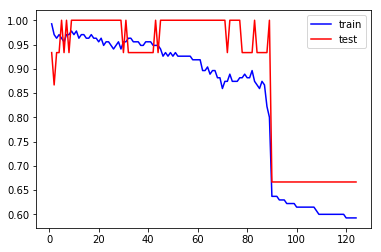

In [220]:
# Построение графика
from sklearn.metrics import accuracy_score

neighbor = range(1, 125)
errors_train = []
errors_test = []
X_train, X_test, y_train, y_test = train_test_split(iris.data, iris.target, test_size=0.1, stratify=iris.target)
for k in neighbor:
    my_clf = MyKNeighborsClassifier(n_neighbors=k)
    my_clf.fit(X_train, y_train)
    predict_test = my_clf.predict(X_test)
    predict_train = my_clf.predict(X_train)
    errors_train.append(accuracy_score(predict_train, y_train))
    errors_test.append(accuracy_score(predict_test, y_test))

plt.plot(neighbor, errors_train, color='blue', label='train')
plt.plot(neighbor, errors_test, color='red', label='test')
plt.legend()

In [221]:
# нахождение наилучшего k
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler

param_grid = {
    "mykneighborsclassifier__n_neighbors": range(1, 125)
}

reg = make_pipeline(
    StandardScaler(),
    MyKNeighborsClassifier()
)
gr_search = GridSearchCV(reg, param_grid,cv=5, scoring='neg_mean_squared_error')
gr_search.fit(iris.data, iris.target)
print(gr_search.best_estimator_)

Old_neighbors = 
 [[ 7]
 [15]
 [37]
 [37]
 [30]
 [ 6]
 [ 1]
 [29]
 [28]
 [24]
 [45]
 [45]
 [45]
 [49]
 [43]
 [47]
 [45]
 [40]
 [45]
 [44]
 [45]
 [43]
 [45]
 [43]
 [43]
 [45]
 [49]
 [45]
 [48]
 [45]]
old_neighbors_ind = 
 [[ 7 75]
 [15 78]
 [37 78]
 [37 78]
 [30 68]
 [ 6 65]
 [ 1 78]
 [29 68]
 [28 78]
 [24 78]
 [45 66]
 [45 66]
 [45 66]
 [49 60]
 [43 54]
 [47 79]
 [45 65]
 [40 73]
 [45 55]
 [44 74]
 [45 85]
 [43 91]
 [45 82]
 [43 86]
 [43 82]
 [45 92]
 [49 69]
 [45 99]
 [48 81]
 [45 87]]
old_neighbors_ind = 
 [[  7  75 108]
 [ 15  78 108]
 [ 37  78 108]
 [ 37  78 108]
 [ 30  68 108]
 [  6  65 108]
 [  1  78 108]
 [ 29  68 108]
 [ 28  78 108]
 [ 24  78 108]
 [ 45  66 109]
 [ 45  66 107]
 [ 45  66 107]
 [ 49  60 104]
 [ 43  54 103]
 [ 47  79 103]
 [ 45  65 107]
 [ 40  73 112]
 [ 45  55 103]
 [ 44  74 112]
 [ 45  85 106]
 [ 43  91 112]
 [ 45  82 109]
 [ 43  86 107]
 [ 43  82 117]
 [ 45  92 105]
 [ 49  69 112]
 [ 45  99 100]
 [ 48  81 116]
 [ 45  87 114]]
neighbors[i]
 [7]
neighbors[i]
 [15

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher

[ 5 23]
neighbors[i]
 [9 8]
neighbors[i]
 [ 7 30]
neighbors[i]
 [8 0]
neighbors[i]
 [36 68]
neighbors[i]
 [10 21]
neighbors[i]
 [11  9]
neighbors[i]
 [12 30]
neighbors[i]
 [16 39]
neighbors[i]
 [ 1 16]
neighbors[i]
 [15 24]
neighbors[i]
 [16 13]
neighbors[i]
 [17  7]
neighbors[i]
 [29 17]
neighbors[i]
 [37 20]
neighbors[i]
 [20 24]
neighbors[i]
 [21 10]
neighbors[i]
 [23  6]
neighbors[i]
 [23 22]
neighbors[i]
 [24 27]
neighbors[i]
 [25 39]
neighbors[i]
 [10 21]
neighbors[i]
 [24 27]
neighbors[i]
 [ 3 32]
neighbors[i]
 [29 18]
neighbors[i]
 [ 7 17]
neighbors[i]
 [31 28]
neighbors[i]
 [37 19]
neighbors[i]
 [33 16]
neighbors[i]
 [34  9]
neighbors[i]
 [35  2]
neighbors[i]
 [36  9]
neighbors[i]
 [19 32]
neighbors[i]
 [ 0 36]
neighbors[i]
 [39 25]
neighbors[i]
 [40 73]
neighbors[i]
 [41 58]
neighbors[i]
 [67 48]
neighbors[i]
 [43 58]
neighbors[i]
 [44 68]
neighbors[i]
 [45 66]
neighbors[i]
 [46 64]
neighbors[i]
 [47 62]
neighbors[i]
 [48 67]
neighbors[i]
 [60 69]
neighbors[i]
 [ 50 108]
neig

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [29 39 18]
neighbors[i]
 [28  3  2]
neighbors[i]
 [24 27 20]
neighbors[i]
 [66 45 55]
neighbors[i]
 [66 45 55]
neighbors[i]
 [66 45 57]
neighbors[i]
 [60 69 61]
neighbors[i]
 [103  54  56]
neighbors[i]
 [79 76 74]
neighbors[i]
 [65 50 80]
neighbors[i]
 [73 78 61]
neighbors[i]
 [55 54 56]
neighbors[i]
 [74 70 69]
neighbors[i]
 [106 118 114]
neighbors[i]
 [112  91  63]
neighbors[i]
 [ 82 109  90]
neighbors[i]
 [ 86 107  98]
neighbors[i]
 [117  82 110]
neighbors[i]
 [105  92 100]
neighbors[i]
 [69 70 83]
neighbors[i]
 [100  99  92]
neighbors[i]
 [ 81 116  52]
neighbors[i]
 [ 87 114  90]
Old_neighbors = 
 [[38 36  9]
 [ 1 14 39]
 [ 2 24 27]
 [ 3 28 32]
 [ 4  8 23]
 [ 5 23  4]
 [ 9  8  0]
 [ 7 30 17]
 [ 8  0  6]
 [ 9 36 11]
 [10 21 18]
 [11  9 34]
 [12 30  1]
 [16 39 29]
 [ 1 16 29]
 [15 24 27]
 [16 13 29]
 [17  7 18]
 [29 17  7]
 [37 20 24]
 [20 24 27]
 [21 10 18]
 [23  6 36]
 [23 22  5]
 [24 27 20]
 [25 39 24]
 [10 21 17]
 [24 27 20]
 [ 3 32 37]
 [29 18 17]
 [ 7 17 29]
 [31 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()



neighbors[i]
 [ 7 17 30 29]
neighbors[i]
 [15  2 35 24]
neighbors[i]
 [37 19 20 32]
neighbors[i]
 [37 20 19 28]
neighbors[i]
 [30  7 17 11]
neighbors[i]
 [ 6 34  8  9]
neighbors[i]
 [ 1 14 37 19]
neighbors[i]
 [29 39 18  1]
neighbors[i]
 [28  3 35  2]
neighbors[i]
 [24 27 20  2]
neighbors[i]
 [66 45 55 57]
neighbors[i]
 [66 45 55 71]
neighbors[i]
 [66 45 57 55]
neighbors[i]
 [60 69 61 49]
neighbors[i]
 [103  54  56  55]
neighbors[i]
 [79 76 74 62]
neighbors[i]
 [65 50 80 66]
neighbors[i]
 [73 78 61 60]
neighbors[i]
 [55 54 56 45]
neighbors[i]
 [74 70 69 79]
neighbors[i]
 [106 118 114  85]
neighbors[i]
 [112  91  63  83]
neighbors[i]
 [ 82 109  90  95]
neighbors[i]
 [ 86 107  98 117]
neighbors[i]
 [117  82 110 115]
neighbors[i]
 [105  92 100  95]
neighbors[i]
 [69 70 83 74]
neighbors[i]
 [100  99  92  95]
neighbors[i]
 [ 81 116  52  93]
neighbors[i]
 [ 87 114  90 113]
Old_neighbors = 
 [[38 36  9 11]
 [ 1 14 39 16]
 [ 2 24 27 35]
 [ 3 28 32 37]
 [ 4  8 23  6]
 [ 5 23  4 22]
 [ 9  8  0 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


[66 48 44 65]
neighbors[i]
 [67 76 96 42]
neighbors[i]
 [53 51 61 63]
neighbors[i]
 [69 59 57 72]
neighbors[i]
 [70 71 59 79]
neighbors[i]
 [70 59 79 43]
neighbors[i]
 [72 57 69 45]
neighbors[i]
 [ 73 113 106 103]
neighbors[i]
 [74 56 78 51]
neighbors[i]
 [75 46 60 41]
neighbors[i]
 [76 55 42 65]
neighbors[i]
 [77 58 62 99]
neighbors[i]
 [78 56 54 74]
neighbors[i]
 [59 70 43 71]
neighbors[i]
 [ 80 116  95 104]
neighbors[i]
 [ 81 101  73  93]
neighbors[i]
 [ 82  92 119  87]
neighbors[i]
 [ 83  96 117 108]
neighbors[i]
 [ 92 112 108  96]
neighbors[i]
 [ 85 115 102  87]
neighbors[i]
 [49 79 43 93]
neighbors[i]
 [ 87 110 109  82]
neighbors[i]
 [ 91  62 103 108]
neighbors[i]
 [ 97 100 104 111]
neighbors[i]
 [ 90  95 117 104]
neighbors[i]
 [103 108 106 112]
neighbors[i]
 [119  84  82  96]
neighbors[i]
 [ 93  81 101  73]
neighbors[i]
 [ 94 101  81 112]
neighbors[i]
 [ 90 116  80 104]
neighbors[i]
 [ 96 117  83  67]
neighbors[i]
 [ 97 111  89 105]
neighbors[i]
 [ 98 102 110  85]
neighbors[i]
 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()



neighbors[i]
 [35  9 37 34  2]
neighbors[i]
 [36 20 27 31 28]
neighbors[i]
 [ 9 37 34 30 12]
neighbors[i]
 [38 13  8  3 12]
neighbors[i]
 [ 7 28  0 27 17]
neighbors[i]
 [40 42 76 55 65]
neighbors[i]
 [41 46 76 55 65]
neighbors[i]
 [42 76 40 55 67]
neighbors[i]
 [43 70 79 71 59]
neighbors[i]
 [ 44 113  48  66  64]
neighbors[i]
 [45 72 68 63 78]
neighbors[i]
 [46 41 75 60 90]
neighbors[i]
 [47 71 70 50 79]
neighbors[i]
 [48 65 64 44 66]
neighbors[i]
 [79 54 45 72 59]
neighbors[i]
 [50 47 43 71 70]
neighbors[i]
 [ 68  56  78  53 118]
neighbors[i]
 [52 77 43 58 71]
neighbors[i]
 [ 53  68  63 113  64]
neighbors[i]
 [54 78 72 45 51]
neighbors[i]
 [55 76 65 42 41]
neighbors[i]
 [74 78 51 68 45]
neighbors[i]
 [57 72 69 45 59]
neighbors[i]
 [58 99 77 62 52]
neighbors[i]
 [59 70 79 71 69]
neighbors[i]
 [ 60 118 107  75  46]
neighbors[i]
 [61 63 72 64 68]
neighbors[i]
 [ 62 114  77  73 103]
neighbors[i]
 [53 61 68 64 45]
neighbors[i]
 [48 65 44 53 61]
neighbors[i]
 [55 48 76 64 44]
neighbors[i]


/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [30 29  2 38 12 37]
neighbors[i]
 [ 4  0 17 27 21  7]
neighbors[i]
 [ 5 16 18 19 10 21]
neighbors[i]
 [11 24  2  7 29 26]
neighbors[i]
 [ 7 39 11 28  0 26]
neighbors[i]
 [ 8 38 13  3 12  1]
neighbors[i]
 [ 9 37 34 30 12  1]
neighbors[i]
 [10 19 21 18 36 27]
neighbors[i]
 [11 24  7  6 26 39]
neighbors[i]
 [12  1 34  9 37 30]
neighbors[i]
 [13 38  8  3 12  2]
neighbors[i]
 [14 18 33 16  5 32]
neighbors[i]
 [15 33 14 32  5 16]
neighbors[i]
 [ 5 19 18 10 21 14]
neighbors[i]
 [17  0 27 39 28  4]
neighbors[i]
 [18  5 10 16 14 19]
neighbors[i]
 [19 21 10 16  5  4]
neighbors[i]
 [20 31 28 36 27 39]
neighbors[i]
 [21 19  4 10 17  0]
neighbors[i]
 [22  6  4 11  0 17]
neighbors[i]
 [26 31 39  7 28 35]
neighbors[i]
 [11  7  6 26 39 29]
neighbors[i]
 [25  1 34  9 37 12]
neighbors[i]
 [26  7 23 39 17 11]
neighbors[i]
 [ 0 17 28 39  7 54]
neighbors[i]
 [28 39 27  7  0 17]
neighbors[i]
 [29  2 30  3 37 34]
neighbors[i]
 [30 37 34  9  3 29]
neighbors[i]
 [31 20 28 36 27 39]
neighbors[i]
 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()



old_neighbors_ind = 
 [[ 17   0   4   7  27  39  26  54  78  69  74  57  56  51 118 107 113 101
  106 117 103]
 [  8  47  38  13  12   1  25  50  71  70  69  59  79  52 114 101 113 106
  103 118 107]
 [  3   2  29  38  13   6  30  54  78  69  57  74  72  71 118 101 107 113
  106 114 103]
 [ 26  17  23  21   0   7  27  54  78  74  75  56  51  69 118 107 101 113
  106 117 103]
 [ 19  21   5  16  10   4  18  78  75  54  74  56  51  60 118 107 117 113
  101 106 116]
 [  1  12  30  25   3   9  37  69  54  78  57  71  72  59 118 101 107 113
  106 114 103]
 [ 19  21  10   4   5  16   0  78  54  75  74  56  51  57 118 107 113 117
  106 101 103]
 [  2  29   3  30  37  34   9  54  78  69  57  72  74  71 118 107 101 113
  106 114 103]
 [ 10  19  21   4  27   0  36  78  54  75  51  74  56  57 118 107 113 117
  106 101 103]
 [  7  35  39  28  11  26   2  54  78  69  57  72  74  56 118 107 113 101
  106 114 103]
 [ 45  49  43  47  44  48  41  79  59  72  57  70  69  71 114 113 101 106
  103 118 107

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()



neighbors[i]
 [ 0 30 27  4 28  7 26 33]
neighbors[i]
 [ 5 10 16 38 14 19 36 75]
neighbors[i]
 [36 34 21 38 10 16  5 75]
neighbors[i]
 [20 28 27  0 17  7 26 39]
neighbors[i]
 [21 19 34 36 38  4 10 17]
neighbors[i]
 [ 6  4 30 11  0 17  7 54]
neighbors[i]
 [23 26 39  7 33 28 17 20]
neighbors[i]
 [24 11  7 26  6 39 30 29]
neighbors[i]
 [ 1 35 12  9  3 29  2 78]
neighbors[i]
 [26  7 23 17 30 33 11 39]
neighbors[i]
 [27  0 17 28 30  7  4 20]
neighbors[i]
 [28 27  7  0 17 20 39 30]
neighbors[i]
 [29 37  2  3  9 32 39 11]
neighbors[i]
 [17  0  4  7 27 26 28 54]
neighbors[i]
 [31  8 47 73 78 35 13 12]
neighbors[i]
 [32 37  3  2 29 13  6  9]
neighbors[i]
 [33 26 17 30 23  0 21  7]
neighbors[i]
 [19 36 21  5 38 16 10 75]
neighbors[i]
 [ 1 12 25  3  9  2 29 37]
neighbors[i]
 [36 19 34 38 21 10  4  5]
neighbors[i]
 [37  2 29  3 32  9  6 11]
neighbors[i]
 [38 10 36 21 19  4 27 34]
neighbors[i]
 [39  7 28 11 26  2 24 23]
neighbors[i]
 [ 40  42  55  65  67  41 109  48]
neighbors[i]
 [41 46 55 65 71 4

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()



neighbors[i]
 [ 65  46  41  51  71 108  90 119  56]
neighbors[i]
 [ 66  55  42  41  40  48  46  96 107]
neighbors[i]
 [ 58  99  52  72 116 104  43  59  60]
neighbors[i]
 [68 75 76 56 54 64 51 79 45]
neighbors[i]
 [69 59 70 60 43 72 74 61 49]
neighbors[i]
 [70 74 69 59 72 62 45 57 79]
neighbors[i]
 [ 71  53  77  51 108  41 103  76  75]
neighbors[i]
 [72 62 57 59 74 70 69 79 45]
neighbors[i]
 [73 47 78 50 61 60 43 59 69]
neighbors[i]
 [74 79 45 70 62 72 76 57 69]
neighbors[i]
 [75 68 76 54 56 51 79 45 64]
neighbors[i]
 [76 79 75 68 45 54 56 51 74]
neighbors[i]
 [ 77  53  71  51  48  44 103  76  79]
neighbors[i]
 [78 47 73 61 60 49 69 59 43]
neighbors[i]
 [79 76 45 74 62 54 68 75 57]
neighbors[i]
 [106 118 114  95 113 110  84  90 115]
neighbors[i]
 [112  81  63  93 119  94 108  91 116]
neighbors[i]
 [ 82  92 109  87 111 113 100 115 110]
neighbors[i]
 [ 83  96 107 117  91 103 102 119 108]
neighbors[i]
 [ 92 117 110 115 102  96  95 113 109]
neighbors[i]
 [ 85 105  87 100  82  98 109  92 11

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()



neighbors[i]
 [118 106  80  94 114 113  50  90 110  46]
neighbors[i]
 [119 108  97  50  58  83  71  96 107  91]
Old_neighbors = 
 [[21 26 29  0 17  7 39 30 10  4]
 [19 34 36 38  4 10 17 30  0 33]
 [ 6  4 30 11  0 17  7 29 19 33]
 [39 21 29 33  7 17 25 30 11  0]
 [11  7  6 29 39 30  0 17  2  4]
 [ 1 24 27  9 35 12 20 25  3  2]
 [ 7 29 17 30 33 11 39  0 21  6]
 [ 0 17 29 30  7  4 26 21 38 10]
 [29  7  0 17 39 30 21 26 11  4]
 [37  2 20  3 27  9 24 32 25 39]
 [46 41 45 44 48 42 40 49 43 47]
 [45 44 48 41 49 46 42 43 40 47]
 [44 48 45 43 42 49 41 46 40 47]
 [45 44 48 41 49 46 42 43 40 47]
 [48 44 41 42 45 46 40 49 43 47]
 [48 44 41 42 40 46 45 49 43 47]
 [48 44 42 40 41 46 45 43 49 47]
 [42 44 48 41 40 46 45 49 43 47]
 [45 44 48 41 46 49 42 40 43 47]
 [45 43 49 47 44 48 41 46 35  1]
 [42 40 46 41 44 48 45 49 43 47]
 [45 49 44 41 46 43 48 42 47 40]
 [42 40 44 48 41 46 45 43 49 47]
 [44 48 45 41 42 46 40 49 43 47]
 [46 42 41 40 48 44 45 49 43 47]
 [42 40 41 46 48 44 45 49 43 47]
 [44 48 45 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


Old_neighbors = 
 [[ 0 17 30 ... 10 26 21]
 [ 1 15 35 ... 25  2 19]
 [ 2 37 19 ...  9 27 39]
 ...
 [42 44 41 ... 43 47 13]
 [46 41 42 ... 43 33 13]
 [45 41 46 ... 43 47 13]]
old_neighbors_ind = 
 [[ 0 17 30 ... 71 77 51]
 [ 1 15 35 ... 61 74 72]
 [ 2 37 19 ... 74 73 70]
 ...
 [42 44 41 ... 90 94 93]
 [46 41 42 ... 57 83 66]
 [45 41 46 ... 81 63 76]]
old_neighbors_ind = 
 [[  0  17  30 ... 106 109 115]
 [  1  15  35 ... 102 118 115]
 [  2  37  19 ... 118 102 106]
 ...
 [ 42  44  41 ... 119 113 103]
 [ 46  41  42 ... 117 115 119]
 [ 45  41  46 ... 104 109 110]]
neighbors[i]
 [ 0 17 30 29 18  4  7 16 10 26 21]
neighbors[i]
 [15 35 24 27  9 20  3 25  2 19 78]
neighbors[i]
 [ 2 37 19  3 20 32 25 24  9 27 39]
neighbors[i]
 [20 37 19  2 28 32 24  9 27 35  1]
neighbors[i]
 [ 4  0 30 17 11 38  7 12 29 36 18]
neighbors[i]
 [ 5 34 36 38 11 22 23  4 26 17  0]
neighbors[i]
 [ 6 14  7 16 37 30  2 39 19 12 32]
neighbors[i]
 [29 18 39 16  0 30 14 17 10  6 13]
neighbors[i]
 [28 35  3  1 20 15 32 24  9 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


Old_neighbors = 
 [[ 7 17 30 29 18 16  1 39 10 26 21 38]
 [15  2 35 24 27 20 25 19 37 28 39 32]
 [37 19 20 32 24 27 25 39  2 35  1 14]
 [37 20 19 28 32  2 35 27 24  3 15 25]
 [30  7 17 11 38 29 36  9 18  1 16 12]
 [ 6 34  8  9 36  0 38 11 22  4 23 26]
 [ 1 14 37 19 12 32 16 30 39 29  7 33]
 [29 39 18  1 16 30  7 17 14 25 13 10]
 [28  3  2 35 32 20 37 19 24 27 15 25]
 [24 27 20  2 15 25 19 35 37 39 32 28]
 [45 43 41 46 47 44 49 48 42 21  8 10]
 [45 43 41 46 44 47 49 48 42 21 13 10]
 [45 43 41 46 47 44 48 49 42 21 10 13]
 [49 42 48 40 47 44 43 46 41 45 31 15]
 [43 45 41 47 46 44 48 49 42 40 13 21]
 [47 46 44 43 41 49 45 42 48 40 13 15]
 [45 41 43 46 44 47 49 48 42 21 13 10]
 [40 49 47 44 42 31 46 48 35 15 41  2]
 [45 43 41 47 46 44 49 48 42 21 13 10]
 [44 49 46 47 41 43 42 40 48 45 15 13]
 [45 41 43 46 44 47 48 49 42 13 33 21]
 [43 46 41 44 47 49 48 45 42 40 13 15]
 [45 43 41 46 48 47 44 49 42 40 21 13]
 [43 41 45 46 47 44 48 49 42 40 13 21]
 [43 45 41 46 44 47 48 49 42 40 13 21]
 [45 43

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


 [ 8 38 13  3 12  1 30 25 34 37  9  2]
neighbors[i]
 [ 9 37 34 30 12  1 25 35 29  2  3 38]
neighbors[i]
 [10 19 21 18 36 27  4  5 16  0 17 20]
neighbors[i]
 [11 24  7  6 26 39  0 17 29 28  2  4]
neighbors[i]
 [12  1 34  9 37 30 25  3  2 38 29 35]
neighbors[i]
 [13 38  8  3 12  2 30 29  1  9 37 34]
neighbors[i]
 [14 18 33 16  5 32 10 15 19 21 36  4]
neighbors[i]
 [15 33 14 32  5 16 18 19 10 21  4 36]
neighbors[i]
 [ 5 19 18 10 21 14 32 33  4 36 27 17]
neighbors[i]
 [17  0 27 39 28  4  7 26 31 11 20 21]
neighbors[i]
 [18  5 10 16 14 19 36 21 27 32 33  4]
neighbors[i]
 [19 21 10 16  5  4 17  0 27 18 32 22]
neighbors[i]
 [20 31 28 36 27 39  0 17  7 26 23  4]
neighbors[i]
 [21 19  4 10 17  0 27  5 16 26 36 39]
neighbors[i]
 [22  6  4 11  0 17  7 24 21 26 39 27]
neighbors[i]
 [26 31 39  7 28 35 17 20 11 24 27  0]
neighbors[i]
 [11  7  6 26 39 29  0 17 28 27  2  4]
neighbors[i]
 [25  1 34  9 37 12 30 35  3 29  2 38]
neighbors[i]
 [26  7 23 39 17 11 28  0 24 27 31  6]
neighbors[i]
 [ 0 17 28 3

 [ 92  87 100 111 105 113 109 115 110  85  84 117  96]
neighbors[i]
 [ 83  96 108 117 107 106  91 119 103  84  67  92  44]
neighbors[i]
 [ 84  92 117 115 110 108  96  95 113  83  90 111 100]
neighbors[i]
 [ 85 102  87  82 105 109  98 100  92 113 111 110 115]
neighbors[i]
 [ 86  49  70  43  93  74  47  78 101  59  73 112  81]
neighbors[i]
 [ 87 109  82  85 102 105  92  67  96  42 100  98 113]
neighbors[i]
 [ 88  91 116  62 103 108  66  83  44 106  96  87  92]
neighbors[i]
 [ 97 114 100 104 113  80 105 110 111 118  95  82  90]
neighbors[i]
 [ 90  95 117 104  96  92 115  67  46 111  84 110 113]
neighbors[i]
 [ 91 103 108 106 116  83  88  44 117  96 112  81  62]
neighbors[i]
 [ 92 115 117  84  82 111 110  96 100 113  67  90 108]
neighbors[i]
 [ 93 112  81 101 116  94 103 106  62  91  99  86  74]
neighbors[i]
 [101 112  81 108  93 119 106 107  91 103  83  84 117]
neighbors[i]
 [ 95  90 110 118  80 114 104  84 113 115 117 100 111]
neighbors[i]
 [ 96 117  83  67  92  84  90 107 108 106 115  9

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [52 67 58 43 61 60 59 99 72 69 70 57 62 74]
neighbors[i]
 [ 53  71  77 103  51  44  45  63  76 108  48  79 119  75]
neighbors[i]
 [68 76 79 75 62 74 45 51 56 64 49 57 72 70]
neighbors[i]
 [ 55  66  42  41  40  48  44  46  77  71  53  96 107 103]
neighbors[i]
 [ 56  64  68  76  51  75  45  79  54  71 119 108  53  74]
neighbors[i]
 [62 72 74 79 45 70 59 76 69 54 75 77 60 61]
neighbors[i]
 [ 58  67  99  52 116  43 104  72  69  93  60  59  63  88]
neighbors[i]
 [60 69 61 72 70 62 43 57 74 79 49 45 78 52]
neighbors[i]
 [60 61 59 43 69 70 72 78 73 74 62 52 57 47]
neighbors[i]
 [61 60 59 43 69 70 72 78 73 47 52 57 62 74]
neighbors[i]
 [72 57 79 74 45 76 70 59 54 69 75 77 68 60]
neighbors[i]
 [ 63 103 104 112  81  53  91  45  83 116 119  44 108  71]
neighbors[i]
 [ 64  56  68  76  75  45  51  54  79  74  49 119 108  71]
neighbors[i]
 [ 65  46  41  51  71 108  90 119  56 107 118  66  75  68]
neighbors[i]
 [ 66  55  42  41  40  48  46  96 107  44  90  71 117  77]
neighbors[i]
 [ 58

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()



neighbors[i]
 [38 11 36  4 34 17  0 26  5 30 18 10 29 33 21]
neighbors[i]
 [ 7 25 29 18 16  2 13 14 19  0 30 37 27 24 75]
neighbors[i]
 [ 40  42  66  55  41  57  99  46  48  95 107 109  56  54 117]
neighbors[i]
 [ 46  66  55  71  42  65  50  40 107  57  97 108  54  48  77]
neighbors[i]
 [ 42  66  40  57  55  41  99  48 107  56 109  95 117  46  54]
neighbors[i]
 [43 60 61 69 73 70 72 47 78 59 67 74 86 49 62]
neighbors[i]
 [ 44 103  48  56  54  77  96  93  55  53  51  58  57  71  63]
neighbors[i]
 [45 79 76 74 62 53 58 51 75 68 70 72 77 63 64]
neighbors[i]
 [ 41  65  50  66 107  71  97  42 108  40  55  57 119  94 117]
neighbors[i]
 [73 78 61 60 43 69 49 59 70 86 72 74 62 79 31]
neighbors[i]
 [ 48  54  55  44  56  77 103  66  57  71  53  42  51  58  96]
neighbors[i]
 [49 74 70 69 79 45 62 72 86 76 78 59 64 68 60]
neighbors[i]
 [ 50 108 119  97  46  65  41 107  71  64  58 117 118  68  83]
neighbors[i]
 [ 51  77  53  62  54  79  58  76  45  71  44  72  74 103  75]
neighbors[i]
 [ 52 116 10

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


 [61 49 69 59 70 72 78 73 74 62 42 47 79 40 67 44]
neighbors[i]
 [60 49 69 59 70 72 78 73 42 47 62 74 79 40 67 44]
neighbors[i]
 [62 72 47 79 74 59 51 76 70 49 44 69 53 75 77 58]
neighbors[i]
 [103  96 104 112  93  58  43  52  53  81 116 119  97 108  91  71]
neighbors[i]
 [ 46  68  76  75  41  44  79  74  58 119  91 108  50  71  43  70]
neighbors[i]
 [ 50  41  71 108  97  80 119  46 107 118  75  66  68  58  45  43]
neighbors[i]
 [ 66  45  55  57  54  86  56 107  80 117  71  77 103  43  97 109]
neighbors[i]
 [ 67  48  52  89  42  72 116 104  49  60  63  69  62  93  53  51]
neighbors[i]
 [68 75 76 46 44 64 79 41 58 74 71 62 43 51 77 47]
neighbors[i]
 [69 49 70 60 72 74 61 59 62 47 79 78 44 76 73 42]
neighbors[i]
 [70 74 69 49 72 62 47 79 60 59 61 76 44 53 51 68]
neighbors[i]
 [ 71  43  58  77  41  54  53 108  97  51 103  76  75  55  46 119]
neighbors[i]
 [72 62 47 49 74 59 70 69 79 51 60 61 76 53 44 77]
neighbors[i]
 [78 40 61 60 49 69 59 70 72 74 42 62 47 79 44 31]
neighbors[i]
 [74 79 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


 [79 54 45 72 59 86 74 78 69 70 57 56 71 43 47 51]
neighbors[i]
 [50 47 43 71 70 52 59 79 86 69 99 49 58 77 57 72]
neighbors[i]
 [ 68  56  78  53 118  61  45  54 107  74  64  60  63  41 106  72]
neighbors[i]
 [ 52  77  43  58  71  70  59  99  79  69  62  57  72  50 114  61]
neighbors[i]
 [ 53  68  63 113  64  51  61  44  45  73 107 118 106  48  65  56]
neighbors[i]
 [54 78 72 45 51 56 74 61 49 57 68 69 53 63 79 59]
neighbors[i]
 [ 55  76  65  42  41  40  48  67  64  66  46  44  53  96 117 113]
neighbors[i]
 [ 74  78  51  68  45  54 118  53  60 107 101  61  63  72  49  73]
neighbors[i]
 [57 72 69 45 59 61 63 79 54 70 71 78 53 68 49 64]
neighbors[i]
 [ 58  99  77  62  52  43 114  79  70  93  59  73  88 103  71  72]
neighbors[i]
 [59 70 79 71 69 72 57 43 49 45 52 47 61 54 63 77]
neighbors[i]
 [ 60 118 107  75  46  51  56  41 117  90  68  74  53  96  95  83]
neighbors[i]
 [ 61  63  72  64  68  53  45  57  51  44  54 113  48  78  73  65]
neighbors[i]
 [ 62 114  77  73 103 113  58  44  91  9

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [17 30 29  4  7 11 39 26 21 38 33 10  6 36 19 25 34]
neighbors[i]
 [ 1 35 12 27  9 24 20  3 25  2 37 28  8 39 32 13  7]
neighbors[i]
 [ 2 37  3 20 32 25 27  9 24 39  6 35 12 11  1 28  7]
neighbors[i]
 [ 3 37 20  2 32 28 35 12  9 27 24  1 13  8 25 39  6]
neighbors[i]
 [ 0 30 17 38  7 29 36 19 11 10 33 34 26 39  6 21 16]
neighbors[i]
 [ 5 16 34 18 19 36 10 38 22 14 23  4 26 17  0 30 33]
neighbors[i]
 [ 6 11 37  2  7 32 30 39 29 17  0  4 33  3 25 20 27]
neighbors[i]
 [ 7 29 39 11  0 30 17  4 25  6 21 33  2 26 37 27 24]
neighbors[i]
 [ 8 28 13  3 35 12  1 32 20 37  2  9 24 27 25  6 39]
neighbors[i]
 [20 12  1 25 35  2  3 37 39 28 32  7 11 29 78 54 68]
neighbors[i]
 [10 38 36 19 18 26 16  5  4 34  0 17 30 21 29  7 14]
neighbors[i]
 [11  7  6 39 29 30  0 17  2 37  4 25 33 20 32 27 24]
neighbors[i]
 [12  1 24 27  9 35 20  3  2 28 37 25  8 13 32 39 11]
neighbors[i]
 [13 28  8 32  3 37 12  2 35 20  1 24  9 27 25  6 39]
neighbors[i]
 [18 23 16  5 22 10 38 15 19 36 34 26  4  0 17 21

neighbors[i]
 [ 67  52  43 116 104  69  60  61  72  88  70  63  93  81 112  74  62  59]
Old_neighbors = 
 [[ 0 17 30 ... 11  6 13]
 [ 1 15 35 ... 32 13  7]
 [ 2 37 19 ... 14  7 15]
 ...
 [42 44 41 ... 15 26 18]
 [46 41 42 ...  5 11 47]
 [45 41 46 ... 10 35 20]]
old_neighbors_ind = 
 [[ 0 17 30 ... 50 53 72]
 [ 1 15 35 ... 51 77 53]
 [ 2 37 19 ... 69 77 71]
 ...
 [42 44 41 ... 56 99 54]
 [46 41 42 ... 96 55 58]
 [45 41 46 ... 57 75 84]]
old_neighbors_ind = 
 [[  0  17  30 ... 113 114 100]
 [  1  15  35 ... 113 114 100]
 [  2  37  19 ... 113 114 100]
 ...
 [ 42  44  41 ... 100 116 104]
 [ 46  41  42 ... 105 100 101]
 [ 45  41  46 ... 113 114 100]]
neighbors[i]
 [ 0 17 30 29 18  4  7 16 10 26 21 14 39 33 38 11  6 13]
neighbors[i]
 [15 35 24 27  9 20  3 25  2 19 28 37  8 39 32 13  7 78]
neighbors[i]
 [ 2 37 19  3 20 32 25 24  9 27 39  6 35  1 28 14  7 15]
neighbors[i]
 [20 37 19  2 28 32 24  9 27 35  1 15 25  8 39  6 14 13]
neighbors[i]
 [ 4  0 30 17 11 38  7 12 29 36 18 16 33 14 26 34  6 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


old_neighbors_ind = 
 [[ 7 17 30 ... 58 54 53]
 [15  2 35 ... 77 53 58]
 [37 19 20 ... 77 71 58]
 ...
 [45 43 41 ... 85 96 97]
 [48 43 45 ... 54 55 58]
 [45 43 41 ... 55 88 81]]
old_neighbors_ind = 
 [[  7  17  30 ... 114 100 101]
 [ 15   2  35 ... 114 100 105]
 [ 37  19  20 ... 114 100 105]
 ...
 [ 45  43  41 ... 119 118 112]
 [ 48  43  45 ... 114 118 106]
 [ 45  43  41 ... 103 112 116]]
neighbors[i]
 [ 7 17 30 29 18 16  1 39 10 26 21 38 11 14 33  0 13 36  9]
neighbors[i]
 [15  2 35 24 27 20 25 19 37 28 39 32  3 13  1 29 14 16 18]
neighbors[i]
 [37 19 20 32 24 27 25 39  2 35  1 14 28 15 16 29  3 13 18]
neighbors[i]
 [37 20 19 28 32  2 35 27 24  3 15 25 39  1 14 13 16 29 18]
neighbors[i]
 [30  7 17 11 38 29 36  9 18  1 16 12  0 33 14 34 39 26 10]
neighbors[i]
 [ 6 34  8  9 36  0 38 11 22  4 23 26 17  7 30 33 21 10  5]
neighbors[i]
 [ 1 14 37 19 12 32 16 30 39 29  7 33 25 20 13 18 17 27 24]
neighbors[i]
 [29 39 18  1 16 30  7 17 14 25 13 10 21 33 19 37 26 24 27]
neighbors[i]
 [28  3 35 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [59 70 43 71 69 49 72 57 45 86 47 54 61 52 73 63 77 99 62]
neighbors[i]
 [ 80 116  95 104 100  84  90 119 117  92  96 112  60  89 108  82  83 107
 118]
neighbors[i]
 [ 81 101  73  93 106 103  94  91 118 107  83  68 113 114 108 112  45  53
  62]
neighbors[i]
 [ 82  92 119  87 100 105 110 109  85  84 115 104  96  67 108 102  90 112
 117]
neighbors[i]
 [ 83  96 117 108 107 106  91 113 112 103 118  84  67  73  92  44  53  81
  68]
neighbors[i]
 [ 92 112 108  96  95 119 117  83  90 100  82 104  80  67  91 107 106 118
 116]
neighbors[i]
 [ 85 115 102  87 110  82 105 109  98 119 100  92 104  84  67  96  42  89
 108]
neighbors[i]
 [ 49  79  43  93  70 101  47  59  81  71  45  74  72  73  56  54  69  57
  78]
neighbors[i]
 [ 87 110 109  82  85 102 105 115  92 119  67  96  42 100  98  84  66  88
 108]
neighbors[i]
 [ 91  62 103 108 114 112 113  83  66  73 106  44 110  96  87  77  92  58
  67]
neighbors[i]
 [ 97 100 104 111 116  80 105 119  95  82  90 115  85  92  84 117 109  87
  9

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [108  91  84  83 117 115  92 103  96 106  94 110 116 107 112  81  67  88
  95 119]
neighbors[i]
 [ 44  53 106 103  63  83  68  48  77  64  91  71  66 107  96  62  61  67
  65 119]
neighbors[i]
 [ 62 103  63  91 116 112  81 106  53  44  83  45  88  68  99  93  72  61
  70  77]
neighbors[i]
 [ 85 102  82  87 105  98 100 109 111  92 113 110 115 104 114  84  89  67
 117  42]
neighbors[i]
 [118  80  95 114 104 113  90 110 100  84 111 115 117  60  92  46  89  96
 107 119]
neighbors[i]
 [ 96 117  90  83  67 107  84  92 119  95  46 104  41  60  42 115 108 106
  71 110]
neighbors[i]
 [107 119  60  68 106  51  71  53  83  56 117 101  96  81 112  77 103  41
  90  46]
neighbors[i]
 [ 92 111 100  82 115 113 110 104 117  90  84  67  96 105  95 114 109  42
  87 108]
Old_neighbors = 
 [[ 0 17 27 ...  6 22 36]
 [ 1 25 35 ... 26 28  6]
 [ 2 37 29 ... 23 28  8]
 ...
 [42 44 41 ... 27 17 35]
 [46 41 42 ... 21 17 10]
 [45 46 41 ... 24 28 39]]
old_neighbors_ind = 
 [[ 0 17 27 ... 70 63 53]
 [ 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 80 106 114 118 113  94 110  90  84 111 115 109 107 117  50  89  82  97
 102 119  46]
neighbors[i]
 [ 81 112  91  63  96  93 116 119 103 104 108  58  83  98  97 102  45  52
  74  79  53]
neighbors[i]
 [ 82 109  87 111  90  95  99 115 113 110 100  85  84 105 117  57  94 107
  98  92 102]
neighbors[i]
 [ 98 117  97 107  96 103 102 119 108  84  57  93  63  44  58 112  81  71
 115  48  56]
neighbors[i]
 [ 84 117 115 110 102  98 109 107  83 113 111  90  82  94  57  97 114  80
 119 108  96]
neighbors[i]
 [ 85 105  92  87 100  82  95  99 109  90 113 111 110 115  84  94  57 114
  42 117  98]
neighbors[i]
 [ 49  69  70  43  74  60  47  78  91  73 112  81  61  72  45  79  62  63
  64  59  76]
neighbors[i]
 [ 87 100  99  82  85  92  95 105 109  57  42  84  90 111 115  56 117 113
  98 110  83]
neighbors[i]
 [ 88 116  52  93 104  98 102 103  63  56  96  44  83 100  67 112  81  87
  57 117  48]
neighbors[i]
 [114  94  90 113 101 106  80 118  95 110 111 109  82 105  85 115  84 107
  46

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [38 36  9 11  8 26 17  6 34  7 10 30 18 21 29  4 33 16 22  1 39 14]
neighbors[i]
 [ 1 14 39 16 29 30 19  7 18 37 17 25 13 12 33 20 32 24 27 10 21 11]
neighbors[i]
 [ 2 24 27 35 20 15 19 28 37 25  3 32 39  1 14 13 29 16 18 30 10  7]
neighbors[i]
 [ 3 28 32 37  2 35 20 19 24 27 15 25 39  1 14 16 13 29 12 30 18  7]
neighbors[i]
 [ 4  8 23  6 22  0 38  5  9 36 34 11 26 17  7 10 21 30 18 33 29 16]
neighbors[i]
 [ 5 23  4 22  6  8  9 34 36  0 38 11 26 17  7 30 33 21 10 12 18 29]
neighbors[i]
 [ 9  8  0 36 38 34 11  4 22 23 26 17  7 30 33 21 10 18  5 29 16 12]
neighbors[i]
 [ 7 30 17 29 18 16 33 21 11  1 39 10 26 38 14 13  0  9 36 25 12 34]
neighbors[i]
 [ 8  0  6  4 38 26  9 36 34 11 17 23 22 10 21  7 18 30 33 29 16  5]
neighbors[i]
 [36 11 34 38  0  6  7 30 17 22  8 33 12 26 29 18 16 21  1 10 14 68]
neighbors[i]
 [10 21 18 26 17 29  7 16 39 13 30  0 38 25  1 14 33 11 27 24 36  8]
neighbors[i]
 [11  9 34 36 38  0  7 30 17 33  6 16 29 26 18 21 12  8  1 10 14 13]
neighbors[i]
 [1

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [109  87 105  82  42  67  92  40  96  66  85 117 102  55 111 100  48  65
 104 113 115  83]
neighbors[i]
 [110 113 115 100 111  84  92  95 114 104 117  90  82  80  96 108 118  67
  83 105 107  91]
neighbors[i]
 [111 115 110 100  92 113  82  95  90 117 114 104  84  67  96 105 108  80
  42 109 118  83]
neighbors[i]
 [112  81 101  93 106 103  94 119  91 116 107  68  83 108  45  53  62  74
  56  79  51  63]
neighbors[i]
 [113 100 110 114 104 111  92  95  84 115  82  80  90 117 105 118  96  67
  89 108 109  83]
neighbors[i]
 [114 113 100 110  80 104  95 111 118 115  90  84  92  89  82 117 105  96
  67 108  83  46]
neighbors[i]
 [115  92 111 110  84 117  95 100 113  90  82 108  96  67 104 114  83  91
 107  80 106 103]
neighbors[i]
 [116 103  91  62  88 106  93 112  81 108  58  44  99  83 101  94  66  68
  53  63 107 117]
neighbors[i]
 [117  96  92  84 115  90  67  83 108 107  95 110 111 106  91 119 103 104
 113 100  82  42]
neighbors[i]
 [ 80  95 104 114  90 113 110  60 100  46 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


 [20 12  1 25 35  2  3 37 39 28 32  7 11 29  8 13  6  0 30 17 78 54 68]
neighbors[i]
 [25 39 24 27  9  2 20  1  7 29 37 35 12 11  3 30  6  0 17 21 32 28 33]
neighbors[i]
 [26 21 10  0 17 38 29 30  4  7 18 39 33 36 19 11 25 16 34  5  6 27 24]
neighbors[i]
 [20 12  1 25 35  2  3 37 39 28 32  7 11 29  8 13  6  0 30 17 78 54 68]
neighbors[i]
 [28 13  8  3 32 37 35 12 20  2  1  9 27 24 25  6 39 11  7 29 30  0 17]
neighbors[i]
 [29  7  0 39 17 30 11 21  4 25 26 33  6  2 38  9 27 24 10 37 20 36 19]
neighbors[i]
 [30 17  0  4  7 29 11 33 39  6 21 38 26 25 10 19 36 34  2 37 27 24  9]
neighbors[i]
 [ 8 28 47 35 13 73 12  1 78  3 50 20 27 24  9 32 37  2 61 25 60 39 59]
neighbors[i]
 [32 37  3  2 28 13  6 20  8 27 24  9 35 12 11 25  1 39  7 29 30  0 17]
neighbors[i]
 [33 17 30  0  7  4 29 21 11  6 39 34 38 19 26 10 36 25  2 37  5 20 16]
neighbors[i]
 [19 36  5 38 16 10  4 17 33 18 30  0 22 26 29  7 21 11 14 23  6 39 68]
neighbors[i]
 [35  1 12 20  3 24 27  9  2 28 37 25  8 32 13 39 11  6  7 29 30 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


 [[38 11 36  4 26 34 17  5  0 30 10 18 21 29 33  7 16 12 22 14 39 13  6 23]
 [14  7  6 16 29 39 30  0 18 19 17  2  4 37 13 25 33 12 10 32 21 20 27 24]
 [ 1 35 24  9 27 15 20  3 28  2  8 19 37 25 32 39 13  7 14  6 29 16 18 10]
 [28  8  3 32 37 35 20  2  1 19 24  9 27 15 25  6 39 14  7 13 16 29 18 30]
 [23  5 22 38 36 34 11 26  4 17  0 30 10 21 33 18 12 29  7 16 14 39 13  6]
 [23 22  5 34 36 38 11  4 26 17  0 12 30 33 21 10 18 29 16  7 14  6 13 39]
 [ 5 36 34 38 11 22 23  4 26 17  0 30 33 12 21 10 18 29 16  7 14  6 13 39]
 [ 0 30 17 29  4 18  7 16 33 21 10 26 11 14 39 38 13  6 12 36 25 34  2 19]
 [ 5 38 36 34 11 26 17  4 22  0 23 10 21 30 33 18 29 16  7 12 14 13 39  6]
 [36 34 11 38  5  4  0 30 17 22 12 33 26 29  7 16 18 21 10 14 23  6 39 13]
 [47 43 31 49 45 44  8 15 35  1 48 28 20  3 27 24  9 19 37  2 25 32 13 41]
 [45 41 44 48 46 49 42 40 43 47 13 21 15 10 33 16 35  1 20 39 27 24  9 18]
 [43 47 45 49 44 48 31 42 41 40 15 46  1 35  8 20 27 24  9  3 28 13 25 19]
 [44 45 48 41 42 46 49 4

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 42  76  40  55  67  65  48 109  41  66  96 117 119 105  44  90  64  46
  92 113  83  82 104 107]
neighbors[i]
 [ 43  70  79  71  59  52  69  99  47  58  77  72  49  50  86  57  45  62
  93  73 114  61  54  81]
neighbors[i]
 [ 44 113  48  66  64  65 103 106  53  67  63  68  61  73  91  76  62  55
  83 107  96  42 118 114]
neighbors[i]
 [ 45  72  68  63  78  57  56  61  53  54  51  74  73  49  79  59  69 113
  64 118  81 106 114 107]
neighbors[i]
 [ 46  41  75  60  90  76 117  55 107 118  65  67  42  51  96  40  53 104
  68  95  64  48  83  56]
neighbors[i]
 [47 71 70 50 79 43 59 49 69 86 72 57 52 54 45 78 74 61 99 77 56 58 63 93]
neighbors[i]
 [ 48  65  64  44  66  55  76 113  53  67  63  42  61  68  41  40 106  96
 103  51 107  83  73 117]
neighbors[i]
 [ 79  54  45  72  59  86  74  78  69  70  57  56  71  43  47  51  61 101
  68  81  73  63  53  93]
neighbors[i]
 [ 50  47  43  71  70  52  59  79  86  69  99  49  58  77  57  72  93  45
  62  54 114  61  73  63]
neighbor

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


 [ 5 16 34 18 19 36 10 38 22 14 23  4 26 17  0 30 33 21 15 29  7 11 39  6
 25]
neighbors[i]
 [ 6 11 37  2  7 32 30 39 29 17  0  4 33  3 25 20  9 27 24 35 28 12  1 21
 13]
neighbors[i]
 [ 7 29 39 11  0 30 17  4 25  6 21 33  2 26 37  9 24 27 20 38  3 10 32 36
  1]
neighbors[i]
 [ 8 28 13  3 35 12  1 32 20 37  2 27 24  9 25  6 39 11  7 31 29 30  0 17
 33]
neighbors[i]
 [20 12  1 25 35  2  3 37 39 28 32  7 11 29  8 13  6  0 30 17 21 33 78 54
 68]
neighbors[i]
 [10 38 36 19 18 26 16  5  4 34  0 17 30 21 29  7 14 33 22 11 39 23  6 25
  2]
neighbors[i]
 [11  7  6 39 29 30  0 17  2 37  4 25 33 20 32  9 24 27  3 21  1 35 12 26
 38]
neighbors[i]
 [12  1 24 27  9 35 20  3  2 28 37 25  8 13 32 39 11  7  6 29 30  0 17 21
 33]
neighbors[i]
 [13 28  8 32  3 37 12  2 35 20  1 27  9 24 25  6 39 11  7 29 30  0 17 33
 31]
neighbors[i]
 [18 23 16  5 22 10 38 15 19 36 34 26  4  0 17 21 30 33 29  7 11 39  6 25
 65]
neighbors[i]
 [15 23 14 22  5 16 18 19 34 36 10 38  4 26 17  0 30 33 21 29  7 11 39  6
 25]
n

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


old_neighbors_ind = 
 [[  0  17  30 ... 100 101 105]
 [  1  15  35 ... 100 105 101]
 [  2  37  19 ... 100 105 101]
 ...
 [ 42  44  41 ... 104 105 101]
 [ 46  41  42 ... 101 104 116]
 [ 45  41  46 ... 100 105 101]]
neighbors[i]
 [ 0 17 30 29 18  4  7 16 10 26 21 14 39 33 38 11  6 13 12 36 25 34  2 19
 37 27]
neighbors[i]
 [15 35 24 27  9 20  3 25  2 19 28 37  8 39 32 13  7 29 14 16 18  6 10 21
 30 78]
neighbors[i]
 [ 2 37 19  3 20 32 25 27  9 24 39 35  6  1 28 14  7 15 16 13 29 18  8 30
  0 17]
neighbors[i]
 [20 37 19  2 28 32  9 27 24 35  1 15 25  8 39  6 14 13  7 16 29 18 30  0
 10 21]
neighbors[i]
 [ 4  0 30 17 11 38  7 12 29 36 18 16 33 14 26 34  6 10 21 39 13  5 25  2
 19 37]
neighbors[i]
 [ 5 34 36 38 11 22 23  4 26 17  0 30 33 21 12 10 18 29 16  7 14 13  6 39
 25 19]
neighbors[i]
 [ 6 14  7 16 37 30  2 39 19 12 32 29  0 33  4 13 18 25 17  3 20 27 24  9
 21 10]
neighbors[i]
 [29 18 39 16  0 30 14 17 10  6 13  4 21 25 33 19  2 26 37 12 27 24  9 20
 11 38]
neighbors[i]
 [28 35  3  1

neighbors[i]
 [ 72  57  69  45  61  59  54  79  63  68  78  49  53  70  51  71  64  73
  56  74  43 113  62  44 114 106]
neighbors[i]
 [ 73 113 106 103 114  81  68  53  62  91  63  45  83  44 107 118 101  61
  93  51  72  64 108  56  96  48]
neighbors[i]
 [ 74  56  78  51  45  54  68  49 118  60 101  53 107  72  61  63  81  73
  57 106  75  79 113  64  41  46]
neighbors[i]
 [ 75  46  60  41  51 118  90 107  56 117  76  55  78  68  74  53  65  95
  96  67 116 104  42  64  40  83]
neighbors[i]
 [ 76  55  42  65  67  41  40  48  46  64  96 117  66  44  90 107  53 113
 109 119  83  92 118  68 106  51]
neighbors[i]
 [ 77  58  62  99  52  43 114  59  70  79  73  71  72 103  57  69  63  61
  44  88 113  93  66  91 106  45]
neighbors[i]
 [ 78  56  54  74  51  45  68  53  72  61  57  63  49 118  60  64 107  69
  73  41  75 101 113 106  79  59]
neighbors[i]
 [ 59  70  43  71  69  49  72  57  45  86  47  54  61  52  73  63  77  99
  62  93  58  78  68  81 114  74]
neighbors[i]
 [ 80 116  95 104 1

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [20 12  1 25 35  2  3 37 39 28 32  7 11 29  8 13  6  0 30 17 21 33  4 26
 78 54 68]
neighbors[i]
 [10 38 36 19 18 26 16  5  4 34  0 17 30 21 29  7 14 33 22 11 39 23  6 25
  2 24 27]
neighbors[i]
 [11  7  6 39 29 30  0 17  2 37  4 25 33 20 32 24  9 27  3 21  1 35 12 26
 38 36 19]
neighbors[i]
 [12  1 24 27  9 35 20  3  2 28 37 25  8 13 32 39 11  7  6 29 30  0 17 21
 33  4 26]
neighbors[i]
 [13 28  8 32  3 37 12  2 35 20  1 27  9 24 25  6 39 11  7 29 30  0 17 33
 31  4 21]
neighbors[i]
 [18 23 16  5 22 10 38 15 19 36 34 26  4  0 17 21 30 33 29  7 11 39  6 25
  2 27 65]
neighbors[i]
 [15 23 14 22  5 16 18 19 34 36 10 38  4 26 17  0 30 33 21 29  7 11 39  6
 25  2 37]
neighbors[i]
 [16  5 19 18 10 36 38 34 14 22 23  4 26 17  0 30 33 21 15 29  7 11 39  6
 25  2 37]
neighbors[i]
 [ 0 30 29  4  7 33 21 11 39 26 38 10  6 19 36 25 34  2 37 27 24  9 16 20
  5 18  3]
neighbors[i]
 [ 5 10 16 14 38 19 36 26 34 23 22 21  4 17  0 30 33 29  7 15 39 11 25  6
  2 27 65]
neighbors[i]
 [19 36

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


Old_neighbors = 
 [[38 36  9 ... 25 19 24]
 [ 1 14 39 ... 26 15 36]
 [ 2 24 27 ... 12 26 31]
 ...
 [45 43 41 ...  0 11 20]
 [41 45 46 ...  9 14 30]
 [46 41 43 ... 27 24 25]]
old_neighbors_ind = 
 [[38 36  9 ... 73 80 57]
 [ 1 14 39 ... 91 63 66]
 [ 2 24 27 ... 67 91 97]
 ...
 [45 43 41 ... 65 53 52]
 [41 45 46 ... 54 68 75]
 [46 41 43 ... 55 66 74]]
old_neighbors_ind = 
 [[ 38  36   9 ... 100 101 105]
 [  1  14  39 ... 100 105 101]
 [  2  24  27 ... 100 105 101]
 ...
 [ 45  43  41 ... 100 105 101]
 [ 41  45  46 ... 105 104 101]
 [ 46  41  43 ... 100 105 101]]
neighbors[i]
 [38 36  9 11  8 26 17  6 34  7 10 30 18 21 29  4 33 16 22  1 39 14 13 12
 23 25 19 24]
neighbors[i]
 [ 1 14 39 16 29 30 19  7 18 37 17 25 13 12 33 20 32 27 24 10 21 11  2 35
 38 26 15 36]
neighbors[i]
 [ 2 24 27 35 20 15 19 28 37 25  3 32 39  1 14 13 29 16 18 30 10  7 17 21
 33 12 26 31]
neighbors[i]
 [ 3 28 32 37  2 35 20 19 27 24 15 25 39  1 14 16 13 29 12 30 18  7 33 31
 17 10 21 26]
neighbors[i]
 [ 4  8 23  6 22 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()



neighbors[i]
 [ 85 102  82  87 105  98 100 109 111  92 113 110 115 104 114  84  89  67
 117  42  96  90 108  95  40  88  66  80]
neighbors[i]
 [118  80  95 114 104 113  90 110 100  84 111 115 117  60  92  46  89  96
 107 119  83  82  41  67 105 108  94  42]
neighbors[i]
 [ 96 117  90  83  67 107  84  92 119  95  46 104  41  60  42 115 108 106
  71 110 113  65  55  53 111 100  91  44]
neighbors[i]
 [107 119  60  68 106  51  71  53  83  56 117 101  96  81 112  77 103  41
  90  46  76  67  44  64  45 108  91  63]
neighbors[i]
 [ 92 111 100  82 115 113 110 104 117  90  84  67  96 105  95 114 109  42
  87 108  83  40  80  55 107  85 118  41]
Old_neighbors = 
 [[ 0 17 27 ...  9 18 16]
 [ 1 25 35 ... 33  4 22]
 [ 2 37 29 ... 33 20  4]
 ...
 [42 44 41 ... 21 10  9]
 [46 41 42 ... 19 30  0]
 [45 46 41 ... 11 30 34]]
old_neighbors_ind = 
 [[ 0 17 27 ... 66 67 90]
 [ 1 25 35 ... 60 55 81]
 [ 2 37 29 ... 52 55 81]
 ...
 [42 44 41 ... 61 56 62]
 [46 41 42 ... 76 66 63]
 [45 46 41 ... 92 55 93]]
ol

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 62  72  74  79  59  51  45  70  76  53  69  77  49  58  75  68  60  63
  61  54  71 103  44  52  64  96 104  43  78]
neighbors[i]
 [ 93 112  81 103  96 104  58  53  52  45  44  83 116  91  51  74  79  77
 119  97 108  71  72  62  98  76  70  54 102]
neighbors[i]
 [ 64  68  76  75  45  79  58 119 108  71  74  49  50  91  97  77  62  51
  53  81 112  63  70  96 103  72  54  65  41]
neighbors[i]
 [ 46  50  41 118  71 108  97 107 119  66  75  68  64 106  94  55  58  40
  42 117  57  77  76  54  83  80  48 109  96]
neighbors[i]
 [ 42  55  57  41  40  48 107  46  54  71 117  56  44  97  77  99 109 103
  83 108  58  96  95  50 119 111  94 115  53]
neighbors[i]
 [ 52  43 116  72 104  60  69  61  63  70  59  62  88  93  74  53  51  44
 103  56  96  45  81 112  79  77  54  48  58]
neighbors[i]
 [ 75  76  64  79  45  58  71  77  74  51  62  53 108  49 119  54  50  97
  70  72  41  63  91 103  96  59  55  65  48]
neighbors[i]
 [ 69  70  60  72  61  43  74  59  49  62  78  79  45  8

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


Old_neighbors = 
 [[ 7 17 30 29 18 16  1 39 10 26 21 38 11 14 33  0 13 36  9 25 12 34 19 37
  27 24 20  6  8 32]
 [15  2 35 24 27 20 25 19 37 28 39 32  3 13  1 29 14 16 18 10 21 30  7 17
  33 26 12 11 38 31]
 [37 19 20 32 24 27 25 39  2 35  1 14 28 15 16 29  3 13 18 30  7 12 17 33
  10 21 26 11 38  0]
 [37 20 19 28 32  2 35 27 24  3 15 25 39  1 14 13 16 29 18 30  7 12 33 17
  10 21 26 11 38  0]
 [30  7 17 11 38 29 36  9 18  1 16 12  0 33 14 34 39 26 10 21 13  6 25 19
   8 37 27 24 20 22]
 [ 6 34  8  9 36  0 38 11 22  4 23 26 17  7 30 33 21 10  5 18 29 16 12  1
  14 13 39 25 19 37]
 [ 1 14 37 19 12 32 16 30 39 29  7 33 25 20 13 18 17 27 24 35 11 28  2 21
   3 10 15  9 36 38]
 [29 39 18  1 16 30  7 17 14 25 13 10 21 33 19 37 26 24 27 20 11 12 38  0
  32 15 36  9 35  2]
 [28  3  2 35 32 20 37 19 24 27 15 25 39  1 14 13 31 16 29 18 30 12  7 33
  17 10 21 26 11 38]
 [24 27 20  2 15 25 19 35 37 39 32 28  1 29 14 13 18 16  3 10 30  7 17 21
  33 26 12 11 38  0]
 [45 43 41 46 47 44 49 48 42 21 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [10 38 36 21 19 18 27  4  5 16 34  0 17 30 20 28  7 33 14 26 11 24 22 39
 23  6 29  2 37  9]
neighbors[i]
 [11 24  7  6 39 26 30  0 17 29 28  2  4 37 27 23 33 22 32  9 20  3 21 38
  1 35 12 25 36 10]
neighbors[i]
 [ 1 35  9 25  3  2 29 37  8 13 32 39 11 23  7 24  6 26 28 20 30  0 17 27
 33  4 22 31 21 38]
neighbors[i]
 [13  8  3 32 37 12 35  2 29  1  9 25  6 39 11 24  7 23 26 28 22 30  0 17
 33 27  4 20 31 21]
neighbors[i]
 [18 16  5 10 38 15 19 36 34 21  4 27  0 17 20 30 28 33  7 22 26 11 24 39
 23  6  2 29 37 75]
neighbors[i]
 [15 14 16  5 18 19 34 36 10 38 21  4 27 17  0 30 33 22 20 28 26  7 11 24
 23  6 39 29  2 37]
neighbors[i]
 [16  5 19 18 36 10 34 38 14 21  4 27 17  0 30 33 20 28 15 22 26  7 11 24
 23 39  6  2 29 37]
neighbors[i]
 [ 0 30 27  4 28  7 26 33 11 20 21 39 24 38 23 10  6 22 19 36 34  2 29 37
  9 16 18  5 32  3]
neighbors[i]
 [ 5 10 16 38 14 19 36 34 21 27  4 20 17  0 30 28 33 26  7 23 15 11 24 39
 22  6 29  2  9 75]
neighbors[i]
 [36 34 21 38 10 16  5  

neighbors[i]
 [ 50 108 119  97  46  65  41 107  71  64  58 117 118  68  83  75  66  57
  96  76  77  91  55 106  84  94  54 103  45  80  42]
neighbors[i]
 [ 51  77  53  62  54  79  58  76  45  71  44  72  74 103  75  48  68  63
  96  55  59  93  70  56 108  97  52  64 104  69 119]
neighbors[i]
 [ 52 116 104  67  93  63 103  88  44  96  53  72 112  81  56  51  62  74
  70  69  45  58  54  77  48  79  83  98  43 102  60]
neighbors[i]
 [ 53  77  51  58  45 103  54  71  79  44  76  62  63  48  74  72  75 104
  96  55  68  93  56  70  52  97 108 119  83  59  81]
neighbors[i]
 [ 77  48  55  44  51  71  53  58 103  56  66  57  96  41  76  97  79  45
  75 108  42  93  62  63  68  83 119  72 107  74  40]
neighbors[i]
 [ 55  48  66  54  57  42  77  44  41  71  56  40 103  58  51  97  53 107
  96  46 108 117  83  93 119  99  75  76  50  63 109]
neighbors[i]
 [ 56  48  44  55  54 103  57  66  42  77  93  53  96  99  83  51  71  52
  58  63 117  40 104  88  97 107  98  41 116  87 108]
neighbors[i]


/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [109  87 105 110  42  82  67 119  92  40  96  76  66  85 117  55 102  48
  65 100 115 104  83  84  90  44 113 108  91  41  88]
neighbors[i]
 [ 87 102  85  82 109 115  98  92 105 119  88  67  66  96 100  84  42 108
 112  91  83 117  76 104  40  44 103  48  90 113  65]
neighbors[i]
 [111  97  89 105  85 104 115 100 119  82 109  40  87 116  42  90 102  92
  80 110  95  76 117  46  67  84  96  55  41  75  65]
neighbors[i]
 [112 108  84  91  83  92 103  96 106  94 117 107  81 119  95  88  67 118
  82 113  73  90 101  44 100  93 104 114  62  80  68]
neighbors[i]
 [113  44  53  73 106 103  63  83  68  48  64 114  91  66 107  96  62  65
  67  61 118  81  51 117  45 108  76  55  41 112  42]
neighbors[i]
 [ 73  62 113  63 103  91  81 106  53  44  83  45  88  68  99  77  93  61
  66  64  48  72  57 108  58 107 118  96 101  79 112]
neighbors[i]
 [115  85 102  82 110  87 105  98 100 119 109  92 104  84  89  67  42  96
 112  90 108  95  40 117  88  76  80  66  91  83  97]
neighbors[i]


/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 1 12 25  3  9  2 29 37  8 13 32 39 23 11  6  7 26 24 28 30 20 17  0 33
 27  4 22 31 21 38 10 78]
neighbors[i]
 [36 19 34 38 21 10  4  5 16  0 27 17 18 30 22 33  7 28 26 14 11 20 24  6
 39 23 29  2 37 15 32  9]
neighbors[i]
 [37  2 29  3 32  9  6 11 39 12 35  1 24 13  7 25 26  8 23 30 28  0 17 22
 33 27  4 20 21 38 10 36]
neighbors[i]
 [38 10 36 21 19  4 27 34  0 17 16  5 18 30 28 20  7 33 26 22 11 14 24 39
 23  6 29  2 37  9 32  3]
neighbors[i]
 [39  7 28 11 26  2 24 23 29  0 30 17  9 27 37  6 20  3  4 25  1 33 35 12
 32 22 21 38 10 13 36 19]
neighbors[i]
 [ 40  42  55  65  67  41 109  48  46 105  66  90  96  64  44 117  92 104
  71  77 111  82  53 107  87 100  83 115 113  68  95  60]
neighbors[i]
 [ 41  46  55  65  71  42  67  60 107  40  90  64  51  48  77  53  96  68
 117 119  44  83 106  75  66  61  56  63 104  95  76  92]
neighbors[i]
 [ 42  40  55  67  65  48 109  41  66  96  90 105 117  44  64  46  92  71
  82  83 104 111  77 107  53 115  87 100 106  84  68 113]


/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 99  82 109  90  94  87 113  42  85  40 111  57 107 105 110  66 100 117
  84 115 114  92  41  83  46  55  89  56  80 106  48  98 118]
neighbors[i]
 [ 96  93 103  63  97  83  44  58 108 112  81  98 119 117 102  71  91  77
  54  53  51  57 116  48 104  52  56  45  55 107  79  76  84]
neighbors[i]
 [ 97 108 119  83  96  58  71 107 117  50 103  57  41  77  93  44  91  63
  55  98  54  66  46  84  81 112 102  48  76  64  53  51 115]
neighbors[i]
 [102  83  84 117  93  96 115  97 103 112  81 107  57  63 116 108 119 110
  88  44 109  82  91 111 104  56  58  52 113  90  87  48 100]
neighbors[i]
 [ 99  87  95  82  42 100  57 109  40  66  85  56 107 117  92  48 111  55
 105  90  83  84 115 113  94  44 110 103  98  41 102  54  97]
neighbors[i]
 [100  87  92  85  82  99 105  95 109  88  57  56 115  98 111  84 102 117
  42  90 110  83 113  44 107  66  93 103  48  40  94  55  96]
neighbors[i]
 [101  89  95  94  90 114 113  85 105 109  40 106  82  99 111 118  80 110
  42  87  46  66 10

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()



neighbors[i]
 [ 74  70  69  79  44  49  78  62  76  64  72  68  60  59  46  47  61  75
  73  91  41  58  51 112  63  53  83  43  77  71 119 108  96 104]
neighbors[i]
 [106 118 114  85 113 110  94  90  80 115 111 107 117 109  82  86 102  98
  50  97 119 108  84  57  95  65  96  81  66  91  93 112  99 103]
neighbors[i]
 [112  91  63  83  96  93 119  84 108  81 116  97  58 104 103  98  43 102
  52  46  74  41  79  53  64  71  76  70  51 117  77  86  72  50]
neighbors[i]
 [ 82 109  90  95 111 113 100  99 115 110 105  94 117  86  57 114  80  92
  98 102 107  85  66  81  56  88  45  93  55 106  96 103  97 118]
neighbors[i]
 [ 86 107  98 117  81  97  96 103 102  93 119 108  57  63  82  43  80 112
  58  71 104 115  66  50  85 116  56 109  55  53  77  54  91 110]
neighbors[i]
 [117  82 110 115 102  98  86  85 113 107 109  80  90 111  94 114  81  57
  97 106  96 108 118 119  93  84  95 103  66  50  99 112  63 100]
neighbors[i]
 [105  92 100  95  99  88 109  90  82 113 111 110  94 115 114  57  8

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [20 27 28  0 10 17 38 30  4  7 26 21 39 18 23 33 36 19 11 24 34 16  5  6
 22  9  2 29 14 37 25  1  3 12]
neighbors[i]
 [ 9 12  1 25 29 35  2  3 37 39 32  7 11 23 24  8 13 28 26  6 20  0 30 17
 27 33  4 22 21 38 10 36 19 34]
neighbors[i]
 [13  8  3 32 35 12 37  2  1 29  9 25  6 39 11 24  7 23 26 28 30 22  0 17
 33 27 20  4 31 21 38 10 36 19]
neighbors[i]
 [ 7 28  0 27 39 17 26 30 11 20 24 23  4 33  6 29  2 38 21  9 37 10 22  3
 36 19 25  1 32 34 12 35 18  5]
neighbors[i]
 [ 59  43  69  70  72  78  73  52  74  47  57  49  79  45  50  99  86  58
  54  61  76  62  63  93  75  68  77 112  81  53  56  51 116 103]
neighbors[i]
 [ 59  43  69  70  72  78  73  47  52  57  74  49  79  50  45  54  99  58
  61  86  76  63  62  75  77  68  93  53  56  81 112  51  64 116]
neighbors[i]
 [ 72  57  79  74  69  45  61  70  76  59  54  63  77  75  68  49  53  51
  64  56  71  43  62  44 106  78  81 112 103  48  52 101 107  65]
neighbors[i]
 [106 112  81 103  68  53  62  63  91  45  83 116  4

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [112  84 119  83 108  63  96  97  46  64  58  93  41  50  74  79  76  43
  81  98 103 116 102  71  68 104  70  44  75 117  51  53  62  69  77]
neighbors[i]
 [ 92 100  88 105  99  95  82 109  90 113 111 115 110  57  86  98  56 102
  94 117  81 114 107  66  80  85  93 103  45  55 116  96  87  52 101]
neighbors[i]
 [ 93  96  81 103 116  63  52  98 112 102  97  58 104  43 108 117  86 119
  57  56  53  77  54  51  71  83  91 107  55  41  84  82 115  66  79]
neighbors[i]
 [ 94 113  90  80 114 109  85 110 111 106  82 107 118 115 117  95  86  57
  66  99  97  98 102  50  45 108  65 119  55  81  96 100 105 103  71]
neighbors[i]
 [ 95  99 109  90  94 113  82 100 111  57 105  86  80 110 107  66 115 117
 114  92  45  85  56  55  98 102 106 118  81 103  97  87 101  54  96]
neighbors[i]
 [ 96  93 103  63  81  97 108  58  43 112 119  98 117 116  86  71 102  77
  41  52  57  54  91  53  51 107 104  55  56  84  83  50  46  79  76]
neighbors[i]
 [108 119  96  50  58  71 107  43 117  86  41

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


old_neighbors_ind = 
 [[ 0 27 17 ... 50 77 95]
 [ 1 25 12 ... 99 67 83]
 [ 2 29  3 ... 83 58 90]
 ...
 [46 41 42 ... 54 93 72]
 [41 46 44 ... 82 79 88]
 [42 40 41 ... 93 97 78]]
old_neighbors_ind = 
 [[  0  27  17 ... 111 115 102]
 [  1  25  12 ... 115 102 111]
 [  2  29   3 ... 115 102 111]
 ...
 [ 46  41  42 ... 115 102 111]
 [ 41  46  44 ... 115 102 111]
 [ 42  40  41 ... 101 114 111]]
neighbors[i]
 [ 0 27 17 39  4 28  7 26 11 20 36 31 24 21 10 23  6 22 19 35  2 29  9 34
 37 30 18 16  5  3 25  1 12 32 38]
neighbors[i]
 [ 1 25 12  9 37 34 30  3 35  2 29 38  8 13 23  7 11 39 24 26 28  6 20 31
  0 17 27 36  4 22 21 10 19 47 69]
neighbors[i]
 [ 2 29  3 30 35 37 34  9  6 12 11  1 38 24  7 25 26 39 13 23 28  8  0 17
 27 22 20  4 31 36 21 10 19 16 18]
neighbors[i]
 [30 29  2 38 12 37  9 34  1 13  8 25 35  6 11 24  7 23 26 39 28  0 17 27
 22 20 31  4 36 21 10 19 18  5 16]
neighbors[i]
 [ 4  0 17 27 21  7 39 19 28 11 22 10 26 24 36  6 20 31 23 16  5 35 18  2
 29  9 37 34 30 32  3 14 25  1 12

neighbors[i]
 [ 53  71  77 103  51  44  45  63  76 108  48  79 119  75  56  68  83  41
  62  74 104  57  66  55  96  54  72  81 112  64 107  91  46 117  70  42]
neighbors[i]
 [ 68  76  79  75  62  74  45  51  56  64  49  57  72  70  77  71  53  69
  59 108  60  63  78 119  61 103  81 112  44  41  43  48  65  86  46  47]
neighbors[i]
 [ 55  66  42  41  40  48  44  46  77  71  53  96 107 103  90 117  51 108
  83 109  65  92 119  91 111  75 115  76  63  95  84  82  56  68  45  79]
neighbors[i]
 [ 56  64  68  76  51  75  45  79  54  71 119 108  53  74  77  62  49  63
 112  81  70  57  65 103  72  41  46  83  69  44 107 104  59  48  96  93]
neighbors[i]
 [ 62  72  74  79  45  70  59  76  69  54  75  77  60  61  68  53  49  51
  71  56  63  43  64 103 104  52  44  67  78  48 112  81 108  47 119  58]
neighbors[i]
 [ 58  67  99  52 116  43 104  72  69  93  60  59  63  88  61  70  62  91
  81 112  74 103  44  57  45  79  53  77  48  49  76  83  86 102  73  50]
neighbors[i]
 [ 60  69  61  72  70

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [111 109 115 110  90  82 113 114  94  85  80 117  57  86 107  95 102  98
 106  99  66 118 105 100  81  97  45  96  55 108  93  56 119  50 103  84
  92]
neighbors[i]
 [112  91  63  83  96  93 119  84 108  81 116  97  58 104 103  98  43 102
  52  46  74  41  79  53  64  71  76  70  51 117  77  86  72  50  62  69
 107]
neighbors[i]
 [113  90 110 114  94 109 111  82  85 115  80 106 117  95 107  86 118 102
  57  98  99 105  66 100  97  81 108  50 119  96  45  93  55  92 103  56
  84]
neighbors[i]
 [114 113  90 110  94  85 106 111 118 109 115  80  82 117 107  95  86 102
  98  57  97 105  50  99  66 108 119  81  84 100  65  96  45  93  55  87
 103]
neighbors[i]
 [115  82 111 110 109 117  85  90 113 102  80  98  86  94 114  57 107  81
  97  96 106  93 118  95  66 108  99 119  84 100 103  55  45  56  50 116
 105]
neighbors[i]
 [116  93  81  52  96  63  83 112  98 104 103 102  48  89  67  91  84  56
  58  43  97 117  53  86 108  51 119  57  77  54  72 115  82  71  74  62
 107]
neig

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 68  56  78  53 118  61  45  54 107  74  64  60  63  41 106  72 113  65
  73  44  46  48  75  57 101  55 103  81  76  83 117  67  96  49  90  69
  91]
neighbors[i]
 [ 52  77  43  58  71  70  59  99  79  69  62  57  72  50 114  61  47  63
  45  73  49  93  44 103 113  64  54  53  68  86  81 106  66  88  48  91
  78]
neighbors[i]
 [ 53  68  63 113  64  51  61  44  45  73 107 118 106  48  65  56  78 103
  83  72  41 114  57  76  55  66  67  54  96  74  60 117  81  91  62  46
 101]
neighbors[i]
 [ 54  78  72  45  51  56  74  61  49  57  68  69  53  63  79  59  64 118
  73 107  70 101 106  71  60 113  44  81  65  41  48 103  43  75  86  46
 114]
neighbors[i]
 [ 55  76  65  42  41  40  48  67  64  66  46  44  53  96 117 113  90  68
 107  51  61  63 118 109 106  83  75 119  60  92 103 105 104  91  73  56
  78]
neighbors[i]
 [ 74  78  51  68  45  54 118  53  60 107 101  61  63  72  49  73 106  81
 113  57  64  75  41  46  83  44 103 117  65  79  48 114  69  96  59  76
  55]
neig

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [101  97  89  85 105 113 114  82 109  40  87 111 110  42 106  92  90 100
  80 118  95 115  66 107  84  46  96  55 117  41  98  65  83  48 102  44
 108  71]
neighbors[i]
 [ 84  91 117  83 115  92  96 110  94 107 116  95 112  81 109  88 111 108
 119 103  90  82  63 113  44  93 104  80 114  53  66  87 100  71  42  48
 106 118]
neighbors[i]
 [103  44  53  63  83  48  77  91 104  71  96 108 119 107 117 112  81  51
 116  45  66  55  41  76  79 102  42  88  56  62  74  72  75  57  92  84
  90  46]
neighbors[i]
 [104  63 103  91 116 112  81  53  83  44  45  88  99  67  77  93  72  70
  74  71  48  79 119  57  62  58 108  96  76 102  69  51  59  56 107 117
  75  43]
neighbors[i]
 [105  85 100  82  87  98 109 111  92 113 110 115 114  89  84 117  42  96
 102  90  95  40 107  88  97  66 101  80  91  83 106  55  44 118  48 103
  41 116]
neighbors[i]
 [106 118  80  95 114  90 113 110  84 107 111 115 109 117  92  46  96  89
  65 119 108 102  83  82  41  94  66  42  91  55  71  40  51 10

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


 [107  86 117  80  57  97  82 108  85 119  66  94 109  98  50 115 103  96
 102  71 110 113  55  45  81  43 111  90  93  58 118 106  65  54  56  95
  41  99  63]
neighbors[i]
 [108  97 119  50  58  96  41  71  43  46 107 117  91 103  63 112  86  93
  77  80  76  64  81  57  54  98  53  68  51  75  65  55  84  79 102  85
  66  45  44]
neighbors[i]
 [109  82 111  90 115 113 110  94 117  80  57  86  95  85 107 114  99  66
  98 102 100 106  45  81 118 105  97  55  56  96  93 108 103 119  50  92
  54  71  43]
neighbors[i]
 [110 113 115  90 111 114  82 109  85  94 117  80 102 106  86  98 107 118
  57  95  81  97  99 108  66  96 105 100 119  84  93  50 103  45  55  56
 112 116  71]
neighbors[i]
 [111 109 115 110  90  82 113 114  94  85  80 117  57  86 107  95 102  98
 106  99  66 118 105 100  81  97  45  96  55 108  93  56 119  50 103  84
  92  54  71]
neighbors[i]
 [112  91  63  83  96  93 119  84 108  81 116  97  58 104 103  98  43 102
  52  46  74  41  79  53  64  71  76  70  51 117  77  86

neighbors[i]
 [17  0  4  7 27 39 26 28 11 24 21  6 31 22 23 20 36 10 35 19  2 29 34  9
 37 30 16  3  5 18  1 25 12 38 32 13 14  8 33]
neighbors[i]
 [ 8 47 38 13 12  1 25 50  3 30  9 37 34 71  2 29 70 35 69 59 43 79 49 23
  6 52 11 24 57  7 26 72 39 28 54 86 31 20 17]
neighbors[i]
 [ 3  2 29 38 13  6 30 34  9 37 12 11  8 35 24  1  7 25 26 39 22 23 28  0
 17  4 27 20 31 21 36 19 10 16  5 18 32 47 14]
neighbors[i]
 [26 17 23 21  0  7 27  4 39 31 11 28 24  6 20 19 36 22 10 35 29  2  5 16
 30 37  9 34 18  3 25  1 12 38 32 13 14  8 33]
neighbors[i]
 [19 21  5 16 10  4 18 17 27  0 32 26 36 22 39  7 28 31 24 20 11 14 33  6
 23 35 29  2 15 30 37 34  9  3 25  1 12 38 13]
neighbors[i]
 [ 1 12 30 25  3  9 37 34  2 38 29 35  8 13 23 11  6  7 26 24 39 28 31 20
 17  0 27  4 22 36 21 10 19 47 69 54 18 16  5]
neighbors[i]
 [19 21 10  4  5 16  0 27 17 32 18 22 36 39  7 28 26 14 11 20 24 31 33  6
 23 35 29  2 15 34  9 37 30  3 25  1 12 38 13]
neighbors[i]
 [ 2 29  3 30 37 34  9  6 35 38 11 12  1 24 13  7

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [37  2  3 32 20 27  9 24  6 25 28 11 35 12 39  1 13  7  8 29 30  0 17 33
  4 21 26 38 36 19 10 34 16  5 18 31 22 78 14 47]
neighbors[i]
 [38 10 36 19  4 34  0 26 17  5 16 18 30 29 21  7 33 22 11 14 39  6 23 25
  2 37 27 24  9 20 32  3  1 15 35 12 28 13  8 75]
neighbors[i]
 [39  7 25 29 11  2  0 30 17 24  9 27 20 37  6 21  4  3  1 33 35 12 26 32
 38 28 10 13 36 19  8 34 18 16  5 22 14 23 54 31]
neighbors[i]
 [ 40  42  66  55  41  48  46  90  96 109 107  44 117  92  71  77 111  82
 103  53  87  83  65 115 113 108  95  84 100  51 110  91 119 114 102 118
  85  63  75 106]
neighbors[i]
 [ 41  46  66  55  71  65  42 107  90  48  40  77  51  53 108  96  44 117
 119 103  83  75  56  76  68 109  95  92  45  63 115  84 118  79 111  64
  91  54 110 113]
neighbors[i]
 [ 42  66  40  55  48  41  96 107 109  44  90 117  46  92 103  83  71  82
 111  77  53  87 115  84 108  91 113 100  95 110  51 119  65 102  63 114
  88  85 104 118]
neighbors[i]
 [ 43  60  69  61  59  70  52  72  73  74 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 85  80 110 106 118 114  94 115 113 117  90 111 107 109  82  86  97 102
  98  50 108  57 119  96  84  66  65  81  95  93  45  71 103  55  91  58
 112  41  43  99  63]
neighbors[i]
 [ 86 107 117  57  82  80  97  98 109 103  66  81 102  96 115 108 119  93
  85  94  55 110  56 111  45  43  71 113  99  90  50  58  63  54  95  77
  41  53 112 104 114]
neighbors[i]
 [ 87 101  95  90  94 113 114 105 109 111 106  99 110 118  82  80  92  85
 100 115 107  57  66  86 117  45  88  65  55 102  98  50  56  97 108 119
  81 103  71  96  54]
neighbors[i]
 [ 88  92 100 105  99  82  95 109  90 111 115 110 113 102  98  81  86 117
  57  56  94 114 116  93 107  80  85 103  66  52  96 104  55  45  63  97
 106  84  54 112  87]
neighbors[i]
 [ 89  48  67  52  42 116 104  83  69  63  72  60  49  70  93  61 112  74
  81  62 103  53  47  96  59  51  79  91  43  58  77  98  56  76  54  40
 102  73  84  71  78]
neighbors[i]
 [ 90 113 110 109 111 114  94  82 115  85  80  95 117 106 107  86 118  57
  9

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 44  48  66  64  65  77 103 106  53  63  67  61  68  71  91  62  55  83
  96 107  42 117  51 116  41 108 119  45  79  76 112  81  88  72  92  40
  57  75  74  90  56]
neighbors[i]
 [ 45  79  76  74  68  75  63  57  70  56  61  53  72  54  51  77  71  49
  59  69  64 112  81 119 106 101 107  44 103  62  48  60  83  93  65  43
  91  41  86 116  78]
neighbors[i]
 [ 46  41  60  90  55  71 107  65  67  42  51  96  40 119 117 104  53  95
  68 118  64  77  48  83  56  75  44 106  92  84  76 111 115  63 113  61
 100  66 110 105  80]
neighbors[i]
 [ 47  73  78  43  50  59  49  69  70  86  74  72  57  52  79  54  31  45
  76  75  61  99  56  58  93  63  35   8  25  68  51  81 112 101  62   1
  77  53  12  71   3]
neighbors[i]
 [ 48  65  64  44  66  55  77  53  67  71  63  42  61  68  41 106  40  96
 103 107  83  51 117  91  62  46 109  76  45 119  75  79  57  90  92 108
  72  56  60 116  74]
neighbors[i]
 [ 74  70  79  54  45  59  86  76  78  72  69  57  56  75  47  43 101  51
  6

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()



neighbors[i]
 [ 7 25 29 18 16  2 13 14 19  0 30 37 27 24  9  6 10 17 20 21  3 33 32  4
 15  1 26 35 12 28 11 38  8 36 34  5 22 75 68 23 76 59]
neighbors[i]
 [ 40  42  66  55  41  57  99  46  48  95 107 109  56  54 117  94  71  44
 111  77  82  97  90  65  83  87 103 115 113 108  50  58  84 110  96  53
 119 100  51 114  93  98]
neighbors[i]
 [ 46  66  55  71  42  65  50  40 107  57  97 108  54  48  77  58 117 119
  44  75  83 103  94  68 109  96  56  51  53  76 111 115  84  64 118  99
  95  45  79  93  90 113]
neighbors[i]
 [ 42  66  40  57  55  41  99  48 107  56 109  95 117  46  54  44  71  82
  83 111  97 103  77  94 115  87 108  90  84  96  58 113 110  50 119  53
 100  98  93  65  51 102]
neighbors[i]
 [ 43  60  61  69  73  70  72  47  78  59  67  74  86  49  62  52  79  45
 104  63 116  51  81 112  53  76  93  91  58  96 103  77  44  68  75  64
  54  88  71  48  56 108]
neighbors[i]
 [ 44 103  48  56  54  77  96  93  55  53  51  58  57  71  63  83  66  97
  52 108 117 104  42  98 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()



neighbors[i]
 [ 59  70  79  71  69  72  57  43  49  45  52  47  61  54  63  77  62  73
  99  58  78  86  68 114  53  56  51  74  93  81  64  50 113  44 103 106
 101  48 118 107  91  66]
neighbors[i]
 [ 60 118 107  75  46  51  56  41 117  90  68  74  53  96  95  83  78 106
 101  76  67  65 113 116  55  84  64  45  81 104  73  54  94  44  63 103
  61 108  80  48  42  92]
neighbors[i]
 [ 61  63  72  64  68  53  45  57  51  44  54 113  48  78  73  65 106  69
  56 103  62 118  59 107  66  79 114  55  74  41  81  76  49  67  91  83
  77  70 101  71  60  96]
neighbors[i]
 [ 62 114  77  73 103 113  58  44  91  99  88 106  63  66  61  81  53  93
  68  64  72  48  45  83  57  79 108  52  59  43 112 107  65 118  67 101
  69  70  96  51  71  56]
neighbors[i]
 [ 53  61  68  64  45 113  57  72  44  73  48  51 114 106  65  78  62  56
 103  66  54 107 118  69  83  59  74  55  81  41  76  79  91  67  96  77
 117  49 101  60  42  70]
neighbors[i]
 [ 48  65  44  53  61  63  68 113  55  66  76  51  41  6

neighbors[i]
 [ 95  90 110 106 118  80 114  84 115 113 117 111 107 109  92  96 102  83
 108 119  46  82  41  94  66  65  91  42  55  71 103  89 112  81  40  44
  51  53  63  48  87  56  77]
neighbors[i]
 [ 96 107 117  83  92  84  90 109 103  66  91 102 115 108  42 119  44  95
  41 110  82  48 111  53  46  71  55 113  63  40  77  87 112  81  51 104
  88 118 114 116  80 106 100]
neighbors[i]
 [ 97 101  89  85 113 114 105  82 109 106 111 110  80  87 118  92  90  40
  95  42 100 115  84 107  96  66 117  46  41  55  98  65  83 102  48 108
 119  91  44 103  71  53  88]
neighbors[i]
 [ 98 100  85 105  87  82  88  92 109 115 111 110 113 102  84  91  96 117
  83 114 116  42 107  95  90  44 103  66  40  89  80  48 104  55  63 106
  94 112  81 108  97 119  58]
neighbors[i]
 [ 99  58  67  52  43 116 104  93  69  63  60  72  59  70  88  81 112  61
  74  91  62 103  57  45  44  79  86  53  49  77  83  76  50  73 102  48
  71  94  78 108 119  54  51]
neighbors[i]
 [100  87  85  82 105  98  92 109  88

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 5 36 34 38 11 22 23  4 26 17  0 30 33 12 21 10 18 29 16  7 14  6 13 39
 25  2 19 37 32 24 27  9 20  3 15  1 35 28 65  8 75 68 46 41]
neighbors[i]
 [ 0 30 17 29  4 18  7 16 33 21 10 26 11 14 39 38 13  6 12 36 25 34  2 19
 37 27 24  9 20  5 32  3 15  1 35 28 22  8 23 68 75 76 65 64]
neighbors[i]
 [ 5 38 36 34 11 26 17  4 22  0 23 10 21 30 33 18 29 16  7 12 14 13 39  6
 25 19  2 37 24 27  9 20 32 15  3  1 35 65 28 75  8 68 46 41]
neighbors[i]
 [36 34 11 38  5  4  0 30 17 22 12 33 26 29  7 16 18 21 10 14 23  6 39 13
 25 19  2 37 32 24 27  9 20  3 15  1 35 28  8 65 75 68 64 46]
neighbors[i]
 [ 73  47  43  61  60  78  69  86  70  59  31  67  72  49  74  62  52  79
  45 104  63 116  51  81 112  76  53  91  93  68  58  75  64  77 103  96
  44   8  88  54  15  35  71   1]
neighbors[i]
 [ 58  71  76  68  75  77 108  97  64  79  51 119  45  54  50  53  41  96
  55 103  74  62  44  48  63  46  91  66  83 107  65  93 112  81  57 117
  72  49  70  56  42  59 104  98]
neighbors[i]
 [ 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [26 17 23 21  0  7 27  4 39 31 11 28 24  6 20 19 36 22 10 35 29  2  5 16
 30 34 37  9 18  3 25  1 12 38 32 13 14  8 33 54 78 15 74 75]
neighbors[i]
 [19 21  5 16 10  4 18 17 27  0 32 26 36 22 39  7 28 31 24 20 11 14 33  6
 23 35 29  2 15 30 37 34  9  3 25  1 12 38 13  8 78 75 54 74]
neighbors[i]
 [ 1 12 30 25  3  9 37 34  2 38 29 35  8 13 23 11  6  7 26 24 39 28 31 20
 17  0 27  4 22 36 21 10 19 47 69 54 18 16  5 49 78 57 71 72]
neighbors[i]
 [19 21 10  4  5 16  0 27 17 32 18 22 36 39  7 28 26 14 11 20 24 31 33  6
 23 35 29  2 15 34  9 37 30  3 25  1 12 38 13  8 78 54 75 74]
neighbors[i]
 [ 2 29  3 30 37 34  9  6 35 38 11 12  1 24 13  7 25 26  8 39 23 28  0 17
 22 27  4 20 31 36 21 10 19 16  5 18 32 14 54 47 78 69 49 33]
neighbors[i]
 [10 19 21  4 27  0 36 17 16  5 18 28 20 39 31  7 26 11 22 14 32 24 23  6
 33 35 29  2  9 34 37 30  3 25  1 15 12 38 13  8 78 54 75 51]
neighbors[i]
 [ 7 35 39 28 11 26  2 24 29 23  0 17 34  9 37 27 30  6 20 31  3  4 25  1
 12 36 22 21 38 10 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


Old_neighbors = 
 [[17 30 29 ... 41 46 48]
 [ 1 35 12 ... 23 41 48]
 [ 2 37  3 ... 15 43 41]
 ...
 [44 42 41 ...  8 28 32]
 [46 41 42 ... 37 22 12]
 [46 45 41 ... 28 32 31]]
old_neighbors_ind = 
 [[17 30 29 ... 80 88 82]
 [ 1 35 12 ... 92 80 82]
 [ 2 37  3 ... 88 80 82]
 ...
 [44 42 41 ... 60 86 52]
 [46 41 42 ... 99 58 60]
 [46 45 41 ... 78 52 85]]
old_neighbors_ind = 
 [[ 17  30  29 ... 100 101 105]
 [  1  35  12 ... 100 105 101]
 [  2  37   3 ... 100 105 101]
 ...
 [ 44  42  41 ... 100 105 101]
 [ 46  41  42 ... 100 104 101]
 [ 46  45  41 ... 100 105 101]]
neighbors[i]
 [17 30 29  4  7 11 39 26 21 38 33 10  6 36 19 25 34  2 37 27 24  9 20 16
  5 18  3 32  1 35 12 22 28 14 13  8 23 15 54 75 68 76 78 57 79]
neighbors[i]
 [ 1 35 12 27  9 24 20  3 25  2 37 28  8 39 32 13  7 11 29  6 21 30  0 17
 33 26  4 38 31 10 36 19 34 78 47 18 16  5 54 73 49 61 57 68 75]
neighbors[i]
 [ 2 37  3 20 32 25 27  9 24 39  6 35 12 11  1 28  7 29 13  8 30  0 17 33
  4 21 26 38 10 36 19 34 16  5 18 31 22 14 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 41  58  71  46  76  43  68  75  77 108  79  51  44  97 119  64  50  53
  54  96  62  74 103  63  55  65  47  91  72 112  93  45  66 107  70  86
  57 117  59  80  81 104  69  56  52  49]
neighbors[i]
 [ 67  48  61  60  49  89  72  69  59  52  47  70  62  74  73  40 104  51
  53  78  79  63 116  83  77  76  93 103  54  43  44  58 112  96  56  75
  81  71  68  41  46  91  55  64 108  97]
neighbors[i]
 [ 43  58  71  77  53 103  54  41  51  63  97 108  96  76  79 119  75  55
  46  93  68  62  74 104  47  66  50  86  45  57  44  72 112  56 107  64
  52  81 117  91  70  98 116  65  80  59]
neighbors[i]
 [ 44  68  76  79  75  62  74  41  46  64  51  47  72  58  59  70  77  71
  43  53  69  49  54 108  60  63 119  78  61  97  91  50  96 112 103  55
  65  93 104  52  83  45  73  66  67  81]
neighbors[i]
 [ 45  66  55  57  54  56  77  71  86  43 107 103  80 117  97  58  51  41
  53 108  99  96 109  65  82  50  93 119  95  94 111  81 115  75  63  76
  85  98  46  68  90  79  52 102

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 51  68  71  56  76  53  75  77  79  61  54 107  45 119  60  64  63  41
 106  74  65  44  46  48  57 101  55 103 112  81  72  83  67  96  49  70
 117  90  69  91  66  42  62  59 108  94]
neighbors[i]
 [ 52  58  43  59  99  72  69  62  70  57  73  74  50  78  61  47  63  79
  45 116  49  93 103  44  77  76  64  54  53  68  86 112  81 106  88  66
  48  91  75  71  51 101  56  65  83 107]
neighbors[i]
 [ 68  71  77  63  64  51  61  44  45  76 107 106  48  79  75 119  65  56
 103  83  41  74  57  67  96  55  54  66  60  81 112  72  91  62 117  46
 101  70  42 108 116  90  69  59  49  40]
neighbors[i]
 [ 76  79  75  45  74  51  56  61  49  57  68  72  69  77  70  71  53  63
  59  64 119 107  78 101 106  60  81 112  44  65  41  48 103  43  86  46
  62  55  47  93  83  66  73  91  67 116]
neighbors[i]
 [ 55  65  42  41  40  48  67  64  46  66  44  71  77  53  96  90 117 107
  68  51  61  63 109 106  83  92  60 119 103 105  75 104 111 115  91  76
  95  84  56  82 108  45  79 100

  62  50  88  72  41  64  75  68  42 109  70]
neighbors[i]
 [ 97 108 119  83  96  58  71 107 117  50 103  57  41  77  93  44  91  63
  55  98  54  66  46  84  81 112 102  48  76  64  53  51 115  45  68  75
  42  79 109  65  56 110 111  94 104  74 118]
neighbors[i]
 [102  83  84 117  93  96 115  97 103 112  81 107  57  63 116 108 119 110
  88  44 109  82  91 111 104  56  58  52 113  90  87  48 100  71  99  66
  55  54  42  77  53  50  94  80  51  41 114]
neighbors[i]
 [ 99  87  95  82  42 100  57 109  40  66  85  56 107 117  92  48 111  55
 105  90  83  84 115 113  94  44 110 103  98  41 102  54  97  96  93  88
  46  71  77 114 108 119  53  58  63 104  50]
neighbors[i]
 [100  87  92  85  82  99 105  95 109  88  57  56 115  98 111  84 102 117
  42  90 110  83 113  44 107  66  93 103  48  40  94  55  96 116  52 114
  97  54 104  63 108  41  77 119  71  53  58]
neighbors[i]
 [101  89  95  94  90 114 113  85 105 109  40 106  82  99 111 118  80 110
  42  87  46  66 107  92 115  57 100  41  8

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [24 27 20  2 15 25 19 35 37 39 28 32  1 29 14 13 18 16  3 10 30  7 17 21
 33 26 12 11 38  0 36  9 34 31  8  6 78 44 59 22  4 68 75 73 47 61 62 76]
neighbors[i]
 [ 66  45  55  57  99  56  95  80 109  86  54 107 117  82  94  71 111  77
 103  43  90  97 115  65 113  58 108  96  85 100  53 110  50  41  51  93
  81 119  98 114 102 118  63 106 105  75  76  52]
neighbors[i]
 [ 66  45  55  71  65  57  54 107  97  80  50  77  43  41 108  58  86 117
 119 103  96  51  56  53  75  46  94  85  76  68 109  82  93 115  63 118
 111  79  81  64  99  44  98  95  90 110 113 106]
neighbors[i]
 [ 66  45  57  55  99  56  86 107 109  95  80 117  54  82 103  94  71 111
  77  97  43 115  90  96 108 113  81  93  58 100  85  98 110  53  50  41
  51  65 119 102  63 114  52 118 104 106 116  75]
neighbors[i]
 [ 60  69  61  49  70  42  72  73  59  74  89  78  62  48  67  40  47  79
  83  52  63  51  44  76 104 112  53 116  58  91  68  93  75  43  77  46
  64  96 103  41  54  71  81 108 119  97  84  56]

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 72  57  79  74  69  45  61  70  76  59  54  63  77  75  68  49  53  51
  64  56  71  43  62  44 106  78 112  81 103  48  52 101 107  65 119  93
 116  66  47  58  86  99  73  91  83  41  55  60]
neighbors[i]
 [106 112  81 103  68  53  62  63  91  45  83 116  44 119 101 107  61  93
  77  74  71  79  76  72  51 108  64  70  56  96  48  57  66 117  75  88
  94  67  65  54  59  99  60  49  58  84  69  41]
neighbors[i]
 [ 56  76  75  51  45  54  79  68 119  74  49  71 101  60  53 107  70  77
  61  63 112  81  57  72 106  64  41  46  69  83  86  59 103  94  44  93
  65  48  96 117  91  78  90  55  62  67 108  43]
neighbors[i]
 [ 46  60  41  51  71  90 107 119  56 118  55  75  68  53  65  95  77  96
 104 117  76  67  42  64  40  83  54  48 106  61  45  63  79  80  44  84
 101  92 115 114 113 111 110 100 103 112  81  66]
neighbors[i]
 [ 55  42  65  67  41  40  48  46  64  96  66  44  90  71 117  77 107  53
 109  83  92  68 106  51 105  60 104  63 119 111 115  61 103  84  82  91


/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


old_neighbors_ind = 
 [[ 0 17 30 ... 87 89 85]
 [ 1 15 35 ... 87 85 92]
 [ 2 37 19 ... 87 89 85]
 ...
 [42 44 41 ... 60 61 78]
 [46 41 42 ... 60 61 78]
 [45 41 46 ... 85 92 89]]
old_neighbors_ind = 
 [[  0  17  30 ... 100 101 105]
 [  1  15  35 ... 100 105 101]
 [  2  37  19 ... 100 105 101]
 ...
 [ 42  44  41 ... 104 105 101]
 [ 46  41  42 ... 101 104 116]
 [ 45  41  46 ... 100 105 101]]
neighbors[i]
 [ 0 17 30 29 18  4  7 16 10 26 21 14 39 33 38 11  6 13 12 36 25 34  2 19
 37 27 24  9 20 32  5  3 15  1 35 28 22  8 23 75 68 76 65 64 79 59 62 49
 71]
neighbors[i]
 [15 35 24 27  9 20  3 25  2 19 28 37  8 39 32 13  7 29 14 16 18  6 10 21
 30  0 17 33 26  4 12 11 38 31 78 36 59 34 47 68 75 49 62 76 73 79 61 74
  5]
neighbors[i]
 [ 2 37 19  3 20 32 25 24  9 27 39  6 35  1 28 14  7 15 16 13 29 18  8 30
  0 17 10 33 21 12  4 26 11 38 36 34  5 31 22 78 68 75 59 49 47 76 79 64
 62]
neighbors[i]
 [20 37 19  2 28 32 24  9 27 35  1 15 25  8 39  6 14 13  7 16 29 18 30  0
 10 21 33 17 12  4 26 11 3

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [19 21  5 16 10  4 18 17 27  0 32 26 36 22 39  7 28 31 24 20 11 14 33  6
 23 35 29  2 15 30 37 34  9  3 25  1 12 38 13  8 78 75 54 74 56 51 46 41
 60]
neighbors[i]
 [ 1 12 30 25  3  9 37 34  2 38 29 35  8 13 23 11  6  7 26 24 39 28 31 20
 17  0 27  4 22 36 21 10 19 47 69 54 18 16  5 49 78 57 71 72 59 70 79 74
 45]
neighbors[i]
 [19 21 10  4  5 16  0 27 17 32 18 22 36 39  7 28 26 14 11 20 24 31 33  6
 23 35 29  2 15 34  9 37 30  3 25  1 12 38 13  8 78 54 75 74 56 51 46 41
 57]
neighbors[i]
 [ 2 29  3 30 37 34  9  6 35 38 11 12  1 24 13  7 25 26  8 39 23 28  0 17
 22 27  4 20 31 36 21 10 19 16  5 18 32 14 54 47 78 69 49 33 57 72 74 71
 59]
neighbors[i]
 [10 19 21  4 27  0 36 17 16  5 18 28 20 39 31  7 26 11 22 14 32 24 23  6
 33 35 29  2  9 34 37 30  3 25  1 15 12 38 13  8 78 54 75 51 74 56 57 41
 69]
neighbors[i]
 [ 7 35 39 28 11 26  2 24 29 23  0 17 34  9 37 27 30  6 20 31  3  4 25  1
 12 36 22 21 38 10 13 19  8 18 16  5 32 14 33 54 78 69 57 49 47 72 74 56
 15]
neighbors[

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


old_neighbors_ind = 
 [[17 30 29 ... 85 97 98]
 [ 1 35 12 ... 89 98 97]
 [ 2 37  3 ... 85 97 98]
 ...
 [44 42 41 ... 78 73 50]
 [46 41 42 ... 52 73 50]
 [46 45 41 ... 98 50 97]]
old_neighbors_ind = 
 [[ 17  30  29 ... 100 101 105]
 [  1  35  12 ... 100 105 101]
 [  2  37   3 ... 100 105 101]
 ...
 [ 44  42  41 ... 100 105 101]
 [ 46  41  42 ... 100 104 101]
 [ 46  45  41 ... 100 105 101]]
neighbors[i]
 [ 0 17 30 29  4  7 11 39 26 21 38 33 10  6 36 19 25 34  2 37 27 24  9 20
 16  5 18  3 32  1 35 12 22 28 14 13  8 23 15 54 75 68 76 78 57 79 64 31
 62 56]
neighbors[i]
 [ 1 35 12 27  9 24 20  3 25  2 37 28  8 39 32 13  7 11 29  6 21 30  0 17
 33 26  4 38 31 10 36 19 34 78 47 18 16  5 54 73 49 61 57 68 75 59 62 60
 79 76]
neighbors[i]
 [ 2 37  3 20 32 25 27  9 24 39  6 35 12 11  1 28  7 29 13  8 30  0 17 33
  4 21 26 38 10 36 19 34 16  5 18 31 22 14 78 54 47 23 68 75 49 73 57 76
 79 62]
neighbors[i]
 [ 3 37 20  2 32 28 35 12  9 27 24  1 13  8 25 39  6 11  7 29 30  0 17 33
  4 21 26 38 10 3

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


old_neighbors_ind = 
 [[ 38  36   9 ... 100 101 105]
 [  1  14  39 ... 100 105 101]
 [  2  24  27 ... 100 105 101]
 ...
 [ 45  43  41 ... 100 105 101]
 [ 41  45  46 ... 105 104 101]
 [ 46  41  43 ... 100 105 101]]
neighbors[i]
 [ 0 38 36  9 11  8 26 17  6 34  7 10 30 18 21 29  4 33 16 22  1 39 14 13
 12 23 25 19 24 27 37 20  5 15 32  2 35 28  3 75 44 68 65 76 41 64 46 79
 47 59 62]
neighbors[i]
 [ 1 14 39 16 29 30 19  7 18 37 17 25 13 12 33 20 32 24 27 10 21 11  2 35
 38 26 15 36  9  0 34 28  3  6  8 22  4 23 44 68 75 31 78  5 59 76 64 47
 79 62 46]
neighbors[i]
 [ 2 24 27 35 20 15 19 28 37 25  3 32 39  1 14 13 29 16 18 30 10  7 17 21
 33 12 26 31 11 38  0 36  9 34 78  8  6 59 73 44 61 47 68 75 49 62 60 22
 79 76 74]
neighbors[i]
 [ 3 28 32 37  2 35 20 19 24 27 15 25 39  1 14 16 13 29 12 30 18  7 33 31
 17 10 21 26 11 38 36  9  0 34 78  6 73  8 59 44 22 61 68 60 49 75 47  4
 62 70 79]
neighbors[i]
 [ 4  8 23  6 22  0 38  5  9 36 34 11 26 17  7 10 21 30 18 33 29 16 12  1
 13 39 14 25 19

neighbors[i]
 [ 0 17 27 30 28  4  7 26 11 20 39 24 38 21 33 10 23  6 22 36 19 34  2 29
 37  9 18 16  5 32  3 25  1 35 12 14 13  8 15 54 75 76 69 79 78 57 56 51
 49 31 45]
neighbors[i]
 [ 1 25 35 12  9  3  2 29 37  8 39 13 32 23  7 11 24 26 28  6 20 30  0 17
 27 33  4 22 21 38 31 10 36 19 78 34 47 69 54 18 16  5 73 49 57 75 59 79
 76 74 72]
neighbors[i]
 [ 2 37 29  3 32  9 39 35 12  6 11  1 24  7 25 26 13 23 28  8 30  0 17 27
 22 33 20  4 21 38 10 36 19 34 16 18  5 31 78 14 54 47 69 75 49 76 57 73
 79 74 59]
neighbors[i]
 [ 3 37 29  2 32 35 12  9  1 13  8 25 39  6 11 24  7 23 26 28 30  0 17 33
 27 22 20  4 21 38 10 36 19 34 31 78 18 16  5 47 54 69 49 73 75 57 76 79
 14 59 74]
neighbors[i]
 [ 4  0 30 17 27 21 38  7 36 19 28 22 11 10 26 33 24 34  6 20 39 23 16  5
 18  2 29 37  9 32  3 14 25  1 35 12 13  8 15 54 75 76 56 51 79 69 57 78
 49 45 71]
neighbors[i]
 [ 5 16 34 18 19 36 10 38 21 14  4 27 17  0 30 33 20 15 28 26 22  7 11 24
 23 39  6 29  2 37  9 32  3 25  1 35 12 13  8 75 54 46 41 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


old_neighbors_ind = 
 [[ 0 17 30 ... 89 85 92]
 [ 1 15 35 ... 85 92 89]
 [ 2 37 19 ... 89 85 92]
 ...
 [42 44 41 ... 61 78 73]
 [46 41 42 ... 61 78 73]
 [45 41 46 ... 92 89 73]]
old_neighbors_ind = 
 [[  0  17  30 ... 100 101 105]
 [  1  15  35 ... 100 105 101]
 [  2  37  19 ... 100 105 101]
 ...
 [ 42  44  41 ... 104 105 101]
 [ 46  41  42 ... 101 104 116]
 [ 45  41  46 ... 100 105 101]]
neighbors[i]
 [ 0 17 30 29 18  4  7 16 10 26 21 14 39 33 38 11  6 13 12 36 25 34  2 19
 37 27 24  9 20 32  5  3 15  1 35 28 22  8 23 75 68 76 65 64 79 59 62 49
 71 77 51 78]
neighbors[i]
 [15 35 24 27  9 20  3 25  2 19 28 37  8 39 32 13  7 29 14 16 18  6 10 21
 30  0 17 33 26  4 12 11 38 31 78 36 59 34 47 68 75 49 62 76 73 79 61 74
  5 72 60 70]
neighbors[i]
 [ 2 37 19  3 20 32 25 24  9 27 39  6 35  1 28 14  7 15 16 13 29 18  8 30
  0 17 10 33 21 12  4 26 11 38 36 34  5 31 22 78 68 75 59 49 47 76 79 64
 62 74 23 45]
neighbors[i]
 [ 3 20 37 19  2 28 32 24  9 27 35  1 15 25  8 39  6 14 13  7 16 29 18 30

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [103  91  62  88  73 106  93  81 114 108 113 112  58  44  99  77  83 101
  94  66  68  53 107  63  96 118  61  67  64  48  45  84  92  72  79 117
  65  51  43  59  57  52  56  76 119  82  70 110  90  55  42  69]
neighbors[i]
 [ 96 117  92  84  90  67  83 108 119 107 112  95 106 118  91 104 103  76
 100  82 113  42  44  41  60  65  46  55  53  68  66  48 109  73  80 105
  81  64  94 116  51  40 101  87  88  75 110  63  56 114  61  62]
neighbors[i]
 [116  80  95 104  90  60 100 117  84  46  75 119 107  96  92 118  41  83
  89  67 112 108  76  82  94 105  42 106  51  55 101  40  56  68  65  91
  53 113 103  81  74 109  44  48  73  64  78  87  66  85 115  63]
neighbors[i]
 [118 107  60  68  83 106  56  51 101  53 117  81  73  96 113  74 103  90
 108  46  45  41  91  94  78 112  67  84  63  44  95  75  64  61  65  76
 114  48  54  92  55  93  72  42 104 119  66  62 116  80  49  57]
Old_neighbors = 
 [[ 0 27 17 ... 40 43 42]
 [ 1 25 12 ... 15 40 42]
 [ 2 29  3 ... 44 40 42]
 ..

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [39 21 29 33  7 17 25 30 11  0 20  2  6 27 24  9 37  4 26 35  1  3 12 32
 38 10 34 19 36 28  8 13 18  5 16 14 22 54 68 75 78 23 76 49 79 57 64 62
 56 51 47 74 45]
neighbors[i]
 [11  7  6 29 39 30  0 17  2 37  4 33 25 20 27 24  9  3 32 21 38  1 35 12
 26 36 34 19 10 28 13  8  5 16 18 22 14 23 54 68 75 78 31 15 76 49 64 57
 47 79 56 62 74]
neighbors[i]
 [ 1 24 27  9 35 12 20 25  3  2 37 39 28  8 32  7 29 13 11  6 21  0 17 30
 33 26  4 38 10 31 36 19 34 78 47 18 54  5 16 73 57 61 68 75 49 62 59 79
 76 60 74 72 70]
neighbors[i]
 [ 7 29 17 30 33 11 39  0 21  6  4 25  2 37 26 20 27 24  9 38  3 10 19 34
 32 36 35  1 12 28  5 16 18 13  8 22 14 23 54 68 75 78 76 15 64 49 79 57
 56 62 51 31 47]
neighbors[i]
 [ 0 17 29 30  7  4 26 21 38 10 39 11 33 36 19 25 34  6  2 18 16  5  9 24
 27 37 20  3  1 32 35 12 22 14 28 13 23  8 15 54 75 68 76 57 78 79 64 51
 62 56 65 49 31]
neighbors[i]
 [29  7  0 17 39 30 21 26 11  4 25 33 38 10  6  2 27 24  9 20 37 36 19  1
 34  3 35 12 32 18 16  5 28 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 97 100 104 111 116  80 105 119  95  82  90 115  85  92  84 117 109  87
  96  40  42  46  67 110  76 102  41 112  75 108  60  83  55 107 118  65
  98  91 106  66  48  94  44 113 103  53  64  68  51  88 101  81  73]
neighbors[i]
 [ 90  95 117 104 119  96  92  67  84  46 100 107  41  76  60 116 118  83
  42  80  55  82 108  75 112  65 105  40 106 113 109  91  44  68  53  51
  48 103  64  66  94  87  56  73 101  81  63  89  61 110  74  78  85]
neighbors[i]
 [ 91 103 108 106 112  83 113  73  88  44  96  81  62 114 107  67  84  92
 118  66 117  53  68  93  94 101  48  63  64  65 119  90  82  61  76  51
  42  95  45 109  55 110  87  77  60  41  99  58  56 100  72 104  46]
neighbors[i]
 [119  84  82  96 100  67  90 108 117 112 104  95  83 105 109  87  91  42
 110  76 107 106 103  80 118  44  66 113  85  65  55 115  40 116  41  46
  48  88  60  53 102  94  64  73  68  81  51 101 114  62  89  75  63]
neighbors[i]
 [ 93  81 101  73  94 103 106  91  62 114  99  86  79 108  58 112  

neighbors[i]
 [ 81 112  63  93 119  94 108  91 116  83 104 103  45  53 102  56  74  51
  79  64  71  76  44  70 117  96  77  72  62  69 107  49  68  84  99  75
  88  86  54  57  59  58  48  43 115  67  90  95  92  41  60  66  46 110]
neighbors[i]
 [ 82  92 109  87 111 113 100 115 110  85  84 105 117  96  90 114 102 107
  42  95  83  91  66  40  88  80  98  55  44 106 103  89  48 118  41  46
 108 116 119  53  63  71  94 104  77 112  81  65  51  97 101  93  56  45]
neighbors[i]
 [ 83  96 107 117  91 103 102 119 108  84  63  92  44  53  90 112  81  71
 115 104  66  48 109  95 116  77  41  88  42 110  51  46  94  55  82 111
 113  56  45  93  76  87  80 118  40  79  64  65 106  75 114  68 100  74]
neighbors[i]
 [ 84  92 117 110 115 102  96  95 113 109 107  83  90 111  82 114  80  91
 106 119 108 118  94 103  66  87  42  81 112  44  46  88  63 100  41 116
  53  71  55  48  85  40 104 105  51  77  65  93  56  89  45  64  76  98]
neighbors[i]
 [ 85 105  87 100  82  98 109  92 113 111 110 115  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 77  54  43  51  71  53  58  41  55 103  76  79  75  62  96  45  97  47
 108  63  68  46  66  56  44  72  93  74 119  57  52 104  86  50  64 107
  59  81  70 112 117  65  49  91 116  69  80  98  67 102  60  83  82  61
 115]
neighbors[i]
 [ 78  73  61  60  69  49  59  70  74  72  62  40  44  47  79  76  42  68
  75  64  51  46  31  53  41  58  67  83  15  89  77  35  63  48  91  43
 112  52  71   2  20 104  54  96  24  27  13  28 108 103  93 119 116  19
  97]
neighbors[i]
 [ 79  76  74  62  44  68  75  47  72  51  70  58  41  46  53  43  77  64
  59  69  49  71  63  54 108  60 103  96 112 119  61  91  97 104  93  52
  50  78  55  83  67 116  81  45  42  56  65  66  89  86 107  48  57  73
  84]
neighbors[i]
 [ 85 107 117  94  86 109  82 115  57 111 110 113 118  90  97  66 106 114
  50 108 119  45  98 102  65  55  96  95  71  81 103  43  93  58  99  41
  54  56  77  84  63  46 112  91  53  51 100 116  76  75  68  64 104  52
 105]
neighbors[i]
 [ 81  93  98  96 102 116 103  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 48  65  64  44  66  55  77  53  67  71  63  42  61  68  41 106  40  96
 103 107  83  51 117  91  62  46 109  76  45 119  75  79  57  90  92 108
  72  56  60 116  74  88  54 112  81 115  84  82 105  87 111  69  70 104
 101]
neighbors[i]
 [ 49  74  70  79  54  45  59  86  76  78  72  69  57  56  75  47  43 101
  51  61  68  73  81 112  63  93  53  77  71 119 106 107  62 103  64  52
  60  99  44  94 116  58  50  91  83  48  65  41 108  46  96  66 117  55
  67]
neighbors[i]
 [ 50  73  47  43  78  52  59  86  70  69  99  72  49  58  31  74  57  79
  93  45  62  54  76  61  63 112  81 116 101  75  68  56 103  77  53  51
 106   8  44  64  25  35  71   1  91  12  88 119  94  48 107  66   3   9
  13]
neighbors[i]
 [ 51  68  71  56  76  53  75  77  79  61  54 107  45 119  60  64  63  41
 106  74  65  44  46  48  57 101  55 103  81 112  72  83  67  96  49  70
 117  90  69  91  66  42  62  59 108  94  93  95 116  40  84  92 115 118
 104]
neighbors[i]
 [ 52  58  43  59  99  72  69  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [24 27  9 20  1 15 25  3 19 35  2 37 39 28 32 13  7  8 29 14 18 16  6 10
 21  0 30 17 33 26  4 12 11 38 36 34 31  5 78 59 75 68 47 49 76 62 79 74
 64 61 73 22 45 72 70 51]
neighbors[i]
 [10 21 18 26 17 29  0  7 16 39 13 30 14  4 33 25 38 11  6 19 27 24  9  2
 20 37 36 34 15 12  1  3 35 32  5 28  8 22 23 75 68 76 65 79 64 59 62 77
 51 71 41 45 54 49 74 46]
neighbors[i]
 [11 34 38 36  4 30  0 17 33  5 12 26 16 29  7 18 21 10 14  6 13 39 22 25
 23 19  2 37 32 20 24 27  9  3 15  1 35 28  8 65 68 75 64 76 46 41 50 71
 79 77 45 51 49 62 58 59]
neighbors[i]
 [12  4 30  6  0 11  7 14 17 16 33 29 36 18 38 39 34  2 37 32 19 26 13 21
 25 10  5  3 20 24 27  9 22 28 35  1 15  8 23 68 75 64 65 76 49 79 78 31
 59 62 45 71 74 46 51 41]
neighbors[i]
 [13 16 39 21 29  7 18 33 25 10 14 30 19 17  0  2  6 20 37 27 24  9 26 15
  3  4 35  1 32 11 12 38 28 34 36  8  5 68 75 22 76 64 79 59 49 78 62 65
 45 23 74 51 77 71 58 72]
neighbors[i]
 [14  7  6 16 29 39 30  0 18 19 17 13  2 37  4 33 25 10 1

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


 [[17  0  4 ... 43 40 42]
 [ 8 47 38 ... 40 33 15]
 [ 3  2 29 ... 44 40 42]
 ...
 [42 44 41 ... 33 32 15]
 [46 41 42 ... 38  8 13]
 [46 45 41 ... 32 33 15]]
old_neighbors_ind = 
 [[17  0  4 ... 85 97 98]
 [ 8 47 38 ... 98 89 97]
 [ 3  2 29 ... 85 97 98]
 ...
 [42 44 41 ... 52 97 50]
 [46 41 42 ... 71 52 50]
 [46 45 41 ... 98 50 97]]
old_neighbors_ind = 
 [[ 17   0   4 ... 111 115 102]
 [  8  47  38 ... 102 115 111]
 [  3   2  29 ... 115 102 111]
 ...
 [ 42  44  41 ... 115 102 111]
 [ 46  41  42 ... 114 111 102]
 [ 46  45  41 ... 115 102 111]]
neighbors[i]
 [17  0  4  7 27 39 26 28 11 24 21  6 31 22 23 20 36 10 35 19  2 29 37  9
 34 30 16  3  5 18  1 25 12 38 32 13 14  8 33 15 54 78 69 74 57 56 51 49
 75 72 45 61 47 59 41 68]
neighbors[i]
 [ 8 47 38 13 12  1 25 50  3 30  9 37 34 71  2 29 70 35 69 59 43 79 49 23
  6 52 11 24 57  7 26 72 39 28 54 86 31 20 17  0 27 45 78 22 36 61  4 77
 74 58 63 56 99 51 21 68]
neighbors[i]
 [ 3  2 29 38 13  6 30 34  9 37 12 11  8 35 24  1  7 25 26 39 22 2

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [39 21 29 33  7 17 25 30 11  0 20  2  6 27 24  9 37  4 26 35  1  3 12 32
 38 10 34 19 36 28  8 13 18  5 16 14 22 54 68 75 78 23 76 49 79 57 64 62
 56 51 47 74 45 31 59 72 70]
neighbors[i]
 [11  7  6 29 39 30  0 17  2 37  4 33 25 20 27 24  9  3 32 21 38  1 35 12
 26 36 34 19 10 28 13  8  5 16 18 22 14 23 54 68 75 78 31 15 76 49 64 57
 47 79 56 62 74 51 45 59 70]
neighbors[i]
 [ 1 24 27  9 35 12 20 25  3  2 37 39 28  8 32  7 29 13 11  6 21  0 17 30
 33 26  4 38 10 31 36 19 34 78 47 18 54  5 16 73 57 61 68 75 49 62 59 79
 76 60 74 72 70 69 45 14 64]
neighbors[i]
 [ 7 29 17 30 33 11 39  0 21  6  4 25  2 37 26 20 27 24  9 38  3 10 19 34
 32 36 35  1 12 28  5 16 18 13  8 22 14 23 54 68 75 78 76 15 64 49 79 57
 56 62 51 31 47 74 45 65 59]
neighbors[i]
 [ 0 17 29 30  7  4 26 21 38 10 39 11 33 36 19 25 34  6  2 18 16  5  9 24
 27 37 20  3  1 32 35 12 22 14 28 13 23  8 15 54 75 68 76 57 78 79 64 51
 62 56 65 49 31 45 74 77 71]
neighbors[i]
 [29  7  0 17 39 30 21 26 11  4 25 33 38 1

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


Old_neighbors = 
 [[ 7 17 30 ... 42 40 48]
 [15  2 35 ... 45  5 48]
 [37 19 20 ... 42 45 48]
 ...
 [45 43 41 ... 22 12  3]
 [48 43 45 ... 22 23  5]
 [45 43 41 ... 28  3 31]]
old_neighbors_ind = 
 [[ 7 17 30 ... 87 92 88]
 [15  2 35 ... 92 88 87]
 [37 19 20 ... 92 87 88]
 ...
 [45 43 41 ... 61 78 73]
 [48 43 45 ... 78 73 87]
 [45 43 41 ... 61 78 73]]
old_neighbors_ind = 
 [[  7  17  30 ... 100 101 105]
 [ 15   2  35 ... 100 105 101]
 [ 37  19  20 ... 100 105 101]
 ...
 [ 45  43  41 ... 118 112 101]
 [ 48  43  45 ... 118 106 101]
 [ 45  43  41 ... 112 116 104]]
neighbors[i]
 [ 7 17 30 29 18 16  1 39 10 26 21 38 11 14 33  0 13 36  9 25 12 34 19 37
 27 24 20  6  8 32 15 35  2 22 28  4  3 23  5 44 75 68 76 59 78 47 64 79
 46 31 62 41 65 74 51 77 71 72]
neighbors[i]
 [15  2 35 24 27 20 25 19 37 28 39 32  3 13  1 29 14 16 18 10 21 30  7 17
 33 26 12 11 38 31  0 36  9 34 78  8 59  6 44 73 61 47 68 75 49 62 60 79
 76 74 72 70 69 22  4 64 51 46]
neighbors[i]
 [37 19 20 32 24 27 25 39  2 35  1 14

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [108  91  84  83 117 115  92 103  96 106  94 110 116 107 112  81  67  88
  95 119 111  82  90 113 101  44 100  93  62 104  68  66  53  80 114  87
  60  71 109  48  65  42  64 118  77  51  41  63 105  55  46  61  56  45
  85  40  76  79]
neighbors[i]
 [ 44  53 106 103  63  83  68  48  77  64  91  71  66 107  96  62  61  67
  65 119  81 112 117 108  45  51 116  55  76  79  41  42  88  56  74  72
 101  75  57  92  84  60  90  46  93  70 115  54 109  40  94  59  82  95
  69  58  99 111]
neighbors[i]
 [ 62 103  63  91 116 112  81 106  53  44  83  45  88  68  99  93  72  61
  70  77  74  66  64  57 108  71  48  79 119  58 107 101  76  96  59  51
  56  67  65 117  75  43  69  52  94  54  49  84  55  92  42  60  41  86
 109 115  90  87]
neighbors[i]
 [ 85 102  82  87 105  98 100 109 111  92 113 110 115 104 114  84  89  67
 117  42  96  90 108  95  40  88  66  80  83  91  97  55  65  44 103  48
 118 106  41 107  46 116  64 119  62  53  94  71  60  77  68  81 112  63
  51  61 101  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [19 37  2 20  3 24 27  9 32 25 39 14 35  6  1 15  7 28 13 16 29 18  8 30
  0 10 17 33 21 12  4 26 11 38 36 34  5 68 78 75 31 22 59 49 76 47 64 79
 62 74 45 70 73 23 72 61 51 69 60]
neighbors[i]
 [20 24 27  9  3 19  1 35  2 15 37 25 32 28 39  8 13 14  7  6 16 29 18 10
 30 21  0 17 33  4 26 12 11 38 36 34 31 78  5 68 59 75 47 49 76 79 62 64
 74 73 61 45 70 72 51 60 22 69 77]
neighbors[i]
 [21 10 18 26 17 29 13 16  0  7 30 39 33  4 25 14 38 11  6 19  2 24  9 27
 20 37 34 36 12 15  1  3 35  5 32 28  8 22 23 75 68 76 65 64 79 59 62 77
 51 71 41 45 49 46 54 74 78 58 50]
neighbors[i]
 [ 22  23   5  36  34  38  11   4  12  17   0  30  26  33  18  29   7  10
  21  16  14   6  39  13  25  19   2  37  32  24  27   9  20   3  15   1
  35  28   8  65  75  68  46  41  64  50  76  71  77  40  79  55  66  54
  58  51  45 108  62]
neighbors[i]
 [ 23  22   5  36  34  38  11   4  26  17   0  12  30  33  10  21  18  29
   7  16  14   6  39  13  25   2  19  37  32  24  27   9  20   3  15   1


/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 8 38 13  3 12  1 30 25 37  9 34  2 29 35  6 11 24 23  7 26 39 28  0 17
 22 20 27 31  4 36 47 21 10 19 69 49 54 71 70 59 57 78 18 16  5 72 79 50
 74 45 43 56 86 32 61 51 14 63 52]
neighbors[i]
 [ 9 37 34 30 12  1 25 35 29  2  3 38  7 11 39 24 23  8 13 28 26  6 20  0
 17 27 31  4 36 22 21 10 19 18 16  5 54 69 47 32 14 78 57 49 72 71 59 70
 74 45 33 79 61 56 51 63 68 43 64]
neighbors[i]
 [10 19 21 18 36 27  4  5 16  0 17 20 28 31 39  7 14 26 32 11 24 22 23 33
  6 35 29  2  9 34 37 30 15 25  3  1 12 38 13  8 78 54 75 51 74 56 41 46
 57 69 72 61 45 64 55 60 49 68 65]
neighbors[i]
 [11 24  7  6 26 39  0 17 29 28  2  4 27 35 23 22 30 37 34  9 20  3 31 21
 36  1 12 25 19 10 38 13  8  5 16 18 32 14 33 54 78 15 69 74 49 57 47 56
 72 51 45 75 59 61 71 70 79 68 63]
neighbors[i]
 [12  1 34  9 37 30 25  3  2 38 29 35  8 13 11 23  7 24  6 39 26 28 20  0
 17 31 27  4 22 36 21 10 19 47 18 69 16  5 54 57 49 71 78 59 72 70 32 14
 79 45 74 61 56 51 43 50 63 33 68]
neighbors[i]
 [13 38  8  

 [ 59  70  79  71  69  72  57  43  49  45  52  47  61  54  63  77  62  73
  99  58  78  86  68 114  53  56  51  74  93  81  64  50 113  44 103 106
 101  48 118 107  91  66  65  83  88  60  55  41  94  67 108  76  96 112
 117  46  42  25  75]
neighbors[i]
 [ 60 118 107  75  46  51  56  41 117  90  68  74  53  96  95  83  78 106
 101  76  67  65 113 116  55  84  64  45  81 104  73  54  94  44  63 103
  61 108  80  48  42  92 112 119  91  40 100  72  66 114  49  57  93  82
 105  62 109  79  69]
neighbors[i]
 [ 61  63  72  64  68  53  45  57  51  44  54 113  48  78  73  65 106  69
  56 103  62 118  59 107  66  79 114  55  74  41  81  76  49  67  91  83
  77  70 101  71  60  96  46  42 117  43  93  58  52 108  75  40  99  90
 112  88  94  92  86]
neighbors[i]
 [ 62 114  77  73 103 113  58  44  91  99  88 106  63  66  61  81  53  93
  68  64  72  48  45  83  57  79 108  52  59  43 112 107  65 118  67 101
  69  70  96  51  71  56  76  54 117  55  49  78  94  42  92  84  74  41
 109  86 110  6

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [20 12  1 25 35  2  3 37 39 28 32  7 11 29  8 13  6  0 30 17 21 33  4 26
 38 10 36 19 34 18 31  5 16 78 47 54 22 14 68 75 73 57 49 61 62 76 79 59
 60 74 23 72 70 64 69 45 56 51 77 43]
neighbors[i]
 [10 38 36 19 18 26 16  5  4 34  0 17 30 21 29  7 14 33 22 11 39 23  6 25
  2 27 24  9 37 20 15  3 32  1 35 12 28 13  8 75 54 68 65 76 51 64 56 79
 57 41 62 77 46 71 45 78 49 74 55 53]
neighbors[i]
 [11  7  6 39 29 30  0 17  2 37  4 25 33 20 32 27 24  9  3 21  1 35 12 26
 38 36 19 10 34 28 13  8  5 16 18 22 14 23 54 68 75 31 78 15 76 49 47 64
 57 79 62 56 74 51 45 73 59 70 61 72]
neighbors[i]
 [12  1 24 27  9 35 20  3  2 28 37 25  8 13 32 39 11  7  6 29 30  0 17 21
 33  4 26 31 38 10 36 19 34 78 47 18 16  5 73 54 61 49 57 68 75 59 62 60
 22 79 76 14 74 70 72 69 45 64 56 23]
neighbors[i]
 [13 28  8 32  3 37 12  2 35 20  1 24 27  9 25  6 39 11  7 29 30  0 17 33
 31  4 21 26 38 36 19 10 34 78 47 16  5 73 18 54 49 22 61 68 60 59 57 75
 14 62 79 70 74 69 76 50 64 72 23 45]
neighbors[

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [10 21 18 26 17 29  7 16 39 13 30  0 38 25  1 14 33 11 27 24 36  8  9 19
 34 20 15 37  6 12 35  2 32  4 28 22  3 23 44 75 68  5 59 76 47 79 62 78
 41 64 46 51 65 77 74 71 72 49 54 53 58]
neighbors[i]
 [11  9 34 36 38  0  7 30 17 33  6 16 29 26 18 21 12  8  1 10 14 13 39 22
  4 25 19 23 37 20 24 27 32 15 35  2  5 28  3 44 68 75 65 76 64 46 41 79
 59 47 78 62 71 51 77 74 50 58 54 43 72]
neighbors[i]
 [12 30  1  7 14 11 16 29  9 33 17 36 39 18 37 32 38 19 34 25  0 13 26 21
 10 20 24 27  6 28 22  2 35  3 15  8  4 23  5 44 31 68 75 78 64 76 59 46
 79 47 65 41 62 74 73 49 70 51 61 72 71]
neighbors[i]
 [13 16 39 29 21 33 18  7 25 30 10  1 14 17 19 20 27 24 15 37 26 35 11  2
 38 32  0 12 34  9 36 28  3  8  6  4 22 44 68 75 78 23 59 76 79 47 64 62
 46 41 74 31 51 49 72 70 65 61 77 71 73]
neighbors[i]
 [14  1 16 29 39 19 30  7 18 37 17 13 33 25 20 12 24 27 32 10 21 11 15 35
  2 38 26 36 34  9  0 28  3  6  8 22  4 23 44 68 75 78 31 76  5 59 64 47
 79 46 62 74 41 70 49 73 65 61 72 51

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 15  14  16   5  18  19  34  36  10  38  21   4  27  17   0  30  33  22
  20  28  26   7  11  24  23   6  39  29   2  37   9  32   3  25   1  35
  12  46  41  13  75  60   8  54  55  51  40  56  71  76  65  77  64 118
  42  68  90  79  53  61  48]
neighbors[i]
 [16  5 19 18 36 10 34 38 14 21  4 27 17  0 30 33 20 28 15 22 26  7 11 24
 23 39  6  2 29 37  9 32  3 25  1 35 12 13  8 75 54 46 41 51 76 56 60 71
 79 77 55 61 64 57 65 68 45 69 53 49 40]
neighbors[i]
 [ 0 30 27  4 28  7 26 33 11 20 21 39 24 38 23 10  6 22 19 36 34  2 29 37
  9 16 18  5 32  3 25  1 35 12 14 13  8 15 54 75 76 69 79 56 51 78 57 49
 45 61 74 77 71 31 41 47 72 68 46 64 59]
neighbors[i]
 [ 5 10 16 38 14 19 36 34 21 27  4 20 17  0 30 28 33 26  7 23 15 11 24 39
 22  6 29  2  9 37 25  1  3 32 35 12 13 75  8 54 41 46 51 76 56 71 55 77
 60 79 64 61 65 57 40 68 53 45 69 63 48]
neighbors[i]
 [36 34 21 38 10 16  5  4 17  0 30 27 18 33 22  7 28 26 14 11 20 24  6 39
 23 29  2 37 15 32  9  3 25  1 35 12 13  8 75 5

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 64  68  76  75  58  45  71 119  79 108  97  50  77  74  91  51  53  62
  96  49  63  54  81 112 103  41  70  83  65  46  72  44  55 107  93  48
 117  66 104  59  57  69  98  56 102  52  86  42  84 116  60 118 115  78
  40  61 109  94  43 110 106 111]
neighbors[i]
 [ 62  72  59  74  79  45  70  51  53  76  69  77  75  60  61  49  58  68
  54  63  71 103 104  52  44  64  78  43  48  96  67  93 112  81  55  56
 108  47  97 119  91  73 116  86  83  41  66  57  50 107  98 117  42  88
  46 102  65  40  15  84  99 115]
neighbors[i]
 [ 67  52  43 116  60  69 104  72  61  88  63  93  70  59  62  74  81 112
  44 103  51  53  96  45  79  73  56  86  49  78  58  77  91  54  98  47
  48 102  76  83  71  97 108  55 119  57  75  68 117  64 100  66  84 115
 107  87  42  99  82  41 109  50]
neighbors[i]
 [ 60  69  61  72  59  70  62  43  74  78  49  79  45  47  73  51  67  53
  76  52  63  86 104  58  77  75  68  81 112 103  54  93  64  44 116  96
  91  71  48 108  56 119  97  55  83  8

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 96 117  83  67  92  84  90 107 108 106 115  91  42 119  44 103  95  65
  41 104 110  82  48 111  53  71  55  66 109  46 113 100  68  60  64 105
  40  77  87  51  63  81 112 114 118  88  80 116 101  94  61  56  62  45
  76  75  79  85  93  74  54 102]
neighbors[i]
 [ 97  89 105 104 100 114 113  85  82 111  80 110 109 118  87  90  40  95
  92  42 102 115  84  46  67  96 117  41  55  98  83  65  60 108 107  66
  48 119  71  44  91  64 106  53 103  77  68  51  88  94  63  56  81 112
  61 101  75 116  76  62  45  79]
neighbors[i]
 [ 98 102  85  87  82  88 109  92 105 115 108 111 100 110  84 113  91  96
 117  67  66  83 116 103 104 114  42  44  95  90  62 106  40  48  80  65
  89  55 107  94 112  81  64 119  58  53  93  99  41 118  63  68  77  71
  97  46 101  61  60  51  45  72]
neighbors[i]
 [ 99  58  62  52  43 116  93  59  72  70  88 103 112  81  74  91  57  63
  69 106  45  61  44  86  79 101  49  53  68  50  73 108  66  77  83  76
  64  78  48  47  94  71  54 119 107  5

neighbors[i]
 [109 111  90  82 115 110 113 117  94  84  57  95 107 114  99  42  66  87
  83  98 102  40  80 100 105  97  85 106  41  55  46 118 108  96  56 119
  44  48  50 103  93  71  92  54  89  58  65  77  63  88  81 112 116  53
  91  51 104  52  76  75  45  68  64]
neighbors[i]
 [110 113 115  90 111  84 109 114  94 117  82  80 107 102 106  98 118  57
  95  83  97  99  87 105 108  42  66 119  85  96  50 100  46  41  93  89
  40  55 103  44  56  71  92  48  81 112  91  58  65  63  54  88 116  77
  53 104  51  52  64  76  45  68  75]
neighbors[i]
 [111 109 115 110  90 113  82 117  84 114  94  57 107  95 102  80  98  42
  99  66 106  83 105 118  87  97  40  85 100  41 108  46  55  96 119  50
  44  93  56  48  89 103  71  92  54  58  65  77  81 112  63  88  91 116
  51  53  52 104  76  75  64  45  68]
neighbors[i]
 [ 81 112  91  63  96  93 116 119 103 104 108  58  83  98  97 102  45  52
  74  79  53  44  76  70  51  64  71  72  62 117  77  49  69  88  86  54
  68  84 107  75  50  57  4

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 85 115 102  87 110  82 105 109  98 119 100  92 104  84  67  96  42  89
 108 112 117  90  40  88  95  83  76  66  91  80  97 111  55 116  65  44
  48 103 113 106 107  41  46 118  64 114  62  53  73  60  94  68  81  63
  75  51  61 101  93  77  56  45  58]
neighbors[i]
 [ 49  79  43  93  70 101  47  59  81  71  45  74  72  73  56  54  69  57
  78  99  50  94  68 114  51  61  62 106  58  63  53 103 118  52  77 107
 113  91  83  60  44  64 108 112  88  48  96 117  65  66  41  84  75  67
  46  90  76  95  55  92  42  25  80]
neighbors[i]
 [ 87 110 109  82  85 102 105 115  92 119  67  96  42 100  98  84  66  88
 108 117  83 104 112  76  40  91  90  44  48 113  55  65 103  95 106 107
  41  64 114  62  46  73  53  80 118  89 116  63  68  81  60  61  94  51
  97  75 111 101  77  93  45  56  58]
neighbors[i]
 [ 88  91  62 103 108 114 112 113  83  66  73 106  44 110  96  87  77  92
  58  67  99  81  84  82  93 109  48  63  53 117 107  64 119 102  65  68
  98 118  42  94  76  61 10

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


Old_neighbors = 
 [[ 9  3 29 ... 44 40 42]
 [20 28 27 ... 40 42 43]
 [ 5 16 36 ... 47 31 43]
 ...
 [46 41 42 ... 13 31 15]
 [41 46 44 ... 22 14 15]
 [42 40 41 ... 22 13 31]]
old_neighbors_ind = 
 [[ 9  3 29 ... 85 97 98]
 [20 28 27 ... 85 97 98]
 [ 5 16 36 ... 88 85 98]
 ...
 [46 41 42 ... 78 73 50]
 [41 46 44 ... 98 50 97]
 [42 40 41 ... 78 73 50]]
old_neighbors_ind = 
 [[  9   3  29 ... 100 114 102]
 [ 20  28  27 ... 113 114 102]
 [  5  16  36 ... 108 116 102]
 ...
 [ 46  41  42 ... 101 116 102]
 [ 41  46  44 ... 109 105 102]
 [ 42  40  41 ... 116 112 101]]
neighbors[i]
 [ 9  3 29  1 35 12  2 25 37 39 32  8 11 23 24 13  7  6 26 28 30  0 20 17
 27 33  4 22 21 38 10 36 19 34 31 18  5 16 78 54 47 69 75 49 57 73 76 79
 14 59 74 70 72 45 56 61 51 77 63 71 68 43 53 64]
neighbors[i]
 [20 28 27 17 23 26  0  7 30 39 33  4 10 38 11 21 24  6 29  9 19  2 18 34
 36 25 37 22  1 16  5 35  3 12 32 14 13  8 54 75 76 69 15 79 51 57 56 61
 78 77 49 45 71 74 41 64 72 68 46 63 53 59 70 55]
neighbors[i]
 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 2 37 19  3 20 32 25 24  9 27 39  6 35  1 28 14  7 15 16 13 29 18  8 30
  0 17 10 33 21 12  4 26 11 38 36 34  5 31 22 78 68 75 59 49 47 76 79 64
 62 74 23 45 73 70 61 72 51 60 69 77 71 58 53 65 54]
neighbors[i]
 [ 3 20 37 19  2 28 32 24  9 27 35  1 15 25  8 39  6 14 13  7 16 29 18 30
  0 10 21 33 17 12  4 26 11 38 36 34 31 78  5 47 68 59 75 49 76 79 62 73
 64 74 61 70 22 45 72 60 69 51 77 53 71 58 23 86 54]
neighbors[i]
 [  4   0  30  17  11  38   7  12  29  36  18  16  33  14  26  34   6  10
  21  39  13   5  25   2  19  37  32  24  27   9  20  22   3  15   1  35
  23  28   8  75  68  65  76  64  79  41  46  71  59  49  62  77  45  51
  50  78  74  58  54  53  55  72  70  31 108]
neighbors[i]
 [  5  34  36  38  11  22  23   4  26  17   0  30  33  21  12  10  18  29
  16   7  14  13   6  39  25  19   2  37  32  24  27   9  20   3  15   1
  35  28  65   8  75  68  46  41  64  50  76  71  77  40  79  55  66  54
  58  51  45 108  62  97  53  42  48 119  49]
neighbors[i]
 [ 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [  5  16  18  19  10  21  14  32  33   4  36  27  17   0  31  20  15  28
  39  26  22   7  11  24  23   6  35  29   2  37   9  34  30   3  25   1
  12  38  13   8  75  78  54  46  41  51  74  56  60  55  61  57  64  65
  68  45  72  53  69  76  40  49  63 118  48]
neighbors[i]
 [ 6 11 24  2  7 29 26 22 39 17  0  4 35  3 23 28 30 27 37  9 34 21 38 31
 20 12  1 13 25 19 36  8 10 16  5 18 32 14 33 54 78 15 49 69 74 47 57 56
 72 51 45 59 75 71 61 79 70 68 63 53 60 64 41 46 86]
neighbors[i]
 [ 7 39 11 28  0 26 17 24 27  4 35 23 20  6 31 29  2 36 37 34  9 22 30 21
  3 10 25  1 19 12 38 18 13 16  5  8 32 14 33 54 78 15 69 57 74 49 72 56
 51 47 45 61 75 59 71 68 63 70 79 64 53 41 46 60 65]
neighbors[i]
 [ 8 38 13  3 12  1 30 25 37  9 34  2 29 35  6 11 24 23  7 26 39 28  0 17
 22 20 27 31  4 36 47 21 10 19 69 49 54 71 70 59 57 78 18 16  5 72 79 50
 74 45 43 56 86 32 61 51 14 63 52 68 53 64 33 75 73]
neighbors[i]
 [ 9 37 34 30 12  1 25 35 29  2  3 38  7 11 39 24 23  8 13 28 26  6 2

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [108 119  83 107  71  53 117  96  51 103  90  63  41  46  56 112  81  77
  44  91  66 102  84  95  76  48  65  45  64  55  94 115  92  68  75  79
  42 104 109 116 118 110  74  54 111  62  93 106 113  40  80  72  57  82
  70  88 114  49  69  59  87  67 100  99  58  86]
neighbors[i]
 [102  91  83  84 117  96  92 115 107 116 103 110 112  81  88  94 108  63
 119 109  95  90  82  44 111 113 104  53  93  66  71  48  80  87  42 114
 100  77  41  51  55 118 106  46  56  45  40  76  79  85  64  99  74  67
  65  58 105  62  75  72  68  70  98  57  54  69]
neighbors[i]
 [ 87 100  82  42 109  92  40  96  66  85 107 117  55 111  48 105 113 115
  83  84  90  44 110 103  91  88  41 102  46  95 114  53  71  98  77 108
 104  63 119 116  80 106 118  89  51  65  81 112 101  45  97  94  67  56
  76  75  79  62  68  57  72  93  58  74  64  99]
Old_neighbors = 
 [[17 30 29 ... 40 42  0]
 [ 1 35 12 ... 15 40 42]
 [ 2 37  3 ... 44 40 42]
 ...
 [44 42 41 ... 13 22 15]
 [46 41 42 ...  8 13 31]
 [4

neighbors[i]
 [ 82 109  90  95 111 113 100  99 115 110 105  94 117  86  57 114  80  92
  98 102 107  85  66  81  56  88  45  93  55 106  96 103  97 118 108 116
 119  54  43  71  63  50  52  58  84 104  77 112  53  65  41  87  51  91
 101  83  46  76  67  75  79  48  68  64  62  89  72]
neighbors[i]
 [ 86 107  98 117  81  97  96 103 102  93 119 108  57  63  82  43  80 112
  58  71 104 115  66  50  85 116  56 109  55  53  77  54  91 110  41  52
  84  45  94 111 113  46  51  99  90  83  76 118  95  79  65 106  64  75
 114  68  74 100  62  72  47  44  70  67  89  48  69]
neighbors[i]
 [117  82 110 115 102  98  86  85 113 107 109  80  90 111  94 114  81  57
  97 106  96 108 118 119  93  84  95 103  66  50  99 112  63 100 116  55
  56  43  91  71  58  45 104  54  41 105  77  65  52  83  53  46  92  51
  76  64  88  79  75  68  74  62  44  72  67  89  47]
neighbors[i]
 [105  92 100  95  99  88 109  90  82 113 111 110  94 115 114  57  86 117
  98 102  80 107  85  56  66  87 101  81  45 106  55

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [39  7 28 11 26  2 24 23 29  0 30 17  9 27 37  6 20  3  4 25  1 33 35 12
 32 22 21 38 10 13 36 19  8 34 18 16  5 14 54 75 78 31 69 76 57 49 79 47
 56 74 51 45 15 61 59 72 70 73 77 71 68 63 64 53 41 46 60]
neighbors[i]
 [ 40  42  55  65  67  41 109  48  46 105  66  90  96  64  44 117  92 104
  71  77 111  82  53 107  87 100  83 115 113  68  95  60  84 106  51  63
 110  61 119 103  91 108 114 118  85  75  76  56  45  80  62  88  79 102
  89  54 116  57  81 112  72  74 101  94  97  69  70]
neighbors[i]
 [ 41  46  55  65  71  42  67  60 107  40  90  64  51  48  77  53  96  68
 117 119  44  83 106  75  66  61  56  63 104  95  76  92 103 115  84 111
 118  45  79 109  54 105  91 108 100 113 110  82  81 112 101  57 114  74
  80  72  62  87  94 116  70  69  88  49  93  59  89]
neighbors[i]
 [ 42  40  55  67  65  48 109  41  66  96  90 105 117  44  64  46  92  71
  82  83 104 111  77 107  53 115  87 100 106  84  68 113 103  91  95  63
 110 108  60  51 119  61 114  85 118  88  75  6

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [13 16 39 21 29  7 18 33 25 10 14 30 19 17  0  2  6 20 37 27 24  9 26 15
  3  4 35  1 32 11 12 38 28 34 36  8  5 68 75 22 76 64 79 59 49 78 62 65
 45 23 74 51 77 71 58 72 41 70 54 47 53 50 46 69 31 61 55 60]
neighbors[i]
 [14  7  6 16 29 39 30  0 18 19 17 13  2 37  4 33 25 10 12 32 21 20 24  9
 27  3 11 26 38 15  1 35 36 34 28  8  5 22 23 68 75 76 64 79 49 78 59 65
 62 45 74 71 51 77 31 47 70 58 72 41 53 50 46 54 61 69 73 60]
neighbors[i]
 [15  1 35 24 27  9 20  3 25 19  2 37 28  8 39 13 32  7 29 16 18 14 10  6
 21  0 30 17 33 26  4 12 11 38 31 78 59 36 34 47 75 68 49 62 76 79 61 73
 74 72 70 60 45  5 64 51 69 77 53 71 58 54 43 22 86 65 55 41]
neighbors[i]
 [ 16   7  29  13  30  33  18  39  14   0  17  21   6  10   4  25  19   2
  26  37  11  12  20   9  24  27  38  32   3  34  15  36  35   1  28   5
   8  22  23  68  75  76  64  79  65  49  59  78  62  45  51  74  71  77
  41  58  46  50  72  54  70  47  53  31  55  69  61 108]
neighbors[i]
 [ 17   0  18  29  30   7   4 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 2 29  3 30 35 37 34  9  6 12 11  1 38 24  7 25 26 39 13 23 28  8  0 17
 27 22 20  4 31 36 21 10 19 16 18  5 32 14 54 47 69 78 33 49 57 72 74 71
 59 56 45 70 51 79 61 15 63 68 75 53 64 43 86 50 41 60 46 65]
neighbors[i]
 [  3  30  29   2  38  12  37   9  34   1  13   8  25  35   6  11  24   7
  23  26  39  28   0  17  27  22  20  31   4  36  21  10  19  18   5  16
  47  54  69  49  32  78  57  14  71  72  59  74  70  79  45  56  33  51
  61  43  63  68  86  50  53  64  75  52  60  41  15 118]
neighbors[i]
 [  4   0  17  27  21   7  39  19  28  11  22  10  26  24  36   6  20  31
  23  16   5  35  18   2  29  34   9  37  30  32   3  14  25   1  12  33
  38  13   8  15  54  78  74  75  56  69  51  57  49  72  45  61  41  46
  47  68  64  60  59  53  63  71  55  65  79  70 118  48]
neighbors[i]
 [  5  16  18  19  10  21  14  32  33   4  36  27  17   0  31  20  15  28
  39  26  22   7  11  24  23   6  35  29   2  37   9  34  30   3  25   1
  12  38  13   8  75  78  54  46  41

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


Old_neighbors = 
 [[21 26 29 ... 40 43 42]
 [19 34 36 ... 44 42 43]
 [ 6  4 30 ... 44 40 42]
 ...
 [41 46 44 ... 22 23 15]
 [44 48 42 ... 23 22 15]
 [42 40 48 ... 32 31 13]]
old_neighbors_ind = 
 [[21 26 29 ... 85 97 98]
 [19 34 36 ... 97 85 98]
 [ 6  4 30 ... 85 97 98]
 ...
 [41 46 44 ... 98 97 50]
 [44 48 42 ... 97 73 50]
 [42 40 48 ... 78 73 50]]
old_neighbors_ind = 
 [[ 21  26  29 ... 100 105 101]
 [ 19  34  36 ... 100 101 105]
 [  6   4  30 ... 100 101 105]
 ...
 [ 41  46  44 ... 100 105 101]
 [ 44  48  42 ... 106 105 101]
 [ 42  40  48 ... 118 112 101]]
neighbors[i]
 [21 26 29  0 17  7 39 30 10  4 38 25 11 33 27 24  9 36 18 19 20  2 34  6
  1 37  5 16 35 12  3 32 14 28 22 13  8 23 54 75 68 15 76 57 79 62 78 51
 64 56 77 65 49 45 74 71 72 59 31 47 41 70 61 53 46 60 69 55 73]
neighbors[i]
 [ 19  34  36  38   4  10  17  30   0  33   5  16  29  26   7  21  18  11
   6  39  22  14  25  23   2  37  20  24  27   9  32   3   1  35  12  15
  28  13   8  54  68  75  65  76  64  56  51  79 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


Old_neighbors = 
 [[ 7 17 30 ... 42 40 48]
 [15  2 35 ... 45  5 48]
 [37 19 20 ... 42 45 48]
 ...
 [45 43 41 ... 22 12  3]
 [48 43 45 ... 22 23  5]
 [45 43 41 ... 28  3 31]]
old_neighbors_ind = 
 [[ 7 17 30 ... 87 92 88]
 [15  2 35 ... 92 88 87]
 [37 19 20 ... 92 87 88]
 ...
 [45 43 41 ... 61 78 73]
 [48 43 45 ... 78 73 87]
 [45 43 41 ... 61 78 73]]
old_neighbors_ind = 
 [[  7  17  30 ... 100 101 105]
 [ 15   2  35 ... 100 105 101]
 [ 37  19  20 ... 100 105 101]
 ...
 [ 45  43  41 ... 118 112 101]
 [ 48  43  45 ... 118 106 101]
 [ 45  43  41 ... 112 116 104]]
neighbors[i]
 [ 7 17 30 29 18 16  1 39 10 26 21 38 11 14 33  0 13 36  9 25 12 34 19 37
 27 24 20  6  8 32 15 35  2 22 28  4  3 23  5 44 75 68 76 59 78 47 64 79
 46 31 62 41 65 74 51 77 71 72 49 70 61 58 54 53 43 73 69 60 50 55]
neighbors[i]
 [15  2 35 24 27 20 25 19 37 28 39 32  3 13  1 29 14 16 18 10 21 30  7 17
 33 26 12 11 38 31  0 36  9 34 78  8 59  6 44 73 61 47 68 75 49 62 60 79
 76 74 72 70 69 22  4 64 51 46 41 40 77 23 53 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()



neighbors[i]
 [25 39 24 27  9  2 20  1  7 29 37 35 12 11  3 30  6  0 17 21 32 28 33  4
 26 13  8 38 10 19 36 34 18 16  5 22 14 31 78 54 23 68 75 47 57 49 76 62
 79 73 61 59 74 64 72 60 45 70 56 51 69 15 77 71 65 53 43 41 50 86]
neighbors[i]
 [26 21 10  0 17 38 29 30  4  7 18 39 33 36 19 11 25 16 34  5  6 24  9 27
 14  2 20 37  1 22 12 35  3 32 23 28 13  8 15 54 75 68 76 57 79 51 65 62
 78 64 56 77 71 45 41 49 74 72 46 59 31 53 55 70 47 61 48 60 69 66]
neighbors[i]
 [20 12  1 25 35  2  3 37 39 28 32  7 11 29  8 13  6  0 30 17 21 33  4 26
 38 10 36 19 34 18 31  5 16 78 47 54 22 14 68 75 73 57 49 61 62 76 79 59
 60 74 23 72 70 64 69 45 56 51 77 43 71 50 53 65 86 52 15 41 48 46]
neighbors[i]
 [28 13  8  3 32 37 35 12 20  2  1 24  9 27 25  6 39 11  7 29 30  0 17 33
  4 21 31 26 38 36 19 10 34 78 47 73 16  5 18 54 49 61 68 22 59 60 75 57
 62 79 76 74 70 69 64 14 72 50 45 56 43 23 86 51 77 71 52 53 65 15]
neighbors[i]
 [29  7  0 39 17 30 11 21  4 25 26 33  6  2 38 27 24  9 10 37 20 36 19  3


/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 87 102  85  82 109 115  98  92 105 119  88  67  66  96 100  84  42 108
 112  91  83 117  76 104  40  44 103  48  90 113  65  55 106  95  62 107
 114  64  73  41  53 118  80  46  63  68  81  89 116  94  61  77  60  51
  93  58 101  99  45  97 111  75  56  72  57  78  74  54  52  79]
neighbors[i]
 [111  97  89 105  85 104 115 100 119  82 109  40  87 116  42  90 102  92
  80 110  95  76 117  46  67  84  96  55  41  75  65  98  83  66  60  48
 108 112 107 118  44  64 113  91 106  53 103  68  51  88  63  73  94  56
  61 114  81  78 101  62  74  45  54  72  57  93  77  69  18  58]
neighbors[i]
 [112 108  84  91  83  92 103  96 106  94 117 107  81 119  95  88  67 118
  82 113  73  90 101  44 100  93 104 114  62  80  68  66  53  87 110  60
  76 109  42  65  48 116  64  51 105  41  63  55  46  56  61  45  85 115
  40 102  74  99  75  98  58  77  72  78  54  57  79  49  59  89]
neighbors[i]
 [113  44  53  73 106 103  63  83  68  48  64 114  91  66 107  96  62  65
  67  61 118  81

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 82  92 109  87 111 113 100 115 110  85  84 105 117  96  90 114 102 107
  42  95  83  91  66  40  88  80  98  55  44 106 103  89  48 118  41  46
 108 116 119  53  63  71  94 104  77 112  81  65  51  97 101  93  56  45
  76  67  75  79  68  58  64  62  99  74  72  57  54  70  69  59  49]
neighbors[i]
 [ 83  96 107 117  91 103 102 119 108  84  63  92  44  53  90 112  81  71
 115 104  66  48 109  95 116  77  41  88  42 110  51  46  94  55  82 111
 113  56  45  93  76  87  80 118  40  79  64  65 106  75 114  68 100  74
  62  72  57  54  70  67  99  58  69  85  49  59 105  43  60  86  98]
neighbors[i]
 [ 84  92 117 110 115 102  96  95 113 109 107  83  90 111  82 114  80  91
 106 119 108 118  94 103  66  87  42  81 112  44  46  88  63 100  41 116
  53  71  55  48  85  40 104 105  51  77  65  93  56  89  45  64  76  98
  79  75  68  74  62  54  72  67  99  57  70  58  69  49  97  59  86]
neighbors[i]
 [ 85 105  87 100  82  98 109  92 113 111 110 115  84 114  89  42  96 117
 102

neighbors[i]
 [ 76  79  75  68  44  46  41  74  58  62  64  51  43  71  47  77  53  72
  70 108  63  59  54 119  69  97  49 103  96  50  91 112  55  93 104  60
  61  65  52  45  83  78  66 107  81  86  56  57 116 117  67  84  80  98
  42  89 102  48  73  85  82 115 118 109  94 111 110  13 106  99 113  40]
neighbors[i]
 [ 77  54  43  51  71  53  58  41  55 103  76  79  75  62  96  45  97  47
 108  63  68  46  66  56  44  72  93  74 119  57  52 104  86  50  64 107
  59  81  70 112 117  65  49  91 116  69  80  98  67 102  60  83  82  61
 115 109  48  99  85  84  42  89 111  94 110  78 118  95 113  90 106 100]
neighbors[i]
 [ 78  73  61  60  69  49  59  70  74  72  62  40  44  47  79  76  42  68
  75  64  51  46  31  53  41  58  67  83  15  89  77  35  63  48  91  43
 112  52  71   2  20 104  54  96  24  27  13  28 108 103  93 119 116  19
  97  25  37   3  50  39  16  32  55  84  81  21  14  33  10  29   1  56]
neighbors[i]
 [ 79  76  74  62  44  68  75  47  72  51  70  58  41  46  53  43 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 96 117  83  67  92  84  90 107 108 106 115  91  42 119  44 103  95  65
  41 104 110  82  48 111  53  71  55  66 109  46 113 100  68  60  64 105
  40  77  87  51  63  81 112 114 118  88  80 116 101  94  61  56  62  45
  76  75  79  85  93  74  54 102  72  57  70  89  98  49  99  58  69  59]
neighbors[i]
 [ 97  89 105 104 100 114 113  85  82 111  80 110 109 118  87  90  40  95
  92  42 102 115  84  46  67  96 117  41  55  98  83  65  60 108 107  66
  48 119  71  44  91  64 106  53 103  77  68  51  88  94  63  56  81 112
  61 101  75 116  76  62  45  79  54  93  74  57  72  70  49  69  58  99]
neighbors[i]
 [ 98 102  85  87  82  88 109  92 105 115 108 111 100 110  84 113  91  96
 117  67  66  83 116 103 104 114  42  44  95  90  62 106  40  48  80  65
  89  55 107  94 112  81  64 119  58  53  93  99  41 118  63  68  77  71
  97  46 101  61  60  51  45  72  56  79  76  74  52  57  75  70  59  43]
neighbors[i]
 [ 99  58  62  52  43 116  93  59  72  70  88 103 112  81  74  91 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [  4   0  30  17  11  38   7  12  29  36  18  16  33  14  26  34   6  10
  21  39  13   5  25   2  19  37  32  24  27   9  20  22   3  15   1  35
  23  28   8  75  68  65  76  64  79  41  46  71  59  49  62  77  45  51
  50  78  74  58  54  53  55  72  70  31 108  47  66  48 119  97  40  69
  61]
neighbors[i]
 [  5  34  36  38  11  22  23   4  26  17   0  30  33  21  12  10  18  29
  16   7  14  13   6  39  25  19   2  37  32  24  27   9  20   3  15   1
  35  28  65   8  75  68  46  41  64  50  76  71  77  40  79  55  66  54
  58  51  45 108  62  97  53  42  48 119  49  74  59 118 107  57  72 106
  44]
neighbors[i]
 [  6  14   7  16  37  30   2  39  19  12  32  29   0  33   4  13  18  25
  17   3  20  27  24   9  21  10  11  35  28   1  26  38  15  36  34   8
   5  22  23  68  75  64  76  78  49  31  79  59  62  65  47  45  74  51
  71  77  70  72  58  50  41  73  61  53  69  46  54  60 108  55 119  97
  86]
neighbors[i]
 [  7  29  18  39  16   0  30  14  17  10   6  13  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 92 115 117  84  82 111 110  96 100 113  67  90 108 104  95  83 105 109
  87 114  42  91 107 106 103  80  66  44  65  55  40  85  41 119 118  48
  46  88  60  53  71  64 116 102  94  68 112  81  77  51  62 101  63  89
  98  61  56  93  45  76  75  79  74  54  72  57  58  99  70  97  49  69
  59]
neighbors[i]
 [ 93 112  81 101 116  94 103 106  62  91  99  86  74  70 108  58  45  43
 119  72  68  83  79  49 107  88  53  59  63  56  61  44  76  51  57  77
  71 117  54  96  69  84  64  52  75  60  66  48  67 115  78  92  65  95
  73  90  47 110  41  55 111  46  42  82  50  80 113 118 100 104 109  87
 114]
neighbors[i]
 [ 94 101  81 112 108  93 119 106 107  91 103  83  84 117 116 115  95  60
  96  68 110  56  90  51  92  53  80  71  44  45 118  67  62 111  76  79
  74  88 113  77  61  86  63 114  49 100 104  64  46  41  54  75  70  65
  82  72  48  66  99  55  42  58  57  59  43 109  69  87 105  40  78  52
  85]
neighbors[i]
 [ 95  90 110 118  80 104 114  84 113 115 117 100 1

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [  1  15  20   3  24   9  27  28   2   8  19  37  25  32  39  13   6   7
  16  14  29  18  21  10  30   0  33  17  26   4  12  31  11  38  78  47
  36  59  34  49  68  75  73  62  76  79  61  74   5  72  70  60  64  45
  69  51  77  53  58  71  43  54  86  22  65  41  55  50 108  48  63 119
  91  44]
neighbors[i]
 [ 36  34  38  11   5   4   0  17  22  30  12  26  33  29   7  18  16  10
  14  21  23   6  39  13  25  19   2  37  32  24  27   9  20   3  15   1
  35  28   8  65  75  68  64  46  76  41  50  71  79  77  45  51  58  54
  62  49  55  59  74  66  53  40 108  78 119  48  97  72  70  42 107 118
  44  47]
neighbors[i]
 [ 37   2  19  32   3  20  27   9  24  25   6  39  28  35   1  14   7  15
  16  13  29   8  18  30   0  17  33  12  10  21   4  26  11  38  36  34
   5  31  78  22  68  75  59  49  47  76  64  79  62  74  23  45  73  70
  61  72  51  69  60  77  71  58  53  65  54  86  50  41  43  46 108  55
 119  48]
neighbors[i]
 [ 38  11  36   4  34  17   0  26   5  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [119 100  92  82  95  90 104  84  67  96 117 105 112 108  80 116  42 109
  76  83 115  87 107 110  91  85  40 106  46  55  41 118  65 103  89  44
  60  66 113  48  94 102  88  64  75  53  68  81  73  51 101  98  61  62
  63  56 114  93  97  45  74  78 111  54  72  77  57  58  99  79  49  69
  59  43]
neighbors[i]
 [ 81 101  73  93 106 103  94  91 118 107  83  68 113 114 108 112  45  53
  62  56  51  74  63  44  61  96  72  79  60  49 117  84  78  88  86  64
  54  99  67  57  48  59  58  66  65  77  43  92  90  95  41  70  69  76
  46  55 119  71  42  75  80  82  52 104 100 116 109  40  87 110  47 105
  50  85]
neighbors[i]
 [100 104 119  92  95  84  82  80  90 116 105 117  96 112  67  89 108  83
 109  87  85 115  42 110  76 107  46  91 118  40  60  41 106  55 102  65
 103  94 113  75  44  66  48  88  53  68  81  97  64  73  98 101  51 111
  56 114  63  62  61  93  74  45  78  54  72  57  77  58  99  49  79  69
  59  86]
neighbors[i]
 [100  80 104 116  95 119  90  84  92  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 88 116  52  93 104  98 102 103  63  56  96  44  83 100  67 112  81  87
  57 117  48  84  82  99  53 115  92  54  97  58  77  51 107  55  91 109
 108 119  72  42  71  66  45 110 111  85  62  74  70  79  69 105  95  76
 113  43  90  40  41  60  59  94  50  75  61  68  64  49  46  86 114  80
 118 106  65]
neighbors[i]
 [ 89 114  94  90 113 101 106  80 118  95 110 111 109  82 105  85 115  84
 107  46 117  40  99  42  87  57  66  65  41  50 100  92  83  97 102  98
 108  55 119  71  48  96  56  44 103  54  58  93  77  91  81 112  63  88
  64  53  75  68  51  76 116 104  45  79  52  62  74  72  70  49  67  59
  69  86  60]
neighbors[i]
 [ 90 113 110 109 111 114  94 115  82  84  95  80 117 106 107 118  57 105
  99  85  89  42  87 102  98  83  66  40  46 100  97  41  50 108 119  55
  92  96  65  56  44 103  93  48  71  58  54  77 112  81  63  88  91 101
 116  53  51 104  64  76  75  52  68  45  79  74  62  72  70  49  67  69
  59  86  60]
neighbors[i]
 [ 91 112  81 119 108  96  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 35   9  37  34   2  30  29   1   7  39  25  28  12  23   3  11  26  24
   6   0  17  20  31  27  38  36   4  13   8  22  21  10  19  18  16   5
  14  32  54  69  78  33  47  57  49  72  71  59  74  45  56  61  51  70
  79  63  15  68  64  75  53  43  41  65  60  46  48  55  86  52 118  50
  44 107  73]
neighbors[i]
 [ 36  20  27  31  28   0  10  17  39   4   7  26  21  18  23  19  11  35
  24  16   5   6  22  34   9  37   2  29  14  30  25   1   3  12  32  33
  38  13   8  15  54  78  69  57  75  51  72  61  74  56  41  45  64  49
  46  68  55  63  53  65  59  60  48  47  71  76  79  70  40 118  44 107
  42 113  66]
neighbors[i]
 [  9  37  34  30  12   1  25  35  29   2   3  38   7  11  39  24  23   8
  13  28  26   6  20   0  17  27  31   4  36  22  21  10  19  18  16   5
  54  69  47  32  14  78  57  49  72  71  59  70  74  45  33  79  61  56
  51  63  68  43  64  53  50  75  86  52  41  65  15  48  60  46  55 118
  44  73 113]
neighbors[i]
 [ 38  13   8   3  12  30  

neighbors[i]
 [107 117  83  57  97  84 108 119  66 109  41  46  94  50  42 115  71 110
  98 113  55  96 103 111  90 102  82  58  48  44  95  40  99 118  54  80
  93  77  65 106 114  56  63  53  87  81 112  91  51  75  76  64  68  45
 104 100  79 116  88  85  52  74 105  62  92  72  89  70  49  69  59  67
  86  60  61  43]
neighbors[i]
 [108  97 119  58  50  71  96  83 107 117  91 103  77  41  64  63  81 112
  57  93  76  44  54  46  68  55  45  98  75  53  66  51  84 102  79  48
 115  65  42  74  56 109  62 104 110 111 118  94 116  40  72  52 113 106
  80  49  90  70  82 114  99  69  88  95  59  87  86 100  67  60  61  43
  78  85 105  92]
neighbors[i]
 [109 111  90  82 115 110 113 117  94  84  57  95 107 114  99  42  66  87
  83  98 102  40  80 100 105  97  85 106  41  55  46 118 108  96  56 119
  44  48  50 103  93  71  92  54  89  58  65  77  63  88  81 112 116  53
  91  51 104  52  76  75  45  68  64  79  62  74 101  72  70  67  49  69
  59  86  60  43]
neighbors[i]
 [110 113 115  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()



neighbors[i]
 [ 57  72  69  45  59  61  63  79  54  70  71  78  53  68  49  64  51  73
  56  43 113 114  74  62  44  48  52  77 106  65 103  81 118  47  66 107
  58  99 101  93  86  55  41  91  83  76  60  67  96  46 117  42  75  88
 108  50  40 112  94  90  25  84  92 109  23   1 119  95  30  31  34   9
  37  12  20 104]
neighbors[i]
 [ 58  99  77  62  52  43 114  79  70  93  59  73  88 103  71  72  91  81
  69 113  44  57  61  63 106  45  66  53  68  64  48  49 101  86 108  50
  83 112  54  51  47 107 118  65  94  67  56  96  78  74  76  55 117  92
  84  42 110  41 109  87  60  82 119  90  40  46  95  98 102 100 105  75
 104  85 115  80]
neighbors[i]
 [ 59  70  79  71  69  72  57  43  49  45  52  47  61  54  63  77  62  73
  99  58  78  86  68 114  53  56  51  74  93  81  64  50 113  44 103 106
 101  48 118 107  91  66  65  83  88  60  55  41  94  67 108  76  96 112
 117  46  42  25  75   1  90  40  84  23  30  92  12  37   9  34   8 109
   3  95 119  35]
neighbors[i]
 [ 60 118 107 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [  6  11  37   2   7  32  30  39  29  17   0   4  33   3  25  20  27  24
   9  35  28  12   1  21  13  19  36  38  34  26   8  10  16   5  18  22
  14  23  31  54  78  68  75  15  47  49  76  64  79  57  56  62  73  74
  51  45  59  61  70  72  65  60  69  77  71  53  86  41  46  43 108 119
  50  55  48  63  52]
neighbors[i]
 [  7  29  39  11   0  30  17   4  25   6  21  33   2  26  37  27  24   9
  20  38   3  10  32  36   1  19  35  12  34  28  16   5  18  13   8  22
  14  23  54  68  75  15  78  31  76  57  79  49  64  62  47  56  51  74
  45  59  65  72  61  70  77  73  71  60  69  53  41  46  55 108  48  43
 119  86  66  44 103]
neighbors[i]
 [  8  28  13   3  35  12   1  32  20  37   2   9  27  24  25   6  39  11
   7  31  29  30   0  17  33  21   4  26  78  47  38  73  10  36  19  34
  49  54  61  60  59  16   5  18  57  68  75  69  62  70  74  50  79  76
  72  64  45  43  22  86  56  14  51  52  77  23  71  53  65  63 108  67
 119  41 112  81  48]
neighbors[i]
 [ 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [  1  14  37  19  12  32  16  30  39  29   7  33  25  20  13  18  17  27
  24  35  11  28   2  21   3  10  15   9  36  38  34  26   0   6   8  22
   4  23  31  44  78  68  75   5  59  64  76  79  47  46  62  73  74  41
  49  70  61  72  65  60  69  51  77  71  58  53  43  50  54 108 119  55
  40  97  91  45  63  42]
neighbors[i]
 [ 29  39  18   1  16  30   7  17  14  25  13  10  21  33  19  37  26  24
  27  20  11  12  38   0  32  15  36   9   2  35  34  28   6   8   3  22
   4  23  44  68  75   5  78  59  31  76  47  79  64  62  46  41  74  51
  49  65  72  61  70  73  77  71  60  69  58  53  54  43  50  55  45 108
 119  97  66 103  63  91]
neighbors[i]
 [ 28   3  35   2  32  20  37  19  24  27  15  25  39   1  14  13  31  16
  29  18  30  12   7  33  17  10  21  26  78  11  38  73   0  36   9  34
  59  44  61  60  49   6   8  47  68  69  75  70  62  40  74  79  76  72
  64  22  46  51   4  41  42  53  77  58  23  71  43  54  65  91  63  50
 108 119  67 112  97  55]
neig

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [104  63 103  91 116 112  81  53  83  44  45  88  99  67  77  93  72  70
  74  71  48  79 119  57  62  58 108  96  76 102  69  51  59  56 107 117
  75  43  68  52  64  60  66  84  94  54  61  49  55  41  42  92  90  86
 115  46 109  87  82  40 100  95 110  65 111 113  78  73  47 118  80 106
 114  50  85  98 105  89]
neighbors[i]
 [105  85 100  82  87  98 109 111  92 113 110 115 114  89  84 117  42  96
 102  90  95  40 107  88  97  66 101  80  91  83 106  55  44 118  48 103
  41 116  46 108 119  53  63  94  71 104  77  81 112  65  51  93  67  58
  56  45  99  76  79  75  62  68  72  64  74  57  54  70  69  52  59  49
  43  60  61  86  78  73]
neighbors[i]
 [106 118  80  95 114  90 113 110  84 107 111 115 109 117  92  46  96  89
  65 119 108 102  83  82  41  94  66  42  91  55  71  40  51 103  53  81
 112  56  87  44  63  48  64  85 105  77 100  97  68  75  76 116  45  88
  93 104 101  79  54  74  62  98  72  49  57  70  69  86  67  59  99  58
  43  60  61  78  52  47]
neig

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 43  58  71  77  53 103  54  41  51  63  97 108  96  76  79 119  75  55
  46  93  68  62  74 104  47  66  50  86  45  57  44  72 112  56 107  64
  52  81 117  91  70  98 116  65  80  59  69  49 102  83  82  67  84 115
  85 109  60  61  99  48  89  94 111 110 118  42 113  90  95 106  78 114
 100  73  92 105  40  13  21]
neighbors[i]
 [ 44  68  76  79  75  62  74  41  46  64  51  47  72  58  59  70  77  71
  43  53  69  49  54 108  60  63 119  78  61  97  91  50  96 112 103  55
  65  93 104  52  83  45  73  66  67  81  56 107 116  57  42  84  86 117
  80  48  89  13  98 102  15  85  21  35  33  16 115  10 118  20  82  40
  27  24  25 109  39  19   2]
neighbors[i]
 [ 45  66  55  57  54  56  77  71  86  43 107 103  80 117  97  58  51  41
  53 108  99  96 109  65  82  50  93 119  95  94 111  81 115  75  63  76
  85  98  46  68  90  79  52 102 110 113  62 104  44  47 118 116 100  72
 112  74  64 114 106  91  59  67  70  84  49 105  83  69  92  48  89  60
  42  61  88  78 101  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 20  28  27  17  23  26   0   7  30  39  33   4  10  38  11  21  24   6
  29   9  19   2  18  34  36  25  37  22   1  16   5  35   3  12  32  14
  13   8  54  75  76  69  15  79  51  57  56  61  78  77  49  45  71  74
  41  64  72  68  46  63  53  59  70  55  65  47  60  31  48  73 107 119
  44  40  42 106  43  66 101]
neighbors[i]
 [  5  16  36  19  14  34  38  18  10  15  21   4  27  22   0  17  30  33
  28   7  20  26  11  24   6  39  23  29   2  37  32   9   3  25   1  12
  35  13   8  75  54  46  41  51  76  56  60  71  79  77  55  57  61  45
  64  68  65  53  69  40  49  74  63  48  78 119 107  42  72  70  90 118
  59  44  67  47  31 106  96]
neighbors[i]
 [ 15  14  16   5  18  36  19  34  10  38  21   4  27   0  17  30  22  33
  20  28   7  26  11  24   6  39  23   2  29  37   9  32   3  25   1  35
  12  13   8  75  46  41  54  51  60  56  76  55  71  77  40  65  79  64
  61  68  53  57  45  42  48  63  69 107  49  74 119  90 118  72  67  78
  44  70 104  95  96  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 14   1  16  29  39  19  30   7  18  37  17  13  33  25  20  12  24  27
  32  10  21  11  15  35   2  38  26  36  34   9   0  28   3   6   8  22
   4  23  44  68  75  78  31  76   5  59  64  47  79  46  62  74  41  70
  49  73  65  61  72  51  60  77  69  71  58  53  43  54  50 108  55 119
  45  97  91  63 103  66  40  42]
neighbors[i]
 [ 15  24  27   2  35  20  25  19  39  37  28  13  32  29   1  16  18   3
  14  10  21   7  30  17  33  26  12  11  38   0  31  36   9  34  78  59
   8  44   6  73  47  68  75  61  62  49  79  76  60  74  72  70  69  64
   4  22  51  46  41  77  53  40  58  71  23  43  54  42  65  55  50 108
  63  45 119  67 103  97  91  96]
neighbors[i]
 [ 16  13  29   7  30  33  39   1  18  14  17  21  25  10  19  11  37  26
  20  27  24  12  38   0   9  34  15  32  36  35   2  28   6   8   3  22
   4  23  44  68  75  78  76   5  59  64  79  47  46  62  41  31  74  65
  51  49  72  70  77  71  61  73  58  69  60  53  43  54  50 108  55  45
 119  97  66  

neighbors[i]
 [106 112  81 103  68  53  62  63  91  45  83 116  44 119 101 107  61  93
  77  74  71  79  76  72  51 108  64  70  56  96  48  57  66 117  75  88
  94  67  65  54  59  99  60  49  58  84  69  41  43  55  92  90 115  42
  86  46  52  95 109 110 111  82  40 104  87  78 113 100 118  80 105  47
  73 114 102  85  50  98  89  23]
neighbors[i]
 [ 56  76  75  51  45  54  79  68 119  74  49  71 101  60  53 107  70  77
  61  63 112  81  57  72 106  64  41  46  69  83  86  59 103  94  44  93
  65  48  96 117  91  78  90  55  62  67 108  43 116  95  66  84 118  47
  42 115  73  92  40 104  99  80 110  58  52  88 111 113  23 100 114 109
  82  33  25 105  26  35  20   1]
neighbors[i]
 [ 46  60  41  51  71  90 107 119  56 118  55  75  68  53  65  95  77  96
 104 117  76  67  42  64  40  83  54  48 106  61  45  63  79  80  44  84
 101  92 115 114 113 111 110 100 103 112  81  66 108  74 105  94  91  57
 109  82  49  72  70  89  69  62 116  93  87  59  88  23  33  86  20  18
  85  26  34  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 67  48  52  89  42  72 116 104  49  60  63  69  62  93  53  51  47  61
  59 103  70  74  81  56  83  96  54  77  79  43 112  58  76  71  55  41
  44  98  91  97  75 108  57 102  78  73  68 119  46  86  45  66  40 117
  64  84 107  82  99 115 100  50  80 109 111 110  85  65  95  90  94 113
  92  88 118 105 114 106  15  31  35]
neighbors[i]
 [ 68  75  76  46  44  64  79  41  58  74  71  62  43  51  77  47  53 108
  70  72 119  50  97  54  59  63  65  91  69  49  96 103 112  55  93  60
 104  45  61  78 107  66  52  86  83  57 117  81  56  80  84 116  98  67
 102  73  85  42 118  89  13  48  82 115  94 109 106  21  33  15 111 110
  16  10  35  99  20 113  90  14  29]
neighbors[i]
 [ 69  49  70  60  72  74  61  59  62  47  79  78  44  76  73  42  51  63
  53  89  83  68  67  75  58  52 112  48  64  46 104  43  41  91  77  96
  40  93 103  71 116  54 108 119  97  81  84  55  50  56  98 102  86  57
  45 117 107  66  65  80  15 115  82  31  35  85  13  20 109   2  24  27
 110 1

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [108  91  84  83 117 115  92 103  96 106  94 110 116 107 112  81  67  88
  95 119 111  82  90 113 101  44 100  93  62 104  68  66  53  80 114  87
  60  71 109  48  65  42  64 118  77  51  41  63 105  55  46  61  56  45
  85  40  76  79 102  74  99  58  98  75  72  70  54  57  49  59  86  89
  43  69  52  78  97  47  73  50  23]
neighbors[i]
 [ 44  53 106 103  63  83  68  48  77  64  91  71  66 107  96  62  61  67
  65 119  81 112 117 108  45  51 116  55  76  79  41  42  88  56  74  72
 101  75  57  92  84  60  90  46  93  70 115  54 109  40  94  59  82  95
  69  58  99 111  87 110  49 104 105 113 100  43  52 118  80 114  86  85
 102  78  47  98  73  89  50  23  25]
neighbors[i]
 [ 62 103  63  91 116 112  81 106  53  44  83  45  88  68  99  93  72  61
  70  77  74  66  64  57 108  71  48  79 119  58 107 101  76  96  59  51
  56  67  65 117  75  43  69  52  94  54  49  84  55  92  42  60  41  86
 109 115  90  87  46  82  40  95 110 111  78 104 105 113  73 100  47  80
 118 1

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [117  86 107  82  80 115  57  98 109 102  97  85 110 111  96  81 108  93
  94  66 119 113  90 103  55  50  45  71  43  56 114  58 118  63  99  54
 106 112  95  84  77  41 116  91  65  53 104 100  52  51  46  76  83  75
  79  64  68 105  62  74  44  72  92  47  67  70  48  89  69  88  49  59
  60  42  61  87 101  78  73  40  13  21]
neighbors[i]
 [118 106  85  80  94 114 113 110  50 107  90 117  65 115 111 109  97  86
 119 108  82  57 102  98  84  66  95  96  71  41  45  91  58  46  81  55
  43 103  93 112  64  99  77  63  54  68  75  76  56  53  51 116  79 100
 105 104  44  83  87  74  52  62 101  92  47  72  70  69  88  59  49  67
  89  48  60  61  78  42  13  33  21   8]
neighbors[i]
 [119 108  97  50  58  96  46  71  41  91  43 112 107  63 103  86 117  64
  93  76  98  77  80  84  81  68  53 102  75  65  79  57  85  54  51  55
 104  66  74  44  83 118 115  82  45 116  62  52  94 106 110  56 109  70
  72  47 111 113  69  90 114  49  59  99  95  67  89  60  48  61 100  7

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [109  82  87 100 104 113  92  85  42 111  40  67  96  90 110 117 115  84
 114 102  55  95  89  83  41  66  65  46 108  48  80 118  44 107  91  97
  64 106  71 103  60 119  98  88  53  77  68  63  51 116  61  62  81 112
  94  56 101  75  76  45  79  93  57  54  74  72  70  58  99  69  59  49
  52  43  86  78  47  73  18  20  23  33]
neighbors[i]
 [106 103  91 107  83  68  44 112  81  53 119 108 117  96  71 116  77 101
  67  51  64  63  61  62  48  65  66  45  94  56  93  84  79  76  60  92
 115  90  41  74  88  55  72  75  42  95  46  54  57  70 111 110  82  49
 109  40  59  58 104  99 113  69 100 118  87  80  43 105 114  86  52  78
  85 102  47  73  98  89  50  23  25  97]
neighbors[i]
 [107 119 106  83  68  60  71 117  53  96  51  90 103  67  41  56  77  46
  44  81 112 101 108  91  65  64  84  95  63  76  48  61  45  55  94 115
  92  75  79  42  66 110 104 118  54 111 116  74  62  93 113  40  80 100
  72  57  82 114  70 109  88  49 105  87  69  59  86  99  58  43  85  7

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [105  85  92  82 100  87  95 109  90  99 111 113 110 115  84 114  94  57
 117  42 102  98  89  40 107  66  83  56  80  88 106  55  44  48  93 118
  96 103  97 101  41  46 108 116  54 119  71  50  63  77  52  58 104  81
 112  53  65  51  91  45  76  67  75  79  68  62  64  72  74  70  69  59
  49  43  60  61  86  78  47  73  21  13  10]
neighbors[i]
 [106 118  80 114  94 113  90 110 111  84 107 109  50 115  46 117  89  65
  97 119 108  41  95  82  57  83  66 102  98  42  40  71  96  99  55  91
  58  87 103 105  85  64  93  81 112  44  48  54  77  68  63 100  75  56
  76 101  53  51  45  79  92 116 104  88  74  52  62  49  72  70  69  86
  59  67  60  43  61  78  33  13  21  10  34]
neighbors[i]
 [107 117  83  57  97  84 108 119  66 109  41  46  94  50  42 115  71 110
  98 113  55  96 103 111  90 102  82  58  48  44  95  40  99 118  54  80
  93  77  65 106 114  56  63  53  87  81 112  91  51  75  76  64  68  45
 104 100  79 116  88  85  52  74 105  62  92  72  89  70  49  6

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 20  31  28  36  27  39   0  17   7  26  23   4  10  11  35  24  21  34
  37   9  29   2   6  18  30  19  25   1  22   5   3  12  16  14  38  32
  13   8  33  54  78  15  69  57  72  51  74  56  61  75  45  49  64  41
  63  59  68  53  47  46  71  55  65  79  70  60  48  76 118  40  44 107
 113  42  43  73  66 106  67  52 101 117  86]
neighbors[i]
 [ 21  19   4  10  17   0  27  16   5  26  36  39   7  28  22  18  31  11
  20  24   6  23  32  14  35  29  33   2  30  37  34   9   3  25   1  12
  15  38  13   8  78  54  75  74  56  51  46  57  41  69  49  72  45  61
  60  68  64  53  55  63  65  47  59 118  76  48 107  79  71  40  70  44
  42 113  90 101 117 106  73  67  86  66  43]
neighbors[i]
 [ 22   6   4  11   0  17   7  24  21  26  39  27  19  28   2  29  10  35
  23  36  31  20   3  30  16  34   9  37   5  32  38  12  13   1  18  25
   8  14  33  15  54  78  74  49  69  56  75  47  57  51  72  45  61  59
  71  68  41  60  46  79  70  53  63  64 118  65  55  86 107  4

neighbors[i]
 [118 106  80  94 114 113  50  90 110  46 107  65  84 111 109 117 115  97
 119 108  41  89  57  83  66  95  82  42 102  98  71  40  96  55  58  91
  64  99 103  77  93 112  81  48  68  54  44  75  87  76  63  85 105  56
  53  45  51 100  79 101 104 116  74  92  88  62  52  49  72  70  69  86
  59  67  60  43  61  78  33  13  21  16  10  34]
neighbors[i]
 [119 108  97  50  58  83  71  96 107  91 117  64 112  81 103  63  76  77
  93  98  45  68  41  57  75  84  46 102  53  44  54  79  55  51  66  48
  65 115  74 104  42 109 110 118  62  56  94 111 116  80 106  49 113  52
  70  72  90  40  82 114  99  69  88  95  59  86  87 100  60  67  43  61
  78  85 105  92  89  47  73  13  21  33  15  16]
Old_neighbors = 
 [[21 26 29 ... 40 43 42]
 [19 34 36 ... 44 42 43]
 [ 6  4 30 ... 44 40 42]
 ...
 [41 46 44 ... 22 23 15]
 [44 48 42 ... 23 22 15]
 [42 40 48 ... 32 31 13]]
old_neighbors_ind = 
 [[21 26 29 ... 85 97 98]
 [19 34 36 ... 97 85 98]
 [ 6  4 30 ... 85 97 98]
 ...
 [41 46 44 .

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 93  81 101  73  94 103 106  91  62 114  99  86  79 108  58 112  45 113
  43  68 118  83  49 107  88  77  53  72  59  56  63  44  61  74  70  51
  57  54  96  71  78  84  69  64  52  60 117  66  67  48  92  65  95  90
  47  76  41 119  55  46  82  42  50  80  75 100 104 110 109  87 116  40
 105  98 102  85 115  89  23  25   1  30  31  12]
neighbors[i]
 [ 94 101  81 112 108  93 106 118 107  91 103  83  84  73  95  60  96  68
 117 113  90  56  92  51  80  74  53 114  44  67  62  45 116 119  88  86
  61 100  78 104  63  49  46  41  64  54  82  65  72  76  79  75  48  66
  99  55  42  58  57  77  43  59 109  87 110  70  69 105  40  71 115  85
  52 102  98  89  47  50  97  23 111  31  25  26]
neighbors[i]
 [ 95  90 116  80 104  84 100 119 117  92  96 107  60 112 108  83 118  67
  46  82  41  94 106  76  75 105  91  42 103  55 101  65 113  89  68  40
 109  51  81  44  53  87  73  48  56  64  66 110 115  85  74  88  63  61
  78  93 114  45  62 102  54  72  97  98  57  49 111  7

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 45  79  76  74  62  75  68  57  70  56  72  53  54  51  64  77  71  63
  49  69  59 103 108  81 112 119 104  44  60  61  48  43  93  83  41  91
  86 116  67  78  96  46 107  55  66  99  65  52 117  58  94  47 102  73
  90  42  88  84  40  92  95 115 109 118  50 110 111 106  82 113  80  87
 114 100  21  35   1  20  33  24   9  27  12  25  39]
neighbors[i]
 [ 46  41  65  90  66 107  55  71 108  42  96  51 119  40 117  53  77  95
 118  48  83  56 103  44 109  75 106  68  92  84  76 115 111  64 113 110
  45  63  80 114  79  91  54 102  82  81 112  62  74  94 104  57  87  72
 116  70  89  88 100  49  93  69  59  85 105  67  60  61  58  99  86  97
  43 101  78  52  21  33  18  98  47  26   5  34  73]
neighbors[i]
 [ 47  73  78  61  60  50  43  69  59  49  70  86  74  72  62  57  79  54
  52  45  31  76  68  64  75  56  99  67  58  93  35   8  63  51   1  81
 112  77  53  12 104  20  28   3  71  27  24   9 103  13 116 108 119  37
   2  44  25  32  39  48  94  91  21  11  83   

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 14   1  16  29  39  19  30   7  18  37  17  13  33  25  20  12  24  27
  32  10  21  11  15  35   2  38  26  36  34   9   0  28   3   6   8  22
   4  23  44  68  75  78  31  76   5  59  64  47  79  46  62  74  41  70
  49  73  65  61  72  51  60  77  69  71  58  53  43  54  50 108  55 119
  45  97  91  63 103  66  40  42  96 112 104 107  56  93]
neighbors[i]
 [ 15  24  27   2  35  20  25  19  39  37  28  13  32  29   1  16  18   3
  14  10  21   7  30  17  33  26  12  11  38   0  31  36   9  34  78  59
   8  44   6  73  47  68  75  61  62  49  79  76  60  74  72  70  69  64
   4  22  51  46  41  77  53  40  58  71  23  43  54  42  65  55  50 108
  63  45 119  67 103  97  91  96  52 104 112   5  66  93]
neighbors[i]
 [ 16  13  29   7  30  33  39   1  18  14  17  21  25  10  19  11  37  26
  20  27  24  12  38   0   9  34  15  32  36  35   2  28   6   8   3  22
   4  23  44  68  75  78  76   5  59  64  79  47  46  62  41  31  74  65
  51  49  72  70  77  71  61  73  58  6

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 22  23  16   5  36  19  14  34  38  10  18  15   4   0  17  30  26  33
  29   7  21  11   6  39  25   2  37  32  24  27   9  20   3   1  12  35
  28  13   8  65  75  68  54  46  76  64  51  41  56  71  79  77  57  55
  45  62  49  53  74  78  66  40 108  48  72 119  70  59  42  31  47  90
  69  61 118 107  44  60 103  73  63  96 106 117  95  83]
neighbors[i]
 [ 23  22  15  14  16   5  18  36  19  34  10  38   4  26   0  17  30  33
  21  29   7  11  39   6  25   2  37  24  27   9  20  32   3   1  35  12
  28  13  65   8  75  68  46  54  41  51  76  56  64  71  55  77  79  40
  66  57  53  45  62  48 108  49  74  42 119  90  72  78 118 107  70  44
  59 103 106  69  96  47  61  95 117  60  31  63  83  73]
neighbors[i]
 [ 20  12   1  25  35   2   3  37  39  28  32   7  11  29   8  13   6   0
  30  17  21  33   4  26  38  10  36  19  34  18  31   5  16  78  47  54
  22  14  68  75  73  57  49  61  62  76  79  59  60  74  23  72  70  64
  69  45  56  51  77  43  71  50  53  6

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()



neighbors[i]
 [ 96 117  83  67  92  84  90 107 108 119  76 113 106 112 118  91  42  44
 103  95  65 104  41  82  53  48  66  55 109  46  60  68 100  73  64 105
  40  87  51  81  63 114  88  80 110 116 101  75  61  94  56  62  45  74
  78  85  93 115  72 102  54  57  77  89  79  99  58  98  49  59  69  70
  43  86  71  52  97 111  47  50  23  31  20  26  25  18]
neighbors[i]
 [ 97 111  89 105 104 100  85 115 119  82 116  80 109  87  90  95  92  40
 102  42 110  84 117  46  76  67  96  41  55  75  98  83  65  60 112 108
 107  66  48 118  91  44 113 106  64  53 103  68  88  51  94  73  63  56
  81 101  61 114  78  74  62  45  54  93  72  57  77  49  58  69  99  79
  59  18   5  15  70  86  14  52  43  71  16  31  10  20]
neighbors[i]
 [ 98 102 110  85 115  87  82  88 109  92 105 119 112 108 100  84  91  96
  67  66  83 104 103  42 117  44  95  90 113  62 106  76  40 114  48  80
  89  65  73  55 107  94  81 116 118  64  58  77  93  53  99  41  63  97
  68  46 111 101  61  60  51  45  56  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


Old_neighbors = 
 [[17 30 29 ... 40 42  0]
 [ 1 35 12 ... 15 40 42]
 [ 2 37  3 ... 44 40 42]
 ...
 [44 42 41 ... 13 22 15]
 [46 41 42 ...  8 13 31]
 [46 45 41 ... 22 23 15]]
old_neighbors_ind = 
 [[17 30 29 ... 85 97 98]
 [ 1 35 12 ... 89 98 97]
 [ 2 37  3 ... 85 97 98]
 ...
 [44 42 41 ... 78 73 50]
 [46 41 42 ... 52 73 50]
 [46 45 41 ... 98 50 97]]
old_neighbors_ind = 
 [[ 17  30  29 ... 100 101 105]
 [  1  35  12 ... 100 105 101]
 [  2  37   3 ... 100 105 101]
 ...
 [ 44  42  41 ... 100 105 101]
 [ 46  41  42 ... 100 104 101]
 [ 46  45  41 ... 100 105 101]]
neighbors[i]
 [  0  17  30  29   4   7  11  39  26  21  38  33  10   6  36  19  25  34
   2  37  27  24   9  20  16   5  18   3  32   1  35  12  22  28  14  13
   8  23  15  54  75  68  76  78  57  79  64  31  62  56  49  51  65  74
  45  47  77  71  72  59  70  61  41  73  46  53  69  60  55  48 108 119
  66  43  44  40 103  86  63  42  52 107  81 112  90  50 104]
neighbors[i]
 [  1  35  12  27   9  24  20   3  25   2  37  28   8

neighbors[i]
 [119  84  82  96 100  67  90 108 117 112 104  95  83 105 109  87  91  42
 110  76 107 106 103  80 118  44  66 113  85  65  55 115  40 116  41  46
  48  88  60  53 102  94  64  73  68  81  51 101 114  62  89  75  63  98
  61  56  93  45  74  78  72  54  77  57  58  97  99 111  79  49  59  69
  43  70  86  52  71  47  50  23  31  20  18  26  36  25  28]
neighbors[i]
 [ 93  81 101  73  94 103 106  91  62 114  99  86  79 108  58 112  45 113
  43  68 118  83  49 107  88  77  53  72  59  56  63  44  61  74  70  51
  57  54  96  71  78  84  69  64  52  60 117  66  67  48  92  65  95  90
  47  76  41 119  55  46  82  42  50  80  75 100 104 110 109  87 116  40
 105  98 102  85 115  89  23  25   1  30  31  12   9  34  37]
neighbors[i]
 [ 94 101  81 112 108  93 106 118 107  91 103  83  84  73  95  60  96  68
 117 113  90  56  92  51  80  74  53 114  44  67  62  45 116 119  88  86
  61 100  78 104  63  49  46  41  64  54  82  65  72  76  79  75  48  66
  99  55  42  58  57  77  43  5

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 13  28   8  32   3  37  12   2  35  20   1  24  27   9  25   6  39  11
   7  29  30   0  17  33  31   4  21  26  38  36  19  10  34  78  47  16
   5  73  18  54  49  22  61  68  60  59  57  75  14  62  79  70  74  69
  76  50  64  72  23  45  56  43  86  51  77  52  71  53  15  65 108  63
  41 119  67  48  46  81 112 103  44  55 104  93  58  99  66  83]
neighbors[i]
 [ 18  23  16   5  22  10  38  15  19  36  34  26   4   0  17  21  30  33
  29   7  11  39   6  25   2  27  24   9  37  20  32   1   3  12  35  28
  13  65   8  75  68  54  41  46  51  76  55  71  77  56  64  40  79  57
  66  62  53  45  48  42  74 108  49  72  78 119  90  44  70  59 107 103
 118  69  61  96  60  47 117  31  63  95 106  83  73 109  81 112]
neighbors[i]
 [ 15  23  14  22   5  16  18  19  34  36  10  38   4  26  17   0  30  33
  21  29   7  11  39   6  25   2  37  24  27   9  20  32   3  65   1  35
  12  28  46  13  41  75  68   8  54  51  55  56  40  71  64  76  66  77
  79  42  53 118 108  9

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()



neighbors[i]
 [100 119 104  92  82  95  84  90 105  80 116 117  96  67  89 115 109 112
  85  87 108  42  83 110  76  46 107  40  41  91 118  55  60 102 106  65
 103  66  44 113  75  94  48  88  97  53  68  64  98  81  73  51 101 111
  56  63 114  62  61  93  74  45  78  54  72  57  77  58  99  49  79  69
  59  86  43  70  52  71  47  31  23  18  20  26  50  36   5  21]
neighbors[i]
 [101  81  94  93 118  73 106 107  56  74  68 103  45  51  83  91  60  53
 108 112 113  49  78 114  86  54  61  63  96  72 117  79  62  44  84  64
  95  90  57  67  59  41  46  65  48  92  75  43  88  99  69  76  70  66
  80  58  55  77 119 116  71 104  42 100  82  47  52  40 109  87 105 110
  50  85 115 102  89  98  23  25  31  26   1  30  20  29   9  34]
neighbors[i]
 [102  85 110  98  87 115  82 109 105  92 119  88 100  84  67  96 108  42
 112  66 104  91  83 117  40  76  90  44 103  95  48 113  55  65  89 106
  80  62 114 107  64  41  73  97 111 116 118  53  46  81  63  68  94  77
  60  61  58  93  51 1

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 20  12   1  25  35   2   3  37  39  28  32   7  11  29   8  13   6   0
  30  17  21  33   4  26  38  10  36  19  34  18  31   5  16  78  47  54
  22  14  68  75  73  57  49  61  62  76  79  59  60  74  23  72  70  64
  69  45  56  51  77  43  71  50  53  65  86  52  15  41  48  46 108  55
  63 119  44 103  67  66 104 112  81  58  40  93  99  42 107  83  96]
neighbors[i]
 [ 10  38  36  19  18  26  16   5   4  34   0  17  30  21  29   7  14  33
  22  11  39  23   6  25   2  27  24   9  37  20  15   3  32   1  35  12
  28  13   8  75  54  68  65  76  51  64  56  79  57  41  62  77  46  71
  45  78  49  74  55  53  72  59  70  48  66  47  31  40 108  61  69  60
 119  44  42  73 103  90 107  63  43  96 118  86  83 117 112  81 104]
neighbors[i]
 [ 11   7   6  39  29  30   0  17   2  37   4  25  33  20  32  27  24   9
   3  21   1  35  12  26  38  36  19  10  34  28  13   8   5  16  18  22
  14  23  54  68  75  31  78  15  76  49  47  64  57  79  62  56  74  51
  45  73  59  7

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 90  95 117 104 119  96  92  67  84  46 100 107  41  76  60 116 118  83
  42  80  55  82 108  75 112  65 105  40 106 113 109  91  44  68  53  51
  48 103  64  66  94  87  56  73 101  81  63  89  61 110  74  78  85  45
 115 114  88  62  54  93  72 102  57  49  97  98 111  79  77  69  59  58
  99  86  70  43  71  52  47  23  31  20  18  26  36   5  28  17  27]
neighbors[i]
 [ 91 103 108 106 112  83 113  73  88  44  96  81  62 114 107  67  84  92
 118  66 117  53  68  93  94 101  48  63  64  65 119  90  82  61  76  51
  42  95  45 109  55 110  87  77  60  41  99  58  56 100  72 104  46  40
  74 105  57  78  79  54  80  59 116 102  49  85  75  43  69 115  70  52
  98  86  71  89  47  50  97 111  23  31  25  20   1  26  30  37  34]
neighbors[i]
 [119  84  82  96 100  67  90 108 117 112 104  95  83 105 109  87  91  42
 110  76 107 106 103  80 118  44  66 113  85  65  55 115  40 116  41  46
  48  88  60  53 102  94  64  73  68  81  51 101 114  62  89  75  63  98
  61  56  93  4

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [  6  11  37   2   7  32  30  39  29  17   0   4  33   3  25  20  27  24
   9  35  28  12   1  21  13  19  36  38  34  26   8  10  16   5  18  22
  14  23  31  54  78  68  75  15  47  49  76  64  79  57  56  62  73  74
  51  45  59  61  70  72  65  60  69  77  71  53  86  41  46  43 108 119
  50  55  48  63  52  44 103  66  81 112 104  40 107  42  67  93  90  83]
neighbors[i]
 [  7  29  39  11   0  30  17   4  25   6  21  33   2  26  37  27  24   9
  20  38   3  10  32  36   1  19  35  12  34  28  16   5  18  13   8  22
  14  23  54  68  75  15  78  31  76  57  79  49  64  62  47  56  51  74
  45  59  65  72  61  70  77  73  71  60  69  53  41  46  55 108  48  43
 119  86  66  44 103  63  52  50  40  42 112  81 104 107  67  90  83  96]
neighbors[i]
 [  8  28  13   3  35  12   1  32  20  37   2   9  27  24  25   6  39  11
   7  31  29  30   0  17  33  21   4  26  78  47  38  73  10  36  19  34
  49  54  61  60  59  16   5  18  57  68  75  69  62  70  74  50  79  76
  72  6

neighbors[i]
 [ 72  57  69  45  61  59  54  79  63  68  78  49  53  70  51  71  64  73
  56  74  43 113  62  44 114 106  77  48 103  81 118  52  65 107 101  93
  66  58  47  99  86  91  41  83  55  60  76  67  96  46 117 108  75  42
  94  88 112  50  90  40  84  92  95 109 119  25  23   1 104  82  30  31
  87   9  37  34  12  20 110 105 100  26  35 116  29   3  80   8  28  39]
neighbors[i]
 [ 73 113 106 103 114  81  68  53  62  91  63  45  83  44 107 118 101  61
  93  51  72  64 108  56  96  48 112  57  66  79  74  88  78 117  67  65
  94  77  54  99  59  60  49  58  76  84  69  41  43  55  70  92  90  42
  46  86  71  52  95 119  75 109  82  40 104  87 110 100 105  80  47 116
 102  85  50 115  98  89  23  25  31   1  20  30  26   9  37  34  12  35]
neighbors[i]
 [ 74  56  78  51  45  54  68  49 118  60 101  53 107  72  61  63  81  73
  57 106  75  79 113  64  41  46  69  86  83  59 103 114  44 117  93  94
  65  48  96  70  91  76  55  90  62  71  67 108  43 112  95  66  84  47
  42  9

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [116 104  67  63 103  58  44  91  99  88  72 112  81  53  93  77  48  62
  83  45  74  57  70  79  52  69  71  59 102  43 108  76  96  51 119  60
 117  61  56  66 107  75  55  54  94  68  42  92  49  84  41  64 115  90
 109 100  86  87  82  46  40 111 110  95  78  73  65 113  47  50 118  80
 114  85  98 106 105  89  21   1  35  20  31  27  24   9  12  25  33  39
   3]
neighbors[i]
 [ 53  77  71 103  45  57  79  76  63  62  44  48  72  51  75  74 104  68
  56  70 108  54 119  83  59  55 112  81  41  64  66  91  69  96  67 116
 107  49  46  42  60 117  61  93  58  43  99  88  52  65  40 102  90  92
  84  94 115  78 109  86  95 111  82  47  87 110  73 118 100 113 106  80
 114  50  85 105  21   1  35  98  20  33  27  24   9  39  29  25  12  26
  89]
neighbors[i]
 [ 77  48  44  53  71 103  55  66  51  41  76  42  79  45  63 108  75  62
  57  96  46  83  68  72  40 119  56 107  54  91 104  74 117  90 112  81
 116  65  64  70  67  59  92 102  69 109  88 115  84  49  95 111  93  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 26   7  23  39  17  11  28   0  24  27  31   6   4  20  35  29   2  21
  36  30  22  37  34   9   3  10  19  25   1  12  38   5  18  16  13   8
  32  14  33  54  78  69  74  15  49  57  56  51  72  75  45  47  61  59
  68  71  63  41  64  79  53  70  46  60  65  55 118  48 107  76  86  43
  44 113 101  73 106  40  42  81  52  66 117  67  90 103 114  50  62  83
  96]
neighbors[i]
 [  0  17  28  39   7   4  20  36  31  26  10  11  21  24  23  19  35   6
  22  29   2  18   5  16  34   9  37  30   3  25   1  12  14  32  38  13
  33   8  15  54  78  69  57  74  75  51  56  72  49  61  45  41  64  47
  68  46  59  63  53  71  60  55  65  79  70  48 118  76 107  40  44 113
  42  43  73 106  86 101  66  67 117  90  52  81 114 103  96  83  62  77
  50]
neighbors[i]
 [ 28  39  27   7   0  17  20  31  26  36  11  23   4  35  24  10   6  21
   2  29  37   9  34  30  22  19  25   1   3  12  18  16   5  38  13   8
  14  32  33  54  78  15  69  57  72  74  51  49  56  61  45  75  47  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 92 100  85  87 105  82  99  95 109  88  90 111 115 113  84 110  57  98
 102  56  42 117  83  94 107  40  66 114  44  93 103  48  55 116  96  52
 104  97  80  54  89  63  41 108 119 106  71  77  81 112  53  46  58 118
  51 101  50  67  91  45  65  76  79  62  72  75  74  68  64  70  69  59
  43  60  49  61  86  78  73  47  21  13  10  15  26  33  16  18   1  35
  29  20]
neighbors[i]
 [ 93  96  63 103 116  44 112  81  98  52  83 102 104  58  97  56 108  88
  53 117  51  91  77  54 119  57  48  71  45  55  84  79 107  74 115  62
  72  76  66  67  70  42 109  69  75  41  50  68  64  82 111  99 110 100
  49  59  87  46  40  43  60 113  90  94  61  86  95  65  80 114 118  92
  85 106 105  78  47  73  89  13  15  21  35   1  10  20  27  24   9 101
  16  33]
neighbors[i]
 [113  90 114 109 110 106 111 118  80 107  95  84 115 117  82  46  57  42
  66  41  89  40  50  99  83  97  65 108 119  98 102  87  85  55 105  71
  96 100  48 103  44  56  58  54  93  77  92  91  63 112  81 1

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 30  37  34   9   3  29   1  12   2  25  35  38   8  11  24  23  13   7
   6  26  39  28   0  20  17  31  27   4  22  36  21  10  19  18   5  16
  54  47  69  78  49  57  32  14  72  71  59  70  74  45  79  56  61  51
  33  63  68  43  53  64  86  50  75  52  41  60  65  48 118  46  15  55
  73  44 107 113 101 106  77  76  81 114  62  66 103  93  40  58  42  67
  99 117]
neighbors[i]
 [ 31  20  28  36  27  39  17  23  26   0   7   4  35  10  11  21  24   6
  29  19   9  34  37   2  18  30  25   1  22   5  16   3  12  14  38  13
  32   8  33  54  78  15  69  57  51  72  74  56  75  61  49  45  41  64
  68  63  59  46  53  47  55  65  71  60  79  70  48  76 118 107  44  40
 113  42 106  73  43  66  67 101  86 117  90  52 103  81  96 114  62  83
  77  50]
neighbors[i]
 [ 32  33   5  16  19  14  18  10  15  21   4  27   0  22  17  36  28  39
   7  20  31  26  11  24   6  23  35  29   2  37   9  34  30   3  25   1
  12  38  13   8  75  78  54  46  41  74  51  56  60  55  57  

Old_neighbors = 
 [[21 26 29 ... 40 43 42]
 [19 34 36 ... 44 42 43]
 [ 6  4 30 ... 44 40 42]
 ...
 [41 46 44 ... 22 23 15]
 [44 48 42 ... 23 22 15]
 [42 40 48 ... 32 31 13]]
old_neighbors_ind = 
 [[21 26 29 ... 85 97 98]
 [19 34 36 ... 97 85 98]
 [ 6  4 30 ... 85 97 98]
 ...
 [41 46 44 ... 98 97 50]
 [44 48 42 ... 97 73 50]
 [42 40 48 ... 78 73 50]]
old_neighbors_ind = 
 [[ 21  26  29 ... 100 105 101]
 [ 19  34  36 ... 100 101 105]
 [  6   4  30 ... 100 101 105]
 ...
 [ 41  46  44 ... 100 105 101]
 [ 44  48  42 ... 106 105 101]
 [ 42  40  48 ... 118 112 101]]
neighbors[i]
 [ 21  26  29   0  17   7  39  30  10   4  38  25  11  33  27  24   9  36
  18  19  20   2  34   6   1  37   5  16  35  12   3  32  14  28  22  13
   8  23  54  75  68  15  76  57  79  62  78  51  64  56  77  65  49  45
  74  71  72  59  31  47  41  70  61  53  46  60  69  55  73  48  66 108
  44 119  40 103  43  42  63  52  86 107 104  90  81 112  67  96  83  50
 117 118  91]
neighbors[i]
 [ 19  34  36  38   4  10  1

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 17   0  27  39  28   4   7  26  31  11  20  21  36  24  23  10   6  19
  22  35   2  29  34   9  37  16  30   5  18   3  25   1  12  32  38  14
  13   8  33  15  54  78  69  74  57  75  51  56  72  49  45  61  47  41
  68  59  46  64  63  53  60  71  79  55  70  65  48 118  76 107  44  40
 113  43  86  73  42 101 106  66  67 117  90  81  52 103 114  96  83  62
  50  77  95]
neighbors[i]
 [ 18   5  10  16  14  19  36  21  27  32  33   4  20  31  17   0  28  39
  26   7  23  15  11  24  22   6  35  29   2  37   9  34  30  25   1   3
  12  38  13  75   8  78  54  41  46  51  56  55  74  64  61  65  60  57
  40  72  76  68  69  53  45  63  48  49  42 118 107  44  59  90  67 117
 113  66  79  71 106  70  47  96  73 104  83 101  95 116 103  81 119 114
 109 105  62]
neighbors[i]
 [ 19  21  10  16   5   4  17   0  27  18  32  22  36  39   7  28  26  14
  31  11  20  24  33   6  23  35  29   2  15   9  34  37  30   3  25   1
  12  38  13   8  78  54  75  74  56  51  46  41  57  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 93  96  63 103 116  44 112  81  98  52  83 102 104  58  97  56 108  88
  53 117  51  91  77  54 119  57  48  71  45  55  84  79 107  74 115  62
  72  76  66  67  70  42 109  69  75  41  50  68  64  82 111  99 110 100
  49  59  87  46  40  43  60 113  90  94  61  86  95  65  80 114 118  92
  85 106 105  78  47  73  89  13  15  21  35   1  10  20  27  24   9 101
  16  33  25  39]
neighbors[i]
 [113  90 114 109 110 106 111 118  80 107  95  84 115 117  82  46  57  42
  66  41  89  40  50  99  83  97  65 108 119  98 102  87  85  55 105  71
  96 100  48 103  44  56  58  54  93  77  92  91  63 112  81 101  53  64
  75  51  68  76  88  45 104 116  79  52  74  62  72  70  49  59  69  67
  86  60  43  61  78  21  13  33  10  47  16  26  73  34   5  17  11  18
  29  38  14   7]
neighbors[i]
 [ 95  99  82 109  90  94  87 113  42  85  40 111  57 107 105 110  66 100
 117  84 115 114  92  41  83  46  55  89  56  80 106  48  98 118 102  97
  44 103 108  50  54  71 119  96  65  93 101  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [  7  39  11  28   0  26  17  24  27   4  35  23  20   6  31  29   2  36
  37  34   9  22  30  21   3  10  25   1  19  12  38  18  13  16   5   8
  32  14  33  54  78  15  69  57  74  49  72  56  51  47  45  61  75  59
  71  68  63  70  79  64  53  41  46  60  65  55  48 118 107  43  76  86
  44 113  73  40 101 106  52  42  66  50  81  67 117 114 103  90  62  77
  83  96  93  91]
neighbors[i]
 [  8  38  13   3  12   1  30  25  37   9  34   2  29  35   6  11  24  23
   7  26  39  28   0  17  22  20  27  31   4  36  47  21  10  19  69  49
  54  71  70  59  57  78  18  16   5  72  79  50  74  45  43  56  86  32
  61  51  14  63  52  68  53  64  33  75  73 101  60 118  77  41  48  65
  81 113  44 107 114  62 106  46  93  55  58  99 103  76  15  66  83  67
  94 117  91  42]
neighbors[i]
 [  9  37  34  30  12   1  25  35  29   2   3  38   7  11  39  24  23   8
  13  28  26   6  20   0  17  27  31   4  36  22  21  10  19  18  16   5
  54  69  47  32  14  78  57  49  72  71  59  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 62  72  74  79  59  51  45  70  76  53  69  77  49  58  75  68  60  63
  61  54  71 103  44  52  64  96 104  43  78  93  81 112  48  67 108  91
  55  97 119  56 116  47  86  73  83  41  57  66  50  98 117 107  88 102
  42  46  65  40  84 115  99 109  15 111  35   1  13 110  82  87  20  94
 100  27  24   9 118 113  95  21  90  25   3   8  19  10  16  31  39 106
  80  28   2  37 114]
neighbors[i]
 [ 93 112  81 103  96 104  58  53  52  45  44  83 116  91  51  74  79  77
 119  97 108  71  72  62  98  76  70  54 102  48  56  69  88 117  64  75
  68  57  55 107  49  67  59  84  50  66  60  43  41  86 115  61  42  46
 109  99  82 110 111  87  40  78 100  65 113  94  90  47  95  73  80 118
 106 114  92  85 105  89  15  13  35   1  20  21  27  24   9  10  16  25
   3  19  33  39   8]
neighbors[i]
 [ 64  68  76  75  45  79  58 119 108  71  74  49  50  91  97  77  62  51
  53 112  81  63  70  96 103  72  54  65  41  83  46  69 107  93  59  44
  55  86  48 104 117  66  57  98  78  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [  9  37  34  30  12   1  25  35  29   2   3  38   7  11  39  24  23   8
  13  28  26   6  20   0  17  27  31   4  36  22  21  10  19  18  16   5
  54  69  47  32  14  78  57  49  72  71  59  70  74  45  33  79  61  56
  51  63  68  43  64  53  50  75  86  52  41  65  15  48  60  46  55 118
  44  73 113 107 101  76  77 106 114  62  81  66 103  40  42  58  93  67
  99 117  83  96  90]
neighbors[i]
 [ 10  19  21  18  36  27   4   5  16   0  17  20  28  31  39   7  14  26
  32  11  24  22  23  33   6  35  29   2   9  34  37  30  15  25   3   1
  12  38  13   8  78  54  75  51  74  56  41  46  57  69  72  61  45  64
  55  60  49  68  65  53  63  76  48  40  59 118  47 107  71  79  42  70
  44 113  67  90 117  66 106  73 101  96  83  43 103  81  86 114  95 104
  62  52 116  77 119]
neighbors[i]
 [ 11  24   7   6  26  39   0  17  29  28   2   4  27  35  23  22  30  37
  34   9  20   3  31  21  36   1  12  25  19  10  38  13   8   5  16  18
  32  14  33  54  78  15  69  74  49  

neighbors[i]
 [ 88 116  52  93 104  98 102 103  63  56  96  44  83 100  67 112  81  87
  57 117  48  84  82  99  53 115  92  54  97  58  77  51 107  55  91 109
 108 119  72  42  71  66  45 110 111  85  62  74  70  79  69 105  95  76
 113  43  90  40  41  60  59  94  50  75  61  68  64  49  46  86 114  80
 118 106  65  78  73  47  89 101  15  13  35   1  21  31  20  10  27  24
   9  16  25  33   3  19]
neighbors[i]
 [ 89 114  94  90 113 101 106  80 118  95 110 111 109  82 105  85 115  84
 107  46 117  40  99  42  87  57  66  65  41  50 100  92  83  97 102  98
 108  55 119  71  48  96  56  44 103  54  58  93  77  91  81 112  63  88
  64  53  75  68  51  76 116 104  45  79  52  62  74  72  70  49  67  59
  69  86  60   5  21  43  61  33  34  13  10  26  11  78  38  16  17  36
  18  29   0  30  23   7]
neighbors[i]
 [ 90 113 110 109 111 114  94 115  82  84  95  80 117 106 107 118  57 105
  99  85  89  42  87 102  98  83  66  40  46 100  97  41  50 108 119  55
  92  96  65  56  44 103  93  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


 [117  96  92  84 115  90  67  83 108 107  95 110 111 106  91 119 103 104
 113 100  82  42  44  41  65  60  46  55  71  53  68  66  48 114 109 118
  64  80 105  94  81 112  51  40  77 101 116  87  88  63  61  56  62  45
  76  93  75  79  85  74  54 102  72  57  89  70  98  49  58  99  69  59
  86  43  52  97  78  47  73  23  50  20  33  26  25  18  28  27  17  35
   1  39   7  24  34  21]
neighbors[i]
 [ 80  95 104 114  90 113 110  60 100  46  84 117 111 115 107  96 119  92
  41  83  67  89 108  82 105  94  42  71 106  51  55  40 101  56  68  65
  53  91 103  81 112 109  44  77  48  64  75  87  76  66  63  85  45  61
  79  54  97 116  93  88  74  62 102  49  57  72  70  98  86  69  59  99
  58  43  78  52  33  23  47  18  34   5  20  26  73  21  17  10  16  27
  38  28  24  19  30   0]
neighbors[i]
 [119 107  60  68  83 106  56  71  51 101  53 112  81  96 117 103  76  90
 108  45  77  46  94  41  91  75  63  67  84  44  95  79  64  61  65  48
  74  54 115  92  55 118  93 116  42 110 10

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 36  34  11  38   5   4   0  30  17  22  12  33  26  29   7  16  18  21
  10  14  23   6  39  13  25  19   2  37  32  24  27   9  20   3  15   1
  35  28   8  65  75  68  64  46  76  41  50  71  79  77  45  51  58  54
  62  49  55  59  74  66 108  53  40  78 119  97  48  72  70  42 118 107
  44  47  57  69 103  31  91  96  61 106  60  63  56 117  94  83  73 112
  81  86  93 109  80 104 111]
neighbors[i]
 [ 73  47  43  61  60  78  69  86  70  59  31  67  72  49  74  62  52  79
  45 104  63 116  51  81 112  76  53  91  93  68  58  75  64  77 103  96
  44   8  88  54  15  35  71   1  48  56 108 119  28  97  83  20  98   3
  27  24   9  55 102  19  57  37  50   2  25 117  32  13  66  41 107  39
  84  42 115  46  16  14  21  65  10   7  29   6  18  99 100  40 109  87
  33  82 111 110  30  17   0]
neighbors[i]
 [ 58  71  76  68  75  77 108  97  64  79  51 119  45  54  50  53  41  96
  55 103  74  62  44  48  63  46  91  66  83 107  65  93  81 112  57 117
  72  49  70  56  42  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()



neighbors[i]
 [ 47  73  78  43  50  59  49  69  70  86  74  72  57  52  79  54  31  45
  76  75  61  99  56  58  93  63  35   8  25  68  51  81 112 101  62   1
  77  53  12  71   3   9  64 106 116 103  13  29 119  44  23  37   2 107
  32  48  94  91  39  60  65  26  83  66  24  11   6   7  41  20  33  28
  88 108  55  96  67  46 117  17  30  27   0  42  90   4  84  22 115  40
  92  21  95  38  10  34 118]
neighbors[i]
 [ 48  65  64  44  66  55  77  53  67  71  63  42  61  68  41 106  40  96
 103 107  83  51 117  91  62  46 109  76  45 119  75  79  57  90  92 108
  72  56  60 116  74  88  54 112  81 115  84  82 105  87 111  69  70 104
 101  95  59 110 100 113  93  58  94  49  99  52 118 114  43  85 102  80
  78  86  98  47  89  73  23  20  50  25  97  26  33  28   1  35  39  27
  18   9  17   7  24  12   0]
neighbors[i]
 [ 49  74  70  79  54  45  59  86  76  78  72  69  57  56  75  47  43 101
  51  61  68  73  81 112  63  93  53  77  71 119 106 107  62 103  64  52
  60  99  44  94 116 

  29   8  39   7  17  27  24  25]
neighbors[i]
 [103  43  96  63  93  53  58  77  54  81 104  71  97  56  52  86  55  57
 108  51 119 107 117  41  98 112 116  66  45 102  76  79  62  46  72  74
  75  47  91  50  82  80  68  83  67  70 115  64  44  99 109  84  48  69
  85  89  49  59  65 111 110  94  95 113 100  90  60  42  61 118 106 114
  92  78 105  73  88  40  13  21  87  10  15 101  33  16  35  20  26  18
  24  27  29  39  25  17  14   2]
neighbors[i]
 [104  63  52 103  53  93  81 116  96 112  43  58  89  67  77  83  72  51
  74  70  71  54  56  98  79  47  62 119  48  97 108  86  76  91 102  69
  41  49  46  57 107  55 117  75  42  68  59  64  60  66  84  44  61  45
  50  82  80  99 115 109  85 100 110  65 111  94 113  78  95  90  73 118
 106 114  92  40  88 105  13  15  21  35  10  20  27  24  16   2  33  25
  39  19  31  87  18  29  14 101]
neighbors[i]
 [105  92 100  88  95  90  99 109 111  82 113 110 115 114  94  57 117  86
  80 102  98  85 107  87  66 101  56  81  45 106  55 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()



neighbors[i]
 [  1  25  35  12   9   3   2  29  37   8  39  13  32  23   7  11  24  26
  28   6  20  30   0  17  27  33   4  22  21  38  31  10  36  19  78  34
  47  69  54  18  16   5  73  49  57  75  59  79  76  74  72  70  45  61
  14  56  51  77  43  63  68  71  50  64  53  86  52  41  65  48  60  44
  55  46 119 101 107 106  81 112  62  15 103  66  58  93  99  40  42  67
  83 116  96  91  90 117  94 108]
neighbors[i]
 [  2  37  29   3  32   9  39  35  12   6  11   1  24   7  25  26  13  23
  28   8  30   0  17  27  22  33  20   4  21  38  10  36  19  34  16  18
   5  31  78  14  54  47  69  75  49  76  57  73  79  74  59  56  70  45
  72  51  61  77  71  68  63  15  53  64  43  86  41  60  50  46  65  52
  48 119  55 107 101  44 106  81 112  62 103  66  40  93  42  67  83  58
  90  96  99 117  94  91 116 118]
neighbors[i]
 [  3  37  29   2  32  35  12   9   1  13   8  25  39   6  11  24   7  23
  26  28  30   0  17  33  27  22  20   4  21  38  10  36  19  34  31  78
  18  16   5 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 50  41  71 108  97  80 119  46 107 118  75  66  68  58  45  43  64  55
  77  85  76  86 117 106  54  57  94  44  96  51 103  53  79  91 109  63
  82 115 111  93 114 113 110 112  90  74  98  62  56  81 102  84  47  95
  72  99 104  70  52  59 116  83  69  49 100  60  13  21  33  61  67   8
  78  10  34  16 105  11  26  48  89   0  17   7  18  38  87  29   6  42
  14  30   9 101  39  92  36   1  15]
neighbors[i]
 [ 66  45  55  57  54  86  56 107  80 117  71  77 103  43  97 109  99  82
 108  58  96  41  94  95  53  93  50 111 115  51  65 119  81  85  98  90
  63 113 110 102  75  76  46  52 104 118 100  68  79 114 116 106 112  62
  44  47  64  91  72  74  84 105  67  70  59  92  83  49  69  48  89  60
  42  61  88 101  87  78  21  73  13  10   8  26  33  16  18  17  15   0
  29   7  34  38  39  11  40  25  14]
neighbors[i]
 [ 67  48  52  89  42  72 116 104  49  60  63  69  62  93  53  51  47  61
  59 103  70  74  81  56  83  96  54  77  79  43 112  58  76  71  55  41
  44  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


 [[ 0 17 27 ... 85 97 98]
 [ 1 25 35 ... 89 98 97]
 [ 2 37 29 ... 85 97 98]
 ...
 [42 44 41 ... 78 73 50]
 [46 41 42 ... 52 73 50]
 [45 46 41 ... 98 50 97]]
old_neighbors_ind = 
 [[  0  17  27 ... 113 114 102]
 [  1  25  35 ... 100 114 102]
 [  2  37  29 ... 100 114 102]
 ...
 [ 42  44  41 ... 101 116 102]
 [ 46  41  42 ... 116 102 118]
 [ 45  46  41 ... 109 105 102]]
neighbors[i]
 [  0  17  27  30  28   4   7  26  11  20  39  24  38  21  33  10  23   6
  22  36  19  34   2  29  37   9  18  16   5  32   3  25   1  35  12  14
  13   8  15  54  75  76  69  79  78  57  56  51  49  31  45  61  74  77
  71  47  41  72  68  59  46  64  70  63  53  60  55  65  73  48 119 107
  44  40  43  86  42 101 106  66  67  90  81 112  52 103  96  83  62 117
 118  50  95  93  91  94 104 116  58]
neighbors[i]
 [  1  25  35  12   9   3   2  29  37   8  39  13  32  23   7  11  24  26
  28   6  20  30   0  17  27  33   4  22  21  38  31  10  36  19  78  34
  47  69  54  18  16   5  73  49  57  75  59  79  76

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 66  45  55  57  54  86  56 107  80 117  71  77 103  43  97 109  99  82
 108  58  96  41  94  95  53  93  50 111 115  51  65 119  81  85  98  90
  63 113 110 102  75  76  46  52 104 118 100  68  79 114 116 106 112  62
  44  47  64  91  72  74  84 105  67  70  59  92  83  49  69  48  89  60
  42  61  88 101  87  78  21  73  13  10   8  26  33  16  18  17  15   0
  29   7  34  38  39  11  40  25  14  30]
neighbors[i]
 [ 67  48  52  89  42  72 116 104  49  60  63  69  62  93  53  51  47  61
  59 103  70  74  81  56  83  96  54  77  79  43 112  58  76  71  55  41
  44  98  91  97  75 108  57 102  78  73  68 119  46  86  45  66  40 117
  64  84 107  82  99 115 100  50  80 109 111 110  85  65  95  90  94 113
  92  88 118 105 114 106  15  31  35  13  20   2  21  27  24  10  25  16
  39  19  18  29  33  28  26  37  14  17]
neighbors[i]
 [ 68  75  76  46  44  64  79  41  58  74  71  62  43  51  77  47  53 108
  70  72 119  50  97  54  59  63  65  91  69  49  96 103 112  55  93  6

neighbors[i]
 [ 59  43  69  70  72  78  73  52  74  47  57  49  79  45  50  99  86  58
  54  61  76  62  63  93  75  68  77 112  81  53  56  51 116 103 101  64
 106  44  71  48  91 119 107  66  65  83  88  94  31 108  60  55  41  67
  96  25 117  35   1  46  42  12   8   9  23  84  90   3  92 115  40  29
   2  95  37 109  39  13  26  20 111  32  24 110  28  82   7  33  87  11
 104 118   6  17  27 113 100  30   0 105]
neighbors[i]
 [ 59  43  69  70  72  78  73  47  52  57  74  49  79  50  45  54  99  58
  61  86  76  63  62  75  77  68  93  53  56  81 112  51  64 116 103  71
  44 101 106  48  91 119  66 107  65  31  83  88  25  94  60  55  35   1
  41 108  67  96  12 117   8   9  46  23  42   3  29  90  84   2  40  37
  92  39  13 115  20  26  32 109  24  28  95   7  33  11 111   6 110  82
  17  27  87   0  30 104 118 113 105 100]
neighbors[i]
 [ 72  57  79  74  69  45  61  70  76  59  54  63  77  75  68  49  53  51
  64  56  71  43  62  44 106  78 112  81 103  48  52 101 107  65 119  9

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 71  43  58  77  41  54  53 108  97  51 103  76  75  55  46 119  68  96
  79  50  63  45  66 107  57  44  64  86  93  62  65  74  47  56 117 112
 104  72  80  81  91  52  70  98  59 102 116  82  85  69  49 115 109  84
  83  94 118  99  67 111 110  60  61 106 113  90  95  48  89 114  42  78
 100  73 105  13  92  21  10  33  15  16  40  26  18  88  29  35  20  17
  39   7   8  14  25  24  27  19  30   0  34]
neighbors[i]
 [ 72  62  47  49  74  59  70  69  79  51  60  61  76  53  44  77  58  63
  43  75  52  68  67  42  41 104  54  46  71 103  78  64  48  96 112  93
  89  83 116  91  73 108  97 119  55  81  56  50  45  57  66  86  40  98
  84 117 107 102  65  80  82 115  85 109  99  15 111  13 110  35  94 118
  20 100  21 113  27  24   2  90  95  10 106  31  25  16  19  39  33 114
  18  29  14  37  28  26  17   1   7  30  32]
neighbors[i]
 [ 78  40  61  60  49  69  59  70  72  74  42  62  47  79  44  31  76  89
  67  48  68  51  75  64  83  53  46  63  52  58 112 104  91  4

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [  6   4  30  11   0  17   7  24  21  26  27  33  19  36  39  28  38   2
  34  37  32  29  10  23  20   3  16   9   5  12  35  13   1  18  25   8
  14  15  54  75  31  78  76  49  56  69  79  51  57  47  74  45  61  71
  77  70  59  72  73  68  60  41  46  53  63  64  65  55 119  86 107  48
  43 101  44  40 106  81 112  42  90  50  67  52  66 118 103  83  96 117
  62  93  95  94  91 104 116  58 108  84  99]
neighbors[i]
 [ 23  26  39   7  33  28  17  20  11  30  24  27   0  29   2   6   9  37
  25   4  35   1   3  21  12  32  38  10  22  34  19  36   8  13  18   5
  16  54  14  75  76  78  69  79  49  57  56  51  74  45  61  47  77  72
  59  71  31  70  68  63  64  53  73  41  60  46  15  65  55  48 119 107
  43  86  44 101 106  40  81 112  52  42  66  67 103  90  62  50  83  96
 117  93 118  91  94  95 116  58  99 108 104]
neighbors[i]
 [ 24  11   7  26   6  39  30  29   0  17  28  27   2  23  37   4  33  22
  20  32   9   3  21  38  25   1  12  35  36  10  34  19  13   

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [  1  35  24   9  27  15  20   3  28   2   8  19  37  25  32  39  13   7
  14   6  29  16  18  10  21  30   0  17  33  26   4  12  31  11  38  78
  36  34  47  59  68  75  49  73  62   5  76  61  79  74  60  72  70  64
  45  69  51  77  53  22  58  71  43  54  86  65  41  55  48  23  50 108
  63  44 119  46 103  97  91  96  67  81 112  66 104  52  56  93  40  42
  57  83 107 116 117  98 102 118  84  88 115  99]
neighbors[i]
 [ 28   8   3  32  37  35  20   2   1  19  27   9  24  15  25   6  39  14
   7  13  16  29  18  30  12   0  33  17  10  21   4  31  26  11  38  36
  78  34  47  73  59  49   5  68  75  61  62  76  79  60  74  70  64  69
  72  45  22  51  86  43  77  53  58  71  23  54  65  50 108  91  41  63
 119  55  48  97  46  44 103  81 112  96  67 104  52  66  93  56  83  57
 107  42  40 116 117  98 118 102  84 115  88 106]
neighbors[i]
 [ 23   5  22  38  36  34  11  26   4  17   0  30  10  21  33  18  12  29
   7  16  14  39  13   6  25   2  19  37  24  27   9  2

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 24  11   7  26   6  39  30  29   0  17  28  27   2  23  37   4  33  22
  20  32   9   3  21  38  25   1  12  35  36  10  34  19  13   8   5  16
  18  14  54  75  78  76  69  49  15  79  57  31  56  47  51  74  45  70
  61  59  72  77  71  73  68  63  53  64  41  60  46  65  55 119  86  48
 107  43 101  44 106  40 112  81  52  50  42  66  67 103  90  83  62  96
 117  93 118  94  91  95 116  58  99 104 108  84]
neighbors[i]
 [  1  35  12   9   3  29   2  37  39   8  23  32  13   7  11  26  28  24
  20   6   0  17  30  27  33   4  22  21  38  10  31  78  36  19  34  69
  54  47  18  57  75  73   5  49  16  59  79  76  74  72  70  45  61  56
  51  14  77  63  43  68  71  64  53  50  52  86  41  65  48  60  55  44
  46 119 107 101 106  62 112  81  66 103  58  93  15  99  40  42  67  83
 116  96  91  90 117  94 108  95 118  88  92  84]
neighbors[i]
 [ 26   7  23  17  30  33  11  39  28   0  24  27   6   4  20  29   2  21
  37  22   9  38   3  10  32  19  34  25  36  35   1  1

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 94 113  90  80 114 109  85 110 111 106  82 107 118 115 117  95  86  57
  66  99  97  98 102  50  45 108  65 119  55  81  96 100 105 103  71  56
  93  43  58  54  84  41  77  63  92  87 112  91  46  53 116 101 104  51
  75  64  76  52  68  88  79  83  44  62  74  47  72  70  67  48  69  89
  59  49  60  61  42  78  73  21   8  13  33  10  34  26  16   0  11  17
   6   7  18  38  29   4  40   9  30  14  15  39  36]
neighbors[i]
 [ 95  99 109  90  94 113  82 100 111  57 105  86  80 110 107  66 115 117
 114  92  45  85  56  55  98 102 106 118  81 103  97  87 101  54  96  88
  93 108  71 119  50  43  65  77  58  63  53 104 116  41  52  51 112  84
  46  91  75  76  68  79  64  83  62  67  47  74  44  72  48  89  70  59
  69  49  42  60  61  78  73   8  21  10  13  26  33   0  16  34  17  18
  40  38   6  29  11   7   4  15  39  30  14   9  36]
neighbors[i]
 [ 96  93 103  63  81  97 108  58  43 112 119  98 117 116  86  71 102  77
  41  52  57  54  91  53  51 107 104  55  56  8

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


old_neighbors_ind = 
 [[ 0 17 27 ... 85 97 98]
 [ 1 25 35 ... 89 98 97]
 [ 2 37 29 ... 85 97 98]
 ...
 [42 44 41 ... 78 73 50]
 [46 41 42 ... 52 73 50]
 [45 46 41 ... 98 50 97]]
old_neighbors_ind = 
 [[  0  17  27 ... 113 114 102]
 [  1  25  35 ... 100 114 102]
 [  2  37  29 ... 100 114 102]
 ...
 [ 42  44  41 ... 101 116 102]
 [ 46  41  42 ... 116 102 118]
 [ 45  46  41 ... 109 105 102]]
neighbors[i]
 [  0  17  27  30  28   4   7  26  11  20  39  24  38  21  33  10  23   6
  22  36  19  34   2  29  37   9  18  16   5  32   3  25   1  35  12  14
  13   8  15  54  75  76  69  79  78  57  56  51  49  31  45  61  74  77
  71  47  41  72  68  59  46  64  70  63  53  60  55  65  73  48 119 107
  44  40  43  86  42 101 106  66  67  90  81 112  52 103  96  83  62 117
 118  50  95  93  91  94 104 116  58 108  92 115  84]
neighbors[i]
 [  1  25  35  12   9   3   2  29  37   8  39  13  32  23   7  11  24  26
  28   6  20  30   0  17  27  33   4  22  21  38  31  10  36  19  78  34
  47  69  54  1

neighbors[i]
 [ 61  49  69  59  70  72  78  73  74  62  42  47  79  40  67  44  89  48
  76  51  53  52  63  68  75  83 104  58  77  43  64  46 112  41  91 103
 116  54  93  71  96 108 119  81  97  56  55  84  50  31  98  45  57  86
  15 102  66 117 107  35  65   2  20  13  24  27  80  82  28  19  25 115
  21  85  39  37  16  10 109  99   3  14  29  18  33  32 111 110   1 118
  94   7  17 100  26  30 113  90 106  95 114  11   0  38]
neighbors[i]
 [ 60  49  69  59  70  72  78  73  42  47  62  74  79  40  67  44  76  51
  89  48  53  52  75  68  63 104  58  77  83  43  64  46  41 112  54 103
  71  91 116  93  96 108 119  97  81  55  56  31  15  50  84  45  35  98
  57  66  86   2 102  20 117 107  27  24  13  65  28  25  19  80  21  39
  37  10  16  82   3 115  14  29  18  32  33  85   1  99 109   7  17  26
 111  30 110 118  94 100 113  90 106  95  11   0  38 114]
neighbors[i]
 [ 62  72  47  79  74  59  51  76  70  49  44  69  53  75  77  58  68  60
  43  41  61  46  63  71  54  64 103  5

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 92 109 115 117  84 111  82 110  96 113  90 107 102  95  83 114  91  87
  42  66 100  80  44 103 108  55  40 106  85  41 118 105  88 119  46  48
 116  53  71  63  94  81 112  77 104  89  51  65  98  56  93  45  76  79
  75  64  68  62  74  67  72  54  58  57  99  97  70 101  69  59  49  43
  52  60  86  61  78  47  73  50  21  33  18  26  29   5  17  34  10  39
  35   7   1  38  20   0  25  30  27   9  24  16  11  19]
neighbors[i]
 [ 93 112  81 116  63  94  91  99 104  86  69  74  58  70 119 102  45 103
  43 108  72  83  79  49  53  67  62  56  88  59  76  64  44  51  60  71
  77 117  57  54  96  68  61  84  75  52 107 115  48  92  78  95  90  73
  41 110  47  66  46 109  55 111  42  80  50  65  82 118 113 106 100 114
  87  40  98  85 105  89  35  31   1  20  21  33  12  27  24   9   8   3
  25  39  28   2  37  29   7  11  17   6  32  26  30  97]
neighbors[i]
 [ 94 112  81 102  93 119 108  91  83  84 117  63 116  95 115  96 107 110
  56 103  90  51  80  92  64  53 118 10

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


Old_neighbors = 
 [[ 7 17 30 ... 42 40 48]
 [15  2 35 ... 45  5 48]
 [37 19 20 ... 42 45 48]
 ...
 [45 43 41 ... 22 12  3]
 [48 43 45 ... 22 23  5]
 [45 43 41 ... 28  3 31]]
old_neighbors_ind = 
 [[ 7 17 30 ... 87 92 88]
 [15  2 35 ... 92 88 87]
 [37 19 20 ... 92 87 88]
 ...
 [45 43 41 ... 61 78 73]
 [48 43 45 ... 78 73 87]
 [45 43 41 ... 61 78 73]]
old_neighbors_ind = 
 [[  7  17  30 ... 100 101 105]
 [ 15   2  35 ... 100 105 101]
 [ 37  19  20 ... 100 105 101]
 ...
 [ 45  43  41 ... 118 112 101]
 [ 48  43  45 ... 118 106 101]
 [ 45  43  41 ... 112 116 104]]
neighbors[i]
 [  7  17  30  29  18  16   1  39  10  26  21  38  11  14  33   0  13  36
   9  25  12  34  19  37  27  24  20   6   8  32  15  35   2  22  28   4
   3  23   5  44  75  68  76  59  78  47  64  79  46  31  62  41  65  74
  51  77  71  72  49  70  61  58  54  53  43  73  69  60  50  55  45 108
 119  97  66 103  63  91  96  42  56 107  57 112  80  40 104  93  52  86
  67 117 118  83  85  81  84  48 116 106  94  89  98 10

neighbors[i]
 [ 59  72  57  62  61  60  69  74  70  79  54  45  78  43  49  76  52  75
  68  47  77  73  67  53  51  56  63  64  71  58 104  44 103  99  86  48
  81 112  50  93 108 116 119  91  41  55  83  66  46  96  65  35   1 107
  88 117  94  42  20  12 102  27  24   9  31  40  21  90  25   3   8  39
   2  84  92  28  29  37  33 115   7  95  11 109  26  17  32  13   0  30
 111   6 110 118  82  87 100   4 113  10 106  38  80  18  34]
neighbors[i]
 [113 110 109 111 114  92  82 115  95  84  90 117  80 106 107  96 118  89
 102 105  87  85  42  83 100  66  40  46  91  41  55 108 119  44 103  48
  65  94  88  71  97  53  98 116  63 112  81  51  77 101 104  56  93  76
  45  64  75  68  79  54  62  74  72  67  57  58  70  99  69  49  59  86
  43  60  52  61  78  47  73  21  18  33  50   5  26  34  10  17  16  29
  38   0   7  30  39  14  19  25  36  35  20   4   1  11   9]
neighbors[i]
 [112  81  94 119  93 108  63  56  64  45  51  83  74  53  76  79  91 103
 102 116  71  49  68 104  86  7

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 12   1  34   9  37  30  25   3   2  38  29  35   8  13  11  23   7  24
   6  39  26  28  20   0  17  31  27   4  22  36  21  10  19  47  18  69
  16   5  54  57  49  71  78  59  72  70  32  14  79  45  74  61  56  51
  43  50  63  33  68  53  86  64  52  75  41  65  48  60 118  73  55  44
  46  77 113 101 107  15 106 114  62  81  76  66  58 103  93  99  40  42
  67  83 117  96  91  90  94 108  95 112  88  84  92 109 119]
neighbors[i]
 [ 13  38   8   3  12   2  30  29   1  37  34   9  25  35   6  11  24   7
  26  23  39  22  28   0  17  27   4  20  31  36  21  10  19  47  16   5
  18  69  54  49  71  32  78  57  59  70  72  14  79  74  50  45  56  33
  43  86  61  51  63  68  52  53  64  75  15  60 118 101  41  73  65  48
  77  46 107 113  44  81  55 106 114  62  93  58  99  76 103  66  83  67
 117  40  42  94  91  96  90 108  95 112  88  84  92 116 104]
neighbors[i]
 [ 14  18  33  16   5  32  10  15  19  21  36   4  27   0  17  20  31  28
  39   7  22  26  11  24  23   

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [107 117  83  57  97  84 108 119  66 109  41  46  94  50  42 115  71 110
  98 113  55  96 103 111  90 102  82  58  48  44  95  40  99 118  54  80
  93  77  65 106 114  56  63  53  87  81 112  91  51  75  76  64  68  45
 104 100  79 116  88  85  52  74 105  62  92  72  89  70  49  69  59  67
  86  60  61  43 101  78  47  73  13  21  10  33  16  15  26  18  29  17
  14  39  20   7  35   1  25  34   0   9  27  24  11  30  19  38]
neighbors[i]
 [108  97 119  58  50  71  96  83 107 117  91 103  77  41  64  63  81 112
  57  93  76  44  54  46  68  55  45  98  75  53  66  51  84 102  79  48
 115  65  42  74  56 109  62 104 110 111 118  94 116  40  72  52 113 106
  80  49  90  70  82 114  99  69  88  95  59  87  86 100  67  60  61  43
  78  85 105  92  89  47  73  13  21  33  10  15  16  35  20   1  18  29
  39  14  27  24   9  25 101  19  26   7  17   3  30   0   2  37]
neighbors[i]
 [109 111  90  82 115 110 113 117  94  84  57  95 107 114  99  42  66  87
  83  98 102  40  80 10

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 45  72  54  78  57  61  68  51  56  63  53  49  74  69  79  59  73  64
 113 118 106  70  81  44 107 101  71 114 103  62  48  43  65  60  93  41
  86  83  91  77  66  55  76  46  47  52  67  96  75 117  99  58  94 108
  42 112  90  88  40  84  92  95 119  50 109 104  23  25  82 116 100  80
   1  31 105  87  30  20  26 110   9  34  37  12  35  29   3  39  28  24
   7   2   8  17  11  27  36  38   0   6  21  13  85   4  10 102]
neighbors[i]
 [100  84  95  92 119 104  82  90  80 112 116  96 108 117  67  83 105 107
  91  87 109 115 118  42 106  85 110  76  94  89  60  46 103  41  40 113
  55  44  65  66  81  88 102 101  75  48  68  73  53  64  51  98 114  56
  62  93  63  61  74  45  97  78 111  54  72  77  57  58  99  49  79  59
  69  86  43  70  52  71  47  23  31  50  20  18  26  36   5  25  28  17
  21  27  39  10   7  24   0  16  30   1  35  11   9  34  37  19]
neighbors[i]
 [119 100  92  82  95  90 104  84  67  96 117 105 112 108  80 116  42 109
  76  83 115  87 107 11

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 20  24  27   9   3  19   1  35   2  15  37  25  32  28  39   8  13  14
   7   6  16  29  18  10  30  21   0  17  33   4  26  12  11  38  36  34
  31  78   5  68  59  75  47  49  76  79  62  64  74  73  61  45  70  72
  51  60  22  69  77  53  71  58  54  65  23  43  86  41  50  55 108  48
  46 119  97  63  44  91 103  96  66  81 112 104  56  52  67  93  40  42
  57 107  83 117 116  98 118 102  84 115  94 109  99 106  88 111 110]
neighbors[i]
 [ 21  10  18  26  17  29  13  16   0   7  30  39  33   4  25  14  38  11
   6  19   2  24   9  27  20  37  34  36  12  15   1   3  35   5  32  28
   8  22  23  75  68  76  65  64  79  59  62  77  51  71  41  45  49  46
  54  74  78  58  50  53  55  72  70  48  66 108  47  97  40  69  61 119
  44  60  31  42 103  73  96  57  56  63 107  91  93  81 112 117  43  83
  86 118 104  52  94  67 106 109  99 115 111  98  84 116  95 102 110]
neighbors[i]
 [ 22  23   5  36  34  38  11   4  12  17   0  30  26  33  18  29   7  10
  21  16  14   

  24  17   7  29  18   0  12  11  30   3  21  10  34   2  38  37   4]
neighbors[i]
 [ 72  57  59  74  69  70  79  45  61  63  76  54  43  49  77  68  62  53
  75  52  51  64  78  56  71  44 106 112  81 103  58  99  93  48 116  47
 101  73  86 107 119  65  66  91  83  55  41  60  67  88  96 108  50  94
 117  46  42  90  40  84  92 115 109  95  25 111 110  82  35  23   1  87
 104 118  12   9 113  31 100 105  20   3  80   8  29  26  39 114   2  33
  28  37  24   7  11  27  17  32  13 102   0  30   6  85  98   4  21]
neighbors[i]
 [ 73  47  78  50  43  59  69  70  49  86  72  52  74  57  79  31  54  45
  99  58  76  61  93  75  63  62  56 112  81  68 101  51  77  53  25  35
   8   1 116  71 103  12 106  64  44   3   9 119  13 107  48  91  29  23
  94  37   2  65  66  83  32  60  88  39 108  26  41  24  55  96  11  67
   7  20   6 117  28  33  46  17  30  27  42   0  84  90 115  92  40   4
  95  22  21 109 111 110  38 118  10  82  34 104  87  19  80 113  36]
neighbors[i]
 [ 74  79  45  70  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()



neighbors[i]
 [113  90 110 114  94 109 111  82  85 115  80 106 117  95 107  86 118 102
  57  98  99 105  66 100  97  81 108  50 119  96  45  93  55  92 103  56
  84  65  71  43  58  54  87 112  63 116  88  41  91  77 101 104  53  46
  52  51  83  76  64  75  68  79  44  74  62  72  47  67  48  70  89  69
  49  59  60  42  61  78  73  21  13   8  33  10  40  16  26  34   0  11
  17  18   7   6  29  38  15  14  30  39   9   4  25  36  20  35   1  24]
neighbors[i]
 [114 113  90 110  94  85 106 111 118 109 115  80  82 117 107  95  86 102
  98  57  97 105  50  99  66 108 119  81  84 100  65  96  45  93  55  87
 103  71  92  56  58  43  91 112  41  54  63 101 116  77  88  46  53 104
  51  64  83  52  76  75  68  79  44  74  62  72  47  70  67  48  89  69
  59  49  60  61  42  78  73  21  13   8  33  10  34  16  26  11   0  40
   6   7  17  18  38  29   9  30   4  14  15  39  36  25   1  20  35   5]
neighbors[i]
 [115  82 111 110 109 117  85  90 113 102  80  98  86  94 114  57 107  81
  97  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 33  26  17  30  23   0  21   7  27   4  11  28  24   6  39  20  34  38
  19  22  10  36  29   2  37   5  16   9  32  18   3  35  25   1  12  13
  14   8  54  75  15  76  56  51  79  49  78  69  57  45  74  61  71  77
  60  41  46  68  47  72  70  53  64  59  63  31  55  65 119  73 107  48
 101  86  44 106  40  43  42  90 112  81  67 118  66 103  96  83 117  95
  52  62  94  93  50  91 104 116 108 115  84  92 111  80  58  99 110 109]
neighbors[i]
 [ 19  36  21   5  38  16  10   4  18  17  33  27  30   0  26  22   7  28
  24  20  11  14   6  23  39  29   2  37  15  32   9   3  25   1  35  12
  13   8  75  54  76  56  51  46  41  79  60  71  77  57  45  49  61  69
  68  74  53  64  55  78  65  63  72 119  70 107  48  40  59  47  42  90
  44 118  31 101  67 106  73  96  66 117  83  86  95  81 112 104 103  43
  62  94  80  91  84  92 111 115  52  93 105 108 109 114 113 100 110 116]
neighbors[i]
 [ 35   1  12  25   3   9   2  29  37   8  13  32  39  23  11   6   7  26
  24  2

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [114 113  90 110  94  85 106 111 118 109 115  80  82 117 107  95  86 102
  98  57  97 105  50  99  66 108 119  81  84 100  65  96  45  93  55  87
 103  71  92  56  58  43  91 112  41  54  63 101 116  77  88  46  53 104
  51  64  83  52  76  75  68  79  44  74  62  72  47  70  67  48  89  69
  59  49  60  61  42  78  73  21  13   8  33  10  34  16  26  11   0  40
   6   7  17  18  38  29   9  30   4  14  15  39  36  25   1  20  35   5
  19]
neighbors[i]
 [115  82 111 110 109 117  85  90 113 102  80  98  86  94 114  57 107  81
  97  96 106  93 118  95  66 108  99 119  84 100 103  55  45  56  50 116
 105 112  63  71  58  43  54  91  77  41  65  52  92 104  53  51  83  46
  88  76  79  64  75  68  62  74  44  67  72  48  47  89  70  87  69 101
  49  59  60  42  61  78  73  40  13  21  33  10   8  16  26  15  18  17
   7  29  34  11   0  35  39  20  25  38  14  30   6  27  24   1  19   9
   2]
neighbors[i]
 [116  93  81  52  96  63  83 112  98 104 103 102  48  89  67  91  84  

old_neighbors_ind = 
 [[  9   3  29 ... 100 114 102]
 [ 20  28  27 ... 113 114 102]
 [  5  16  36 ... 108 116 102]
 ...
 [ 46  41  42 ... 101 116 102]
 [ 41  46  44 ... 109 105 102]
 [ 42  40  41 ... 116 112 101]]
neighbors[i]
 [  9   3  29   1  35  12   2  25  37  39  32   8  11  23  24  13   7   6
  26  28  30   0  20  17  27  33   4  22  21  38  10  36  19  34  31  18
   5  16  78  54  47  69  75  49  57  73  76  79  14  59  74  70  72  45
  56  61  51  77  63  71  68  43  53  64  86  50  41  52  60  65  48  46
 119  55  15 107 101  44 106  81 112  62 103  66  93  40  58  42  67  83
  99  96  90 116  91 117  94 118 108  95  84  92 115 104  88 109 111 110
  80]
neighbors[i]
 [ 20  28  27  17  23  26   0   7  30  39  33   4  10  38  11  21  24   6
  29   9  19   2  18  34  36  25  37  22   1  16   5  35   3  12  32  14
  13   8  54  75  76  69  15  79  51  57  56  61  78  77  49  45  71  74
  41  64  72  68  46  63  53  59  70  55  65  47  60  31  48  73 107 119
  44  40  42 106  43  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 14   1  16  29  39  19  30   7  18  37  17  13  33  25  20  12  24  27
  32  10  21  11  15  35   2  38  26  36  34   9   0  28   3   6   8  22
   4  23  44  68  75  78  31  76   5  59  64  47  79  46  62  74  41  70
  49  73  65  61  72  51  60  77  69  71  58  53  43  54  50 108  55 119
  45  97  91  63 103  66  40  42  96 112 104 107  56  93  52  57  67  80
  86  83 117 118  84  81  48  89  85 116 106  98  94 102  82 109 115  99
 111 110]
neighbors[i]
 [ 15  24  27   2  35  20  25  19  39  37  28  13  32  29   1  16  18   3
  14  10  21   7  30  17  33  26  12  11  38   0  31  36   9  34  78  59
   8  44   6  73  47  68  75  61  62  49  79  76  60  74  72  70  69  64
   4  22  51  46  41  77  53  40  58  71  23  43  54  42  65  55  50 108
  63  45 119  67 103  97  91  96  52 104 112   5  66  93  48  56  83  89
  57 107 116  86  81  80 117  84  98  85 118 102  82 115 109  94  99 106
 111 110]
neighbors[i]
 [ 16  13  29   7  30  33  39   1  18  14  17  21  25  10  19  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 47  73  78  61  60  50  43  69  59  49  70  86  74  72  62  57  79  54
  52  45  31  76  68  64  75  56  99  67  58  93  35   8  63  51   1  81
 112  77  53  12 104  20  28   3  71  27  24   9 103  13 116 108 119  37
   2  44  25  32  39  48  94  91  21  11  83   6   7  29  33  41  65  55
  17  30  88  46   0  96  66 102 107 117  26   4  42  90  84  38  40 115
  95  10  92  34  19  36 118 109  18 110 111   5 106  80  16  82 113  87
 100 114]
neighbors[i]
 [ 48  44  55  77  66 103  53  42  71  41  40  96  83  51 107  63 117 108
  91  46 104  45  76 119  62  75  79  90  57  92  72 116  56  68 109  88
  74  54 102 112  81  67 115  65  84  82  87 111  64  70 100  95  59 110
  58  69 113  93  99  94  52  60  49 118  61 114  43 106  85  80 105  78
  86  98  89  47  73  21  50 101  97  26  33  18  29   1  35  39  20  25
  27  24   9  17   7  10   0  12  38  30  34  11   5   3   2   4  37  16
  19   6]
neighbors[i]
 [ 49  74  70  69  79  54  45  59  86  62  76  78  64  72  68  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 73 113 106 103 114  81  68  53  62  91  63  45  83  44 107 118 101  61
  93  51  72  64 108  56  96  48 112  57  66  79  74  88  78 117  67  65
  94  77  54  99  59  60  49  58  76  84  69  41  43  55  70  92  90  42
  46  86  71  52  95 119  75 109  82  40 104  87 110 100 105  80  47 116
 102  85  50 115  98  89  23  25  31   1  20  30  26   9  37  34  12  35
  29   3  28  39  24   7   8  36   2  17  27  97  11  38 111   0   6  21
  18  10]
neighbors[i]
 [ 74  56  78  51  45  54  68  49 118  60 101  53 107  72  61  63  81  73
  57 106  75  79 113  64  41  46  69  86  83  59 103 114  44 117  93  94
  65  48  96  70  91  76  55  90  62  71  67 108  43 112  95  66  84  47
  42  92  77 116  40  99 104  80 119  58  52  88  23 100 109  82 105  31
  26  25  50  30  20  87   1  24  29  37  34   9  39   3  35   7  28 110
  11  17  12   2  27   6   0   8  36  38  21   4  10  18   5  13  19  85
  89 115]
neighbors[i]
 [ 75  46  60  41  51 118  90 107  56 117  76  55  78  68  74  

neighbors[i]
 [ 77  48  44  53  71 103  55  66  51  41  76  42  79  45  63 108  75  62
  57  96  46  83  68  72  40 119  56 107  54  91 104  74 117  90 112  81
 116  65  64  70  67  59  92 102  69 109  88 115  84  49  95 111  93  58
  60  61  82  52  99  94  87 110  43 100 113 118 106  78 114  80  86  85
  47  73 105  21  89  98  50  33  26   1  35  29  20  39  18  25  27  24
   9  17   7  12   0  10  30  11  38 101   3  97  34   2   5  37   4   6
  16  19   8]
neighbors[i]
 [ 55  48  66  44  41  42  77  71  53  40 103  46  96  51 107 117 108  83
  90 119  91  63  76  75  92 109  65  45  79  56  68  62 115 104  57 111
  84  54 102  72 116  95  82  74 112  81  88  64  87 110 113  67 100  70
 118  59  94 114  69 106  93  58  49  80  99  60  85  52  61 105  43  89
  78  86  98  47  73  21 101  97  26  33  18  50  29  17  39   1  10   7
  25  35  20   0  24  27   9  38   5  34  30  11  12  16   4   2   3  19
  36  37  14]
neighbors[i]
 [ 48  44 103  42  66  55  77  96  53  91  40  83  71 1

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 29   2  30   3  37  34   9  35  11  24   6  12   1  25   7  38  26  39
  23  13  28   8   0  17  27  20  22   4  31  36  21  10  19  18   5  16
  32  54  14  47  78  69  49  33  57  72  74  71  59  56  45  70  51  79
  61  63  68  75  53  15  64  43  86  41  60  50  46  65 118  52  48  55
 107  73 101  44 113  76 106  81 114  77  62  66 103  40  42  93 117  67
  83  58  96  90  99  91  94  95 108 112 104  84 116  92 119 109  88  80
 105 100  82]
neighbors[i]
 [ 30  37  34   9   3  29   1  12   2  25  35  38   8  11  24  23  13   7
   6  26  39  28   0  20  17  31  27   4  22  36  21  10  19  18   5  16
  54  47  69  78  49  57  32  14  72  71  59  70  74  45  79  56  61  51
  33  63  68  43  53  64  86  50  75  52  41  60  65  48 118  46  15  55
  73  44 107 113 101 106  77  76  81 114  62  66 103  93  40  58  42  67
  99 117  83  96  90  91  94 108  95 112  84  92 104  88 119 109 116 105
  80 100  82]
neighbors[i]
 [ 31  20  28  36  27  39  17  23  26   0   7   4  35  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 96  93 103  63  97  83  44  58 108 112  81  98 119 117 102  71  91  77
  54  53  51  57 116  48 104  52  56  45  55 107  79  76  84 115  66  74
  62  50  88  72  41  64  75  68  42 109  70 111  46 110  69  82  49  99
  67  40  59 113  94  90  87 100  65  60  95 118  80  43  86 114  61 106
  78  85  92 105  47  73  89  13  15  21  35   1  10  20  33  16  27  24
   9  25 101  39  19  18  29   3  14  26   7   2  17   8  37   0  30  28
  31   6  32  11]
neighbors[i]
 [ 97 108 119  83  96  58  71 107 117  50 103  57  41  77  93  44  91  63
  55  98  54  66  46  84  81 112 102  48  76  64  53  51 115  45  68  75
  42  79 109  65  56 110 111  94 104  74 118  62  40 113 116  90  82  80
  52 106  99  72 114  70  49  95  88  87  69  59 100  86  67  60  85 105
  61  43  92  78  89  47  73  13  21  33  10  15  16 101  35  20   1  18
  29  39  14  26  25  24   9  27   7  19  17   3  30   0   2  37  11  34
   6  38   8   4]
neighbors[i]
 [102  83  84 117  93  96 115  97 103 112  81 1

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


Old_neighbors = 
 [[17  0  4 ... 43 40 42]
 [ 8 47 38 ... 40 33 15]
 [ 3  2 29 ... 44 40 42]
 ...
 [42 44 41 ... 33 32 15]
 [46 41 42 ... 38  8 13]
 [46 45 41 ... 32 33 15]]
old_neighbors_ind = 
 [[17  0  4 ... 85 97 98]
 [ 8 47 38 ... 98 89 97]
 [ 3  2 29 ... 85 97 98]
 ...
 [42 44 41 ... 52 97 50]
 [46 41 42 ... 71 52 50]
 [46 45 41 ... 98 50 97]]
old_neighbors_ind = 
 [[ 17   0   4 ... 111 115 102]
 [  8  47  38 ... 102 115 111]
 [  3   2  29 ... 115 102 111]
 ...
 [ 42  44  41 ... 115 102 111]
 [ 46  41  42 ... 114 111 102]
 [ 46  45  41 ... 115 102 111]]
neighbors[i]
 [ 17   0   4   7  27  39  26  28  11  24  21   6  31  22  23  20  36  10
  35  19   2  29  37   9  34  30  16   3   5  18   1  25  12  38  32  13
  14   8  33  15  54  78  69  74  57  56  51  49  75  72  45  61  47  59
  41  68  46  64  71  63  53  60  79  70  65  55 118  48 107  76  44  43
  86  40 113 101  73 106  42  66 117  67  81  90  52 103 114  96  83  50
  62  77  93  95  91  94 116 104  58 108 119  99  92  8

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


old_neighbors_ind = 
 [[ 0 17 30 ... 89 85 92]
 [ 1 15 35 ... 85 92 89]
 [ 2 37 19 ... 89 85 92]
 ...
 [42 44 41 ... 61 78 73]
 [46 41 42 ... 61 78 73]
 [45 41 46 ... 92 89 73]]
old_neighbors_ind = 
 [[  0  17  30 ... 100 101 105]
 [  1  15  35 ... 100 105 101]
 [  2  37  19 ... 100 105 101]
 ...
 [ 42  44  41 ... 104 105 101]
 [ 46  41  42 ... 101 104 116]
 [ 45  41  46 ... 100 105 101]]
neighbors[i]
 [  0  17  30  29  18   4   7  16  10  26  21  14  39  33  38  11   6  13
  12  36  25  34   2  19  37  27  24   9  20  32   5   3  15   1  35  28
  22   8  23  75  68  76  65  64  79  59  62  49  71  77  51  78  41  45
  46  74  58  54  50  53  72  55  31  70  47 108  48  66  61  69 119  97
  60  40  73  44  42 103  96  91  63 107  57  56  86  43  81 112 118  83
 117  93 104  52  94 106  67 109  99 115  84  98 111 116  95  80 102 110
  90 113 114  82  88]
neighbors[i]
 [ 15  35  24  27   9  20   3  25   2  19  28  37   8  39  32  13   7  29
  14  16  18   6  10  21  30   0  17  33  26   

neighbors[i]
 [ 51  68  71  56  76  53  75  77  79  61  54 107  45 119  60  64  63  41
 106  74  65  44  46  48  57 101  55 103  81 112  72  83  67  96  49  70
 117  90  69  91  66  42  62  59 108  94  93  95 116  40  84  92 115 118
 104 111  86  43 110  78  88 109 113  80 100  58  82  99 114 105  52  47
  87  73  23  33  20  25  26  85  35   1  28  39  50   9  24  17   7  89
  27  29 102  12  11   0  30   3   2  18  21  37  34  10   6  38   4   8
   5  98  32  19  36]
neighbors[i]
 [ 52  58  43  59  99  72  69  62  70  57  73  74  50  78  61  47  63  79
  45 116  49  93 103  44  77  76  64  54  53  68  86  81 112 106  88  66
  48  91  75  71  51 101  56  65  83 107 119 108  67  55  96  94 117  41
  42  31  60  92 109  40  84  46 115  90  25  87  82   1  35 111  95  12
 110   9   8  23 105 102 104   3 113 100  98  29  20  39   2 118  85  37
  26  13  80  28 114   7  24  32  33  11  27  17   0   6  30   4  10  21
  38  18  34  22  19]
neighbors[i]
 [ 68  71  77  63  64  51  61  44  45  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()



neighbors[i]
 [ 98 102  81 117  86  93  96  82 115 107 116  97 103  57 110 112  84  63
 108 119 109  85  80 111 113 104  91  52  90  43  56  58  83  94  66  71
  50  55  99 114  54 100  77  53  41  45 118 106  95  51  46  76  79  89
  64  74  67  65  48  62  72  75 105  68  92  70  47  44  88  69  49  59
  60  42  61  78  87  73 101  40  13  21  10  33  15  16  35  20  26  18
  29   8  39  27  24  17  25   7  14  19   2  34  30  11   1   0  38  37
  31   6   9  28  36  32]
neighbors[i]
 [ 99  95 100  57 109  82  56  66  86  92  45 107 117  90 111 105  94  55
 113 115  80 110  98 103  81 102  54  93  85  96 114  97  43  88  71  77
 108  53 104  52  63 116  58 119 106  50 118  51  41  65 112 101  87  67
  84  76  46  75  91  79  62  47  68  72  83  48  74  89  64  44  70  59
  49  69  42  60  61  78  73  21  10  40  13   8  26  33  16  15  18   0
  17  29   7  38  34  39  11  25  14   6  20  27  24  35   4  30   1   9
  19  36   2  37  23   5]
neighbors[i]
 [ 92  99 105  88  95  82 109 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()



neighbors[i]
 [ 13   8   3  32  35  12  37   2   1  29   9  25   6  39  11  24   7  23
  26  28  30  22   0  17  33  27  20   4  31  21  38  10  36  19  34  78
  47  73  16  54   5  69  18  49  75  57  59  79  76  74  70  72  45  14
  56  50  43  61  86  51  77  63  68  71  53  52  64  60 101  41 119  65
  48 107  46  81 112  44  15 106  55  62  93 103  58  99  66  83 116  67
  94  42  40  91  96  90 117 108 118  95  84  88 115  92 104 109 111  80
 110 113 100 105 114  82]
neighbors[i]
 [  7  28   0  27  39  17  26  30  11  20  24  23   4  33   6  29   2  38
  21   9  37  10  22   3  36  19  25   1  32  34  12  35  18   5  16  13
   8  14  54  75  15  76  69  78  57  79  49  56  51  31  74  45  61  47
  77  71  72  59  70  68  64  63  41  53  73  46  60  65  55  48 119 107
  44  43  86  40 101 106  42  52  66  67  81 112  90 103  50  62  83  96
 117 118  93  91  95  94  58 116 104  99 108  92  84 115 109 111 105  80
 110 100 113  88 114  82]
neighbors[i]
 [ 59  43  69  70  72  78  73 

neighbors[i]
 [ 73  78  61  60  40  69  49  59  70  74  72  62  47  79  44  42  31  76
  68  64  75  51  46  89  67  83  48  53  35  15  63  58  41  91 112   2
  77  52  43 104  20  28  71  24  27  54  19  96   3  13 103  93 116 119
 108  37  25  32  97  39  84  16  50  81  14  55   1  21  29  33  10  18
  56  65   7  30  98  45  17  86 102  66 107  57 117  26  80  12  11  38
   0  85 115  34  82   9  36 118 109   8 110 111  99  94 106   6 113  90
 100 114  95   4  22  92  23]
neighbors[i]
 [ 55  54  56  45  77  66 103  57  43  71  53  51  58  96  86  93  97  41
 107  63 117  52  81 108 104  99  76 119  62  80  75  79  47  82  98  72
 116 109  50  46  68  74 102  44 115 112  67  65  95 111  59  94  70  64
  85 100  91  49 110  90  48 113  69  83  89  84  42  60 118  61 114 106
  92 105  78  88  73  21  13  10 101  40  87  15  26  33  16   8  18  29
  17  35  39  20  25  27  24   7   0  14   2  38  30  19  11  34   1   6
  37   9  36   4  28  32  31]
neighbors[i]
 [ 74  70  69  79  44  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 43  60  69  61  59  70  52  72  73  74  99  78  47  49  62  58  67  50
  57  86  79  45  93  63  54  76 104 112  81 116  68  53  75  77  64  56
 103  51  44  71  91 108 119  48  94  88  83 102  96 117  41  55 107  66
  31  46  84  42  65  90 115  92  35   1  95  40 109  12  20   8 111  27
  24   9 110   3  82  28 100  87  25 118  21   2 113  37  39  80 106  13
  33  32  29   7 114  11   6  17  26  30   0  98  85 105   4  10  38  34
  18  19  36   5  16  89  14]
neighbors[i]
 [ 44  48 103  77  53  71  91  66  63  55  83  96  42 108 117 104  51  41
 116 107 119  45  62  79  88  76  81 112  40 102  72  92  90  57  46  67
  75  74  56 115 109  84  68  54 111  70  93  58  82  64  95  59  87  69
  65  99  94 110 100 113  52  49  60  43  61 118 114 106  80  85 105  86
  78  98  73  47  89  50  21 101  97  33   1  26  35  20  29  24   9  27
  25  39  18  17   7  12   0  30  10   3  11   2  38  34  37   5   4   8
   6  31  28  16  19  36  32]
neighbors[i]
 [ 45  79  76  74  62  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()



neighbors[i]
 [ 91 103 108 106 112  83 113  73  88  44  96  81  62 114 107  67  84  92
 118  66 117  53  68  93  94 101  48  63  64  65 119  90  82  61  76  51
  42  95  45 109  55 110  87  77  60  41  99  58  56 100  72 104  46  40
  74 105  57  78  79  54  80  59 116 102  49  85  75  43  69 115  70  52
  98  86  71  89  47  50  97 111  23  31  25  20   1  26  30  37  34   9
  35  28  39  12  36  29  24   7  27  17   3   2  18  11   0   8  21  10
  38   6   4   5  19  16  13]
neighbors[i]
 [119  84  82  96 100  67  90 108 117 112 104  95  83 105 109  87  91  42
 110  76 107 106 103  80 118  44  66 113  85  65  55 115  40 116  41  46
  48  88  60  53 102  94  64  73  68  81  51 101 114  62  89  75  63  98
  61  56  93  45  74  78  72  54  77  57  58  97  99 111  79  49  59  69
  43  70  86  52  71  47  50  23  31  20  18  26  36  25  28  27  39  17
   5  10  21   1   7  30  24  35   0   9  34  37  29  16  11  12   4  19
   3   2   6  14   8  38  22]
neighbors[i]
 [ 93  81 101  73  94 

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 29   7   0  17  39  30  21  26  11   4  25  33  38  10   6   2  27  24
   9  20  37  36  19   1  34   3  35  12  32  18  16   5  28  13   8  14
  22  23  54  15  75  68  78  76  57  79  31  62  64  49  51  56  74  47
  45  65  77  72  59  61  71  70  73  60  69  41  53  46  55  48 108  66
  43 119  44 103  86  40  63  52  42  50  81 112 107 104  67  90  83  96
 117  93 118  91  58  95 116  94  99 106 109  92 115  84 102 111  80 110
  88 113 114  82  87 100  89  85]
neighbors[i]
 [ 37   2  20   3  27   9  24  32  25  39  11   6  35  12   1   7  28  29
  13   8  30   0  17  33   4  21  26  38  10  36  19  34   5  16  18  31
  22  78  14  54  47  68  75  49  23  73  57  76  79  62  64  61  59  74
  70  60  56  45  72  69  51  77  71  15  65  43  53  86  50  41  52  46
 108 119  48  55  63  44 103  81 112  66 104  67  93  40 107  42  58  83
  99  96  90 117  94 116  91 118  95 102 106  84  92 115 109  88 111  80
 110 113 114  82  87 100  89  85]
neighbors[i]
 [108 119  65  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()



neighbors[i]
 [ 41  46  76  55  65  75  42  67 117  40  60 107  64  90  51  48 118  53
  68  96  44 113  83 106  66  61  56  63  78 104 119  95  92 103  45  84
  74  73 109  54 105  91 108 100 116 112  72  82  81 101  57 114  80  62
  87  94  69 110  88  49  93  79  59  85  77  89 115  70  71 102  58  99
  43  86  52  31 111  97  23  20  98  47  18  26  36  28  27  39  17  10
   5  25  21   7   0  24  35  30  16   1  11  37  34   9   4  19  29  14
   2  12   6   3  50  38   8  22]
neighbors[i]
 [ 42  76  40  55  67  65  48 109  41  66  96 117 119 105  44  90  64  46
  92 113  83  82 104 107  53  87 106 118 100  84  68 103  91  63 110  95
 108  51  60  75  61 112  73  85  88 114  62  56 115 116  45  78 102  81
  80  72  57  54  74 101  94  89  77  93  69  98  59  58  79 111  49  97
  99  70  52  71  43  86  31  47  23  20  18  36  26  28  27  25  10  39
  17   5   7  21   0  50  35  24   1  30  16   9  34  37  11  14   4  19
  29  12   2   3   6  33   8  38]
neighbors[i]
 [ 43  70  79 

neighbors[i]
 [ 77  48  55  44  51  71  53  58 103  56  66  57  96  41  76  97  79  45
  75 108  42  93  62  63  68  83 119  72 107  74  40 117  52 104  46  50
  64 112  81  59  98  70  99 116  91 102  65 109 115  84  69  49  88  67
 111  82  87  95  94  60 110  61 100  90 113  43 118  78 114 106  80  86
  85  92 105  47  73  13  21  15  10  89   1  35  16  20  33  24   9  27
  18  25  26  39  29   7  17  19  14   3   0   2  30  37   8  11  38  28
   6   4 101  34  32   5  31  36  12]
neighbors[i]
 [ 55  48  66  54  57  42  77  44  41  71  56  40 103  58  51  97  53 107
  96  46 108 117  83  93 119  99  75  76  50  63 109  45  68  79 115  98
  62  65 111  84  95 102 104  52  82  94  74  64 112  81  72  87 110  90
 116  91 113 100  88  59  70 118 114 106  49  67  69  80  85 105  92  60
  61  43  78  86  89  47  13  21  73  10  15 101  33  16  26  18  29   1
  35  39  20  17  25  27  24   9   7  14   0  19  30  38   3  11   2  34
  37   4   5   6   8  28  36  32  12]
neighbors[i]
 [ 56  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [100 113 110 111 104 114  92 115  82  95  84  90 105  80 117  96 118  67
  89 109  85  87 108  42  83  40  46 107  41  55  91  60 119 106  65 102
 103  66  44  48  94  71  53  88  64  97  68  98  51 112  81  77 116 101
  63  56  61  62  76  93  75  45  79  54  74  72  57  70  58  99  49  69
  59  86  43  52  78  47  73  23  18  33  20  26   5  34  50  10  27  28
  21  17  38  16  25   7   0  39  30  24  19  14  35   1  11  36   4   9
  29   6   2  12   3  37  15  32   8]
neighbors[i]
 [101 112  81  94 119  93 106 107  56  68 103  45  51  83  53  74  79  91
  76  60 108 116  49  71  70  86 117  54  61  63  75  77  96  72  62  44
  84  64  95  57  90  67 115  59  41  46  65  48  92  43  69  88  99 110
 118  66  80  55  58 111 104  42  78 113 100 114  82  47  52  40  73 109
  87 105  50  85 102  89  98  23  25  33  35  26   1  20  29   9   3  12
  24  39   8  28   7   2  37  17  11  27  31  30   6   0  32  21  97  34
   4  13  18  10  38   5  19  36  16]
neighbors[i]
 [102  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


Old_neighbors = 
 [[ 0 17 30 ... 44 42 43]
 [ 1 15 35 ... 46 40 42]
 [ 2 37 19 ... 44 40 42]
 ...
 [42 44 41 ... 31 22 23]
 [46 41 42 ... 28  8 31]
 [45 41 46 ... 12 22 23]]
old_neighbors_ind = 
 [[ 0 17 30 ... 89 85 92]
 [ 1 15 35 ... 85 92 89]
 [ 2 37 19 ... 89 85 92]
 ...
 [42 44 41 ... 61 78 73]
 [46 41 42 ... 61 78 73]
 [45 41 46 ... 92 89 73]]
old_neighbors_ind = 
 [[  0  17  30 ... 100 101 105]
 [  1  15  35 ... 100 105 101]
 [  2  37  19 ... 100 105 101]
 ...
 [ 42  44  41 ... 104 105 101]
 [ 46  41  42 ... 101 104 116]
 [ 45  41  46 ... 100 105 101]]
neighbors[i]
 [  0  17  30  29  18   4   7  16  10  26  21  14  39  33  38  11   6  13
  12  36  25  34   2  19  37  27  24   9  20  32   5   3  15   1  35  28
  22   8  23  75  68  76  65  64  79  59  62  49  71  77  51  78  41  45
  46  74  58  54  50  53  72  55  31  70  47 108  48  66  61  69 119  97
  60  40  73  44  42 103  96  91  63 107  57  56  86  43  81 112 118  83
 117  93 104  52  94 106  67 109  99 115  84  98 111 11

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 36  19  34  38  21  10   4   5  16   0  27  17  18  30  22  33   7  28
  26  14  11  20  24   6  39  23  29   2  37  15  32   9   3  25   1  35
  12  13   8  75  54  76  56  51  46  41  79  71  57  60  77  69  45  49
  61  74  78  68  64  55  53  63  65  72  70  59  48  47 119  31  40 107
  42  44  73  90  67 101 118 106  66  96  86  83 117  81 112  43  95 103
 104  62  52  94  91  80  92  84 111 115  93 109 105 108 114 100 113  50
 110 116  58  82  99  89  88  87  97  85]
neighbors[i]
 [ 37   2  29   3  32   9   6  11  39  35  12   1  24  13   7  25  26   8
  23  30  28   0  17  22  33  27   4  20  21  38  10  36  19  34  16   5
  18  31  78  54  14  47  75  69  49  76  73  57  79  74  59  56  70  45
  72  51  61  77  71  68  63  15  86  53  43  64  50  60  41  46  65 119
  52  48 101 107  55  44 106  81 112  62 103  66  93  40  42  67  83  58
  90  96  99  94 117  91 116 118  95 108  84 104 115  92 109  88 111  80
 110 105 113 100 114  82  87  89  85 102]
neighbors[i]

neighbors[i]
 [111 109 115 110  90  82 113 114  94  85  80 117  57  86 107  95 102  98
 106  99  66 118 105 100  81  97  45  96  55 108  93  56 119  50 103  84
  92  54  71 116  43  65  58  77  63 112  41  91  88  52  51  53 104  46
  83  87  76  75 101  68  79  64  62  44  74  67  72  47  48  89  70  69
  59  49  60  42  61  78  73  21  13   8  10  40  33  26  16  18  34   0
  17   7  15  11  29  38   6  39  30  25  14  35   4  20   9  24  27   1
  36  19   2  37   5  23  22  32  28  12  31]
neighbors[i]
 [112  91  63  83  96  93 119  84 108  81 116  97  58 104 103  98  43 102
  52  46  74  41  79  53  64  71  76  70  51 117  77  86  72  50  62  69
 107  68  75  89  54  44  47  57  49  48  67 115  80  55  56  85  82  60
  59  66 110  61  45  65 109 111 118  42  94 113 106  78  90 114  99  73
 100  95  40  92 105  88  13  15  21  35  33  16  20  10  27  24   2  19
  25  39  14  29  18  31  87   7  17  37   1  26  28  30 101  11  34  32
   8   0  38   3   9  36   6  12   4  22  23]
neig

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()



neighbors[i]
 [ 72  57  79  74  69  45  61  70  76  59  54  63  77  75  68  49  53  51
  64  56  71  43  62  44 106  78 112  81 103  48  52 101 107  65 119  93
 116  66  47  58  86  99  73  91  83  41  55  60  67  96  46 117 108  94
  42  88  90  50  40  84  92 115  95 109  25  23 111  35   1 110 104  82
 118   9  87  12  20 113 100 105  26  29   3  39  80  33   8  31  28   2
 114  24   7  37  11  27  17   0  30  32   6  13 102  85   4  21  10  38
  18  34  98  19  36   5  22  16  89  14  97]
neighbors[i]
 [106 112  81 103  68  53  62  63  91  45  83 116  44 119 101 107  61  93
  77  74  71  79  76  72  51 108  64  70  56  96  48  57  66 117  75  88
  94  67  65  54  59  99  60  49  58  84  69  41  43  55  92  90 115  42
  86  46  52  95 109 110 111  82  40 104  87  78 113 100 118  80 105  47
  73 114 102  85  50  98  89  23  25  35   1  20  26  33   9  12  29  39
   3  28  24   7  31   8   2  27  17  37  11  97   0  30   6  32  21  18
  10  34   4  38  13   5  19  36  16  22  14]
nei

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 24  27  20   2  15  25  19  35  37  39  28  32   1  29  14  13  18  16
   3  10  30   7  17  21  33  26  12  11  38   0  36   9  34  31   8   6
  78  44  59  22   4  68  75  73  47  61  62  76  79  49  74  60  23  72
  70  64  69  46  51  41  77  53  71  58  40  43  54  65  42   5  50  55
 108  45  63 119  97 103  91  67  96  66 112 104  52  56  93  48  83  89
  57 107  86 116  80  81 117  84  98 118  85 102  82  94 115 106 109  99
 111 110  95 113  90 114 100 105  92 101  87  88]
neighbors[i]
 [ 25  39  24  27  20  19  29  15  37  18   2  35  13   1  16  14  30   7
  10  17  21  32  28  33  26   3  12  11  38   0   9  36  34   8   6  22
   4  31  78  44  23  59  68  75  47  76  62  79  73  61  49  74  64  72
  60  46  70  41  51  69  77   5  71  53  58  65  54  43  50  40  55  42
 108  45 119  97  63 103  91  66  96  67 112  52 104  56  93  57  83 107
  48  80  89  86 117 116  81  84 118  85  98 102  94 106  82 115 109  99
 111 110  95  90 113 114 100 105  92 101  87  

/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()
/home/alexmal/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in sqrt
  # This is added back by InteractiveShellApp.init_path()


neighbors[i]
 [ 77  53  71  51  48  44 103  76  79  45  75  62  41  55  68  57  63 108
  56  66  54  72  74 119  46  83 104  96  64  42 107  70  91 112  81 117
  59  65  40  69 116  90  49  67 102  60  93  92  61  84  88 115 109  58
  43  95  94  52  99 111  82 110  78 118 113  87  86 106 100  80  47 114
  73  85  21 105  50  33  89   1  35  26  20  29  98  27  24   9  39  25
   7  17  12  18   0  30  11   3  10   2  38  34  37   4   5   6   8  28
  19  16  36  32 101  97  31  13  14  22  23  15]
neighbors[i]
 [ 78  47  73  61  60  49  69  59  43  70  74  72  62  50  54  57  86  79
  45  76  52  68  75  64  56  31  51  67  77  99  93  58  63  35  53 112
  81   1  71   8  12  20 104   3  24  27   9  28 103 108 119  44 116  25
   2  37  48  13  39  32  94  91  21  41  33  83  29   7  11   6  65  55
  46  17  66  30  96   0 117 107  88 102  26  42   4  90  84  40 115  95
  38  10  92  34  19 118 109  36  18 111 110   5 106  16  80  82 113  87
 100 114  14  22  23  85 105  98  89  15  97 1

ValueError: could not broadcast input array from shape (120) into shape (121)

**MNIST**

In [175]:
mnist = fetch_mldata('MNIST original')

In [176]:
X_train, X_test, y_train, y_test = train_test_split(mnist.data, mnist.target, test_size=0.1, stratify=mnist.target)

In [177]:
clf = KNeighborsClassifier(n_neighbors=2)
my_clf = MyKNeighborsClassifier(n_neighbors=2)

In [160]:
%time clf.fit(X_train, y_train)

CPU times: user 29 s, sys: 161 ms, total: 29.1 s
Wall time: 29.1 s


KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
           metric_params=None, n_jobs=1, n_neighbors=2, p=2,
           weights='uniform')

In [226]:
clf._y

array([8, 0, 9, ..., 8, 7, 7])

In [143]:
clf._fit_X[0:50, 0:50]

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)

In [178]:
%time my_clf.fit(X_train, y_train)

CPU times: user 32 ms, sys: 52 ms, total: 84 ms
Wall time: 83.3 ms


MyKNeighborsClassifier(n_neighbors=2)

In [110]:
my_clf._fit_X[0:50, 0:50]

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]], dtype=float32)

In [162]:
clf.classes_

array([0., 1., 2., 3., 4., 5., 6., 7., 8., 9.])

In [163]:
my_clf._y

array([2, 1, 5, ..., 5, 9, 6], dtype=int16)

In [ ]:
%time clf.predict(X_test)

In [30]:
my_clf.classes_

array([0., 1., 2., 3., 4., 5., 6., 7., 8., 9.])

In [180]:
y_test

array([2., 1., 1., ..., 5., 3., 9.])

In [179]:
%time my_clf.predict(X_test)

-n =  [[ 6066 28599]]
-n =  [[13461 12068]]
-n =  [[31560 39082]]
-n =  [[39806 35341]]
-n =  [[55424 57053]]
-n =  [[ 2988 16381]]
-n =  [[56011 51539]]
-n =  [[31083 58258]]
-n =  [[35596  1614]]
-n =  [[ 4904 44653]]
-n =  [[ 4926 57092]]
-n =  [[62603 32268]]
-n =  [[27640 31291]]
-n =  [[36473 25889]]
-n =  [[ 322 9175]]
-n =  [[45036 48093]]
-n =  [[ 3405 46321]]
-n =  [[18571 50381]]
-n =  [[12398 37513]]
-n =  [[ 4567 50096]]
-n =  [[17311  9899]]
-n =  [[40471  4658]]
-n =  [[2603 9709]]
-n =  [[ 6998 15756]]
-n =  [[11188  4441]]
-n =  [[28773 44475]]
-n =  [[48820 26946]]
-n =  [[39542 36969]]
-n =  [[57092 25349]]
-n =  [[14447 18675]]
-n =  [[53228 31572]]
-n =  [[22032  8964]]
-n =  [[39745  9571]]
-n =  [[30599 16047]]
-n =  [[11061  2827]]
-n =  [[ 5567 37688]]
-n =  [[51459 11122]]
-n =  [[36880 15989]]
-n =  [[43872 59950]]
-n =  [[44266 57780]]
-n =  [[15052 57500]]
-n =  [[39636 23971]]
-n =  [[ 8496 30672]]
-n =  [[50644 15957]]
-n =  [[47265 52709]]
-n =  [[ 5851 

-n =  [[ 6206 41472]]
-n =  [[30438   515]]
-n =  [[ 5417 19392]]
-n =  [[54060  2581]]
-n =  [[40692 49047]]
-n =  [[30380 27277]]
-n =  [[44005 15421]]
-n =  [[ 4319 24607]]
-n =  [[ 1442 23254]]
-n =  [[41096 19474]]
-n =  [[33526 26524]]
-n =  [[25481 47464]]
-n =  [[28881 39662]]
-n =  [[50693 19656]]
-n =  [[44264 23690]]
-n =  [[33803  9054]]
-n =  [[53632 52855]]
-n =  [[ 1428 60569]]
-n =  [[16532 44643]]
-n =  [[30501 22199]]
-n =  [[ 9807 44645]]
-n =  [[19322  4337]]
-n =  [[24091 23077]]
-n =  [[ 4821 14156]]
-n =  [[24434 16026]]
-n =  [[17346 24593]]
-n =  [[21027 10117]]
-n =  [[21532 21227]]
-n =  [[20124 23015]]
-n =  [[5576 8090]]
-n =  [[ 9166 40648]]
-n =  [[17013 45176]]
-n =  [[47571 48886]]
-n =  [[29793 27078]]
-n =  [[13387 25905]]
-n =  [[46980 40281]]
-n =  [[53998 52752]]
-n =  [[41380 13629]]
-n =  [[39652 30787]]
-n =  [[24969 14592]]
-n =  [[55200 33107]]
-n =  [[61081 30701]]
-n =  [[11664 33496]]
-n =  [[30315 52649]]
-n =  [[20792 13310]]
-n =  [[2838

-n =  [[28882  1307]]
-n =  [[ 1320 35944]]
-n =  [[12829  6530]]
-n =  [[24292 51790]]
-n =  [[25804 55118]]
-n =  [[33837 27320]]
-n =  [[11206 62532]]
-n =  [[47859 39774]]
-n =  [[33196  4926]]
-n =  [[15932 12331]]
-n =  [[28311 40701]]
-n =  [[43633 18109]]
-n =  [[57665  9801]]
-n =  [[42436 16465]]
-n =  [[2253  886]]
-n =  [[11295 18019]]
-n =  [[53885 11215]]
-n =  [[41681 49722]]
-n =  [[13245 20547]]
-n =  [[58643  5568]]
-n =  [[45629 10865]]
-n =  [[14538 46161]]
-n =  [[28591  7701]]
-n =  [[46561  9317]]
-n =  [[ 2528 55527]]
-n =  [[4500 9882]]
-n =  [[52931 62946]]
-n =  [[31546  6582]]
-n =  [[56108 62580]]
-n =  [[46519 17488]]
-n =  [[29831 38646]]
-n =  [[ 8778 37185]]
-n =  [[ 8017 45136]]
-n =  [[61897 40308]]
-n =  [[46240 17665]]
-n =  [[26279  8283]]
-n =  [[ 7659 56463]]
-n =  [[21344 23296]]
-n =  [[29708 36202]]
-n =  [[11430 45694]]
-n =  [[13224  3244]]
-n =  [[ 9782 13858]]
-n =  [[54158  7795]]
-n =  [[ 9575 30461]]
-n =  [[10596 61486]]
-n =  [[ 1494 

-n =  [[ 130 9571]]
-n =  [[38945 16952]]
-n =  [[37541 39915]]
-n =  [[12155  2645]]
-n =  [[17288 30396]]
-n =  [[20647 11682]]
-n =  [[62360 50459]]
-n =  [[51829 42185]]
-n =  [[39416 50334]]
-n =  [[34734  1911]]
-n =  [[ 5729 39386]]
-n =  [[51939 38564]]
-n =  [[44006 19333]]
-n =  [[42306  8913]]
-n =  [[  160 42756]]
-n =  [[ 6703 58583]]
-n =  [[17461 61812]]
-n =  [[34743 47536]]
-n =  [[9705 5227]]
-n =  [[39391 27402]]
-n =  [[6596 2032]]
-n =  [[ 4865 30962]]
-n =  [[56598 17909]]
-n =  [[60957 40274]]
-n =  [[30384 19767]]
-n =  [[41784 39444]]
-n =  [[50874 36878]]
-n =  [[22582 39143]]
-n =  [[13526 36107]]
-n =  [[ 4395 31895]]
-n =  [[15856 46424]]
-n =  [[59897 22573]]
-n =  [[3117 9933]]
-n =  [[17397  6527]]
-n =  [[ 4115 24175]]
-n =  [[ 2108 29598]]
-n =  [[49141 25435]]
-n =  [[61237 26410]]
-n =  [[54323  9616]]
-n =  [[34926  3320]]
-n =  [[48031 24501]]
-n =  [[  291 27177]]
-n =  [[59768  1212]]
-n =  [[52932 16666]]
-n =  [[17373  1850]]
-n =  [[47499 4405

-n =  [[44369 45498]]
-n =  [[ 6364 53824]]
-n =  [[49865 43584]]
-n =  [[12139 60375]]
-n =  [[21323 42411]]
-n =  [[ 1712 36272]]
-n =  [[26202 57096]]
-n =  [[38093  3811]]
-n =  [[56803 37035]]
-n =  [[ 5432 30612]]
-n =  [[12432 11223]]
-n =  [[ 8056 10029]]
-n =  [[11705 49758]]
-n =  [[16466 18424]]
-n =  [[28904 57240]]
-n =  [[62851 36152]]
-n =  [[40772 57535]]
-n =  [[20031 48760]]
-n =  [[38173 35682]]
-n =  [[50062 50913]]
-n =  [[55910 14182]]
-n =  [[38446 45459]]
-n =  [[15849 32527]]
-n =  [[11546 31372]]
-n =  [[43771  6745]]
-n =  [[17991 46091]]
-n =  [[28017 11965]]
-n =  [[60882 37241]]
-n =  [[43425 39774]]
-n =  [[10711 30979]]
-n =  [[ 5851 39824]]
-n =  [[60179 56428]]
-n =  [[59519  8583]]
-n =  [[25904 53994]]
-n =  [[49544 16291]]
-n =  [[62876 43821]]
-n =  [[21423 40913]]
-n =  [[25391 49948]]
-n =  [[ 6192 46094]]
-n =  [[43383 24342]]
-n =  [[22087 17460]]
-n =  [[12681  7549]]
-n =  [[51391 53122]]
-n =  [[22503  7444]]
-n =  [[ 541 1483]]
-n =  [[4667

-n =  [[21016 58878]]
-n =  [[ 3229 23099]]
-n =  [[31546 57896]]
-n =  [[34089  7017]]
-n =  [[22219 25579]]
-n =  [[45961 31233]]
-n =  [[47630 33730]]
-n =  [[48121 38328]]
-n =  [[35691 36167]]
-n =  [[37903 10795]]
-n =  [[46951 55358]]
-n =  [[ 6139 61628]]
-n =  [[ 4327 20467]]
-n =  [[53009 31016]]
-n =  [[25879 50155]]
-n =  [[56284 43222]]
-n =  [[33458 52309]]
-n =  [[51612 43583]]
-n =  [[42330 11765]]
-n =  [[26643 37332]]
-n =  [[58207 58020]]
-n =  [[18904 28544]]
-n =  [[49580 38798]]
-n =  [[55440  8697]]
-n =  [[6508 2580]]
-n =  [[  154 55981]]
-n =  [[ 3750 32577]]
-n =  [[ 7055 29576]]
-n =  [[11642 58057]]
-n =  [[48426 18255]]
-n =  [[29719 17999]]
-n =  [[37087 35732]]
-n =  [[16745 18113]]
-n =  [[13260 57933]]
-n =  [[46722 31806]]
-n =  [[ 4897 17204]]
-n =  [[15762 51058]]
-n =  [[34692 50671]]
-n =  [[26299 41133]]
-n =  [[47993 19141]]
-n =  [[61844 30615]]
-n =  [[2773 2952]]
-n =  [[ 4438 28586]]
-n =  [[8350 7227]]
-n =  [[ 6326 37006]]
-n =  [[ 7117 52

-n =  [[19897 43359]]
-n =  [[18158 35377]]
-n =  [[ 9840 35590]]
-n =  [[37576 47890]]
-n =  [[14068 18520]]
-n =  [[51920 60058]]
-n =  [[51132 24038]]
-n =  [[ 4177 45217]]
-n =  [[ 4700 21404]]
-n =  [[58359  8131]]
-n =  [[  176 32361]]
-n =  [[58883 25507]]
-n =  [[39453 16157]]
-n =  [[18076 26488]]
-n =  [[48769 22867]]
-n =  [[45397 17503]]
-n =  [[59739 15572]]
-n =  [[25656 21373]]
-n =  [[18997 47440]]
-n =  [[56089 34622]]
-n =  [[8030 3224]]
-n =  [[40096 61750]]
-n =  [[54559  1382]]
-n =  [[32140 59260]]
-n =  [[51727 59992]]
-n =  [[ 2707 51866]]
-n =  [[43245 40442]]
-n =  [[16555 57337]]
-n =  [[33683  8719]]
-n =  [[28123 10951]]
-n =  [[24612 11720]]
-n =  [[ 2595 61004]]
-n =  [[ 3929 39953]]
-n =  [[ 4823 53721]]
-n =  [[61564 51344]]
-n =  [[49163 53011]]
-n =  [[60143 56882]]
-n =  [[57702 39478]]
-n =  [[49033 49982]]
-n =  [[21367 55428]]
-n =  [[22939 29551]]
-n =  [[58351 26022]]
-n =  [[15903 36416]]
-n =  [[ 5334 40835]]
-n =  [[31860 55059]]
-n =  [[ 921

-n =  [[59821 15191]]
-n =  [[24266  7643]]
-n =  [[45992 13441]]
-n =  [[19171  4953]]
-n =  [[22078 36912]]
-n =  [[59507 48431]]
-n =  [[62491  2126]]
-n =  [[46829 41530]]
-n =  [[7468 7564]]
-n =  [[60861 25844]]
-n =  [[ 5506 46049]]
-n =  [[26668 39825]]
-n =  [[53830 59336]]
-n =  [[12606  9471]]
-n =  [[38451 60640]]
-n =  [[55027 21071]]
-n =  [[41942 39428]]
-n =  [[56973 25796]]
-n =  [[ 7513 27372]]
-n =  [[24987 37205]]
-n =  [[34010 15879]]
-n =  [[31669 24743]]
-n =  [[59996 53216]]
-n =  [[ 1659 38592]]
-n =  [[52401  2325]]
-n =  [[ 7577 42384]]
-n =  [[30332 50953]]
-n =  [[61212  3117]]
-n =  [[9624 2038]]
-n =  [[60074 47469]]
-n =  [[27982 34269]]
-n =  [[50024 42860]]
-n =  [[57088 18638]]
-n =  [[30871 57112]]
-n =  [[55807 54280]]
-n =  [[33589 23657]]
-n =  [[ 4805 26908]]
-n =  [[51079 57618]]
-n =  [[61361 18437]]
-n =  [[33657 54820]]
-n =  [[59378 53573]]
-n =  [[56721 12180]]
-n =  [[23657 55433]]
-n =  [[41763 42630]]
-n =  [[ 9174 60598]]
-n =  [[43079 

-n =  [[ 1658 31407]]
-n =  [[37781 47734]]
-n =  [[21274 32275]]
-n =  [[10271 13242]]
-n =  [[61859  2612]]
-n =  [[57211 42309]]
-n =  [[46828 32492]]
-n =  [[33569 51234]]
-n =  [[ 8454 25560]]
-n =  [[21123  5724]]
-n =  [[51621 46781]]
-n =  [[61668 35432]]
-n =  [[54955 61659]]
-n =  [[61193 51147]]
-n =  [[44743 19529]]
-n =  [[46482  1156]]
-n =  [[21591 11343]]
-n =  [[49573 22424]]
-n =  [[49072 10330]]
-n =  [[23383 10539]]
-n =  [[35871 11377]]
-n =  [[30279 10543]]
-n =  [[10067  3208]]
-n =  [[1854 1011]]
-n =  [[33613 34764]]
-n =  [[19995 12925]]
-n =  [[27048 44046]]
-n =  [[36971 30908]]
-n =  [[14027  4390]]
-n =  [[56658 27596]]
-n =  [[43609 45723]]
-n =  [[ 1883 57594]]
-n =  [[62466 15374]]
-n =  [[17871 39105]]
-n =  [[60056 26705]]
-n =  [[52096 43516]]
-n =  [[61961 19520]]
-n =  [[48892  1801]]
-n =  [[48107 47024]]
-n =  [[46760   921]]
-n =  [[24471 16646]]
-n =  [[60636 31734]]
-n =  [[25007 10250]]
-n =  [[39890  8175]]
-n =  [[11574 28678]]
-n =  [[1011

-n =  [[ 6367 55692]]
-n =  [[28117 42987]]
-n =  [[21379 25586]]
-n =  [[57034 29463]]
-n =  [[24077 16442]]
-n =  [[16579 20396]]
-n =  [[34740 51907]]
-n =  [[22940 12814]]
-n =  [[54980 27051]]
-n =  [[12979 31288]]
-n =  [[27115  6674]]
-n =  [[15382 42318]]
-n =  [[54811  9655]]
-n =  [[51491 46391]]
-n =  [[11870 37959]]
-n =  [[59900  5646]]
-n =  [[58190 38759]]
-n =  [[40663 40110]]
-n =  [[46138  4857]]
-n =  [[51257 48607]]
-n =  [[9905  734]]
-n =  [[20896 38048]]
-n =  [[ 8744 20982]]
-n =  [[ 9229 57778]]
-n =  [[18944 22799]]
-n =  [[48886 47339]]
-n =  [[14487 33822]]
-n =  [[61264 57688]]
-n =  [[49746 57321]]
-n =  [[54318 60306]]
-n =  [[53039 40916]]
-n =  [[38455  9771]]
-n =  [[38932 61222]]
-n =  [[41027   417]]
-n =  [[25456 54242]]
-n =  [[16310 50998]]
-n =  [[41171 10979]]
-n =  [[49200 25782]]
-n =  [[28340 41121]]
-n =  [[60306 43921]]
-n =  [[38520  5187]]
-n =  [[28740 11742]]
-n =  [[46884 23682]]
-n =  [[58495 39854]]
-n =  [[54246 11082]]
-n =  [[1452

-n =  [[54667 32351]]
-n =  [[44729 37472]]
-n =  [[58439 41808]]
-n =  [[42992 45686]]
-n =  [[59773 36216]]
-n =  [[14391 61380]]
-n =  [[17868 55704]]
-n =  [[49708 18879]]
-n =  [[43439  8277]]
-n =  [[ 7153 25355]]
-n =  [[16090  4445]]
-n =  [[51456 46979]]
-n =  [[61479 23504]]
-n =  [[35397 13225]]
-n =  [[15309  8276]]
-n =  [[32748 41253]]
-n =  [[47196 11626]]
-n =  [[ 4207 60975]]
-n =  [[55159 16016]]
-n =  [[57574 40432]]
-n =  [[ 8990 23488]]
-n =  [[33156 16417]]
-n =  [[13629 48449]]
-n =  [[51330  8768]]
-n =  [[6637 4740]]
-n =  [[ 5364 45324]]
-n =  [[30132 15314]]
-n =  [[46339 35167]]
-n =  [[49253 36556]]
-n =  [[15132 46216]]
-n =  [[27743  4053]]
-n =  [[48090 60367]]
-n =  [[55907 10168]]
-n =  [[48815 35658]]
-n =  [[39028  2175]]
-n =  [[59065  8402]]
-n =  [[11491  5989]]
-n =  [[53166 14207]]
-n =  [[24769 49585]]
-n =  [[26118 28966]]
-n =  [[40117 61502]]
-n =  [[ 8829 18058]]
-n =  [[54839 50137]]
-n =  [[24008 23247]]
-n =  [[34269 28949]]
-n =  [[2012

-n =  [[49291 35977]]
-n =  [[33914 58522]]
-n =  [[29752 57262]]
-n =  [[20576 43411]]
-n =  [[41148 54719]]
-n =  [[21184 24869]]
-n =  [[40750 29525]]
-n =  [[25037 29693]]
-n =  [[29347   966]]
-n =  [[18981 45298]]
-n =  [[36235 61818]]
-n =  [[20805 19168]]
-n =  [[18388 16302]]
-n =  [[52213  4826]]
-n =  [[61425 34839]]
-n =  [[50188 48064]]
-n =  [[17916 49595]]
-n =  [[37036 39484]]
-n =  [[59689 37839]]
-n =  [[ 7800 31738]]
-n =  [[49956  5941]]
-n =  [[ 5601 44144]]
-n =  [[58049  8232]]
-n =  [[26042 40316]]
-n =  [[ 3671 40196]]
-n =  [[14037 37094]]
-n =  [[49501 19701]]
-n =  [[53350 41391]]
-n =  [[ 1315 20440]]
-n =  [[61268 55746]]
-n =  [[ 3100 14707]]
-n =  [[43184 52647]]
-n =  [[20641   444]]
-n =  [[17921 12574]]
-n =  [[18734 23690]]
-n =  [[48571 20947]]
-n =  [[25811 37002]]
-n =  [[36988 49681]]
-n =  [[34283 13076]]
-n =  [[448 204]]
-n =  [[31035 35188]]
-n =  [[11064 61995]]
-n =  [[60879 24558]]
-n =  [[49896 24017]]
-n =  [[35145 38055]]
-n =  [[31706 

array([3, 1, 4, ..., 0, 1, 3], dtype=int16)

In [188]:
my_clf._y[28599]

3

In [ ]:
%time clf.predict_proba(X_test)

In [ ]:
%time my_clf.predict_proba(X_test)

In [ ]:
clf.score(X_test, y_test)

In [189]:
my_clf.score(X_test, y_test)

-n =  [[ 6066 28599]]
-n =  [[13461 12068]]
-n =  [[31560 39082]]
-n =  [[39806 35341]]
-n =  [[55424 57053]]
-n =  [[ 2988 16381]]
-n =  [[56011 51539]]
-n =  [[31083 58258]]
-n =  [[35596  1614]]
-n =  [[ 4904 44653]]
-n =  [[ 4926 57092]]
-n =  [[62603 32268]]
-n =  [[27640 31291]]
-n =  [[36473 25889]]
-n =  [[ 322 9175]]
-n =  [[45036 48093]]
-n =  [[ 3405 46321]]
-n =  [[18571 50381]]
-n =  [[12398 37513]]
-n =  [[ 4567 50096]]
-n =  [[17311  9899]]
-n =  [[40471  4658]]
-n =  [[2603 9709]]
-n =  [[ 6998 15756]]
-n =  [[11188  4441]]
-n =  [[28773 44475]]
-n =  [[48820 26946]]
-n =  [[39542 36969]]
-n =  [[57092 25349]]
-n =  [[14447 18675]]
-n =  [[53228 31572]]
-n =  [[22032  8964]]
-n =  [[39745  9571]]
-n =  [[30599 16047]]
-n =  [[11061  2827]]
-n =  [[ 5567 37688]]
-n =  [[51459 11122]]
-n =  [[36880 15989]]
-n =  [[43872 59950]]
-n =  [[44266 57780]]
-n =  [[15052 57500]]
-n =  [[39636 23971]]
-n =  [[ 8496 30672]]
-n =  [[50644 15957]]
-n =  [[47265 52709]]
-n =  [[ 5851 

-n =  [[31090 42381]]
-n =  [[14607  6870]]
-n =  [[49263 38154]]
-n =  [[42892 11460]]
-n =  [[36824 25721]]
-n =  [[52324 15645]]
-n =  [[22524 34560]]
-n =  [[52293 14128]]
-n =  [[61277 28586]]
-n =  [[26196 22992]]
-n =  [[56102  4505]]
-n =  [[46717 45979]]
-n =  [[19398 18465]]
-n =  [[55827 27626]]
-n =  [[39701 61167]]
-n =  [[ 6249 35587]]
-n =  [[61129 27993]]
-n =  [[ 5944 18429]]
-n =  [[40022 25505]]
-n =  [[24740 55092]]
-n =  [[34075 57799]]
-n =  [[ 8080 56554]]
-n =  [[60078  3974]]
-n =  [[45386 42044]]
-n =  [[19277 21105]]
-n =  [[25694 14360]]
-n =  [[ 6061 37284]]
-n =  [[61931 29710]]
-n =  [[10788 42578]]
-n =  [[50242 49542]]
-n =  [[37114  5600]]
-n =  [[40860  9698]]
-n =  [[ 5287 48351]]
-n =  [[13681  7347]]
-n =  [[58807 46735]]
-n =  [[17996 33486]]
-n =  [[62343   220]]
-n =  [[11250 46909]]
-n =  [[32931 22087]]
-n =  [[31927 61940]]
-n =  [[35882 12272]]
-n =  [[35821 18346]]
-n =  [[61932 24082]]
-n =  [[53157 13380]]
-n =  [[24244 30336]]
-n =  [[21

-n =  [[49829 53830]]
-n =  [[28219  2501]]
-n =  [[27493  9320]]
-n =  [[36656 54753]]
-n =  [[37212 16220]]
-n =  [[15672 38790]]
-n =  [[20599 10993]]
-n =  [[11274 38203]]
-n =  [[  372 15844]]
-n =  [[10272 17332]]
-n =  [[47735 59803]]
-n =  [[21455 33301]]
-n =  [[60118 37230]]
-n =  [[42663  1179]]
-n =  [[28772 56846]]
-n =  [[26663 13722]]
-n =  [[62690 18436]]
-n =  [[27448 34186]]
-n =  [[16097 59718]]
-n =  [[46494 28349]]
-n =  [[28754 22002]]
-n =  [[45991 46475]]
-n =  [[44128 20483]]
-n =  [[43178 48552]]
-n =  [[32896  9671]]
-n =  [[60858 57654]]
-n =  [[53181 32336]]
-n =  [[34904 62413]]
-n =  [[1335 5207]]
-n =  [[51497 16377]]
-n =  [[18275 20846]]
-n =  [[ 8258 53465]]
-n =  [[ 3078 20886]]
-n =  [[ 1609 40041]]
-n =  [[36552 24341]]
-n =  [[ 4231 15804]]
-n =  [[31352 41819]]
-n =  [[ 2266 42141]]
-n =  [[51222   958]]
-n =  [[ 3655 23544]]
-n =  [[45416 31710]]
-n =  [[18750 25253]]
-n =  [[ 9574 17891]]
-n =  [[59391 45806]]
-n =  [[10529 20011]]
-n =  [[5246

-n =  [[26771 48419]]
-n =  [[12149 14677]]
-n =  [[24883 37563]]
-n =  [[52914 60483]]
-n =  [[42746 56864]]
-n =  [[19335 43064]]
-n =  [[42540 44641]]
-n =  [[40085 24254]]
-n =  [[56616 26364]]
-n =  [[ 6817 56624]]
-n =  [[15786   649]]
-n =  [[47033  7805]]
-n =  [[19887 18819]]
-n =  [[56627 23558]]
-n =  [[44649 37027]]
-n =  [[34501 23226]]
-n =  [[7077 1880]]
-n =  [[13412 34898]]
-n =  [[18560 57285]]
-n =  [[31958 53814]]
-n =  [[24269 57486]]
-n =  [[56840 39090]]
-n =  [[16972 28043]]
-n =  [[45697 29131]]
-n =  [[54221 17637]]
-n =  [[23837 56903]]
-n =  [[13128 52944]]
-n =  [[47431 46713]]
-n =  [[60053 16071]]
-n =  [[43832 50688]]
-n =  [[14021 20537]]
-n =  [[24036 43673]]
-n =  [[ 9285 49860]]
-n =  [[47012  5889]]
-n =  [[39874 24970]]
-n =  [[28567 57574]]
-n =  [[43640 32872]]
-n =  [[33422  7199]]
-n =  [[57512 28044]]
-n =  [[22546 55913]]
-n =  [[29453 53370]]
-n =  [[41706 11518]]
-n =  [[ 5941 47073]]
-n =  [[22474 26196]]
-n =  [[37341 29960]]
-n =  [[3996

-n =  [[15849 32527]]
-n =  [[11546 31372]]
-n =  [[43771  6745]]
-n =  [[17991 46091]]
-n =  [[28017 11965]]
-n =  [[60882 37241]]
-n =  [[43425 39774]]
-n =  [[10711 30979]]
-n =  [[ 5851 39824]]
-n =  [[60179 56428]]
-n =  [[59519  8583]]
-n =  [[25904 53994]]
-n =  [[49544 16291]]
-n =  [[62876 43821]]
-n =  [[21423 40913]]
-n =  [[25391 49948]]
-n =  [[ 6192 46094]]
-n =  [[43383 24342]]
-n =  [[22087 17460]]
-n =  [[12681  7549]]
-n =  [[51391 53122]]
-n =  [[22503  7444]]
-n =  [[ 541 1483]]
-n =  [[46672 12516]]
-n =  [[ 2657 17986]]
-n =  [[13450  1517]]
-n =  [[ 1588 19016]]
-n =  [[ 4062 32729]]
-n =  [[58254 44326]]
-n =  [[20324  8696]]
-n =  [[45579 14803]]
-n =  [[52551 26758]]
-n =  [[51830 46273]]
-n =  [[11499 15617]]
-n =  [[ 5767 31427]]
-n =  [[ 4510 17228]]
-n =  [[25636 32180]]
-n =  [[49907 20723]]
-n =  [[18387 21082]]
-n =  [[19255 49382]]
-n =  [[15842 39460]]
-n =  [[38809 48390]]
-n =  [[42501 44267]]
-n =  [[34273 60247]]
-n =  [[56106 50302]]
-n =  [[8259

-n =  [[16515 26788]]
-n =  [[22019  2558]]
-n =  [[13241 54927]]
-n =  [[56815 15222]]
-n =  [[20248 35830]]
-n =  [[52336 26989]]
-n =  [[44134 39701]]
-n =  [[28550 28859]]
-n =  [[46987 49533]]
-n =  [[24567 53230]]
-n =  [[54469 33817]]
-n =  [[21776 54038]]
-n =  [[52391  6963]]
-n =  [[49199 55891]]
-n =  [[42172 61621]]
-n =  [[4085 4066]]
-n =  [[39403 61592]]
-n =  [[36876 45591]]
-n =  [[24620 39916]]
-n =  [[31766 27766]]
-n =  [[56794  4264]]
-n =  [[16762 60157]]
-n =  [[42781 30617]]
-n =  [[39115 56108]]
-n =  [[38800 60582]]
-n =  [[55889 60827]]
-n =  [[28479 12247]]
-n =  [[57183 51612]]
-n =  [[ 4735 30127]]
-n =  [[60224 15417]]
-n =  [[24964 41579]]
-n =  [[19546 37822]]
-n =  [[62101 62993]]
-n =  [[55601 58543]]
-n =  [[53873 26348]]
-n =  [[39808 28643]]
-n =  [[58879 53337]]
-n =  [[13368 31419]]
-n =  [[42854 61331]]
-n =  [[57742  8275]]
-n =  [[15098 19007]]
-n =  [[57663 22112]]
-n =  [[13393 36605]]
-n =  [[40632 21849]]
-n =  [[ 7505 54841]]
-n =  [[2861

-n =  [[23344  2996]]
-n =  [[ 3563 57625]]
-n =  [[17509 15379]]
-n =  [[ 5488 22662]]
-n =  [[34940 16922]]
-n =  [[32532 24403]]
-n =  [[42710 48665]]
-n =  [[51278 56750]]
-n =  [[57752 45005]]
-n =  [[  563 50763]]
-n =  [[11515 32685]]
-n =  [[14904 17834]]
-n =  [[16805 10463]]
-n =  [[33001 40092]]
-n =  [[42356 30353]]
-n =  [[18371 51047]]
-n =  [[51310 54450]]
-n =  [[14611 15820]]
-n =  [[16829 31999]]
-n =  [[ 7275 15937]]
-n =  [[16754 29503]]
-n =  [[ 9854 60071]]
-n =  [[ 4591 55906]]
-n =  [[42470  3461]]
-n =  [[10612 20990]]
-n =  [[ 7104 46060]]
-n =  [[53981 44757]]
-n =  [[58916 25729]]
-n =  [[51070 51655]]
-n =  [[59347 50275]]
-n =  [[50490 34178]]
-n =  [[   21 56794]]
-n =  [[38306  3902]]
-n =  [[25617  7953]]
-n =  [[29453  4843]]
-n =  [[51906 25893]]
-n =  [[ 8549 50148]]
-n =  [[22012 10565]]
-n =  [[17824  6915]]
-n =  [[  655 61143]]
-n =  [[49143 12525]]
-n =  [[11233 50878]]
-n =  [[28377 39600]]
-n =  [[30497 52499]]
-n =  [[32000 34793]]
-n =  [[89

-n =  [[ 5116 39579]]
-n =  [[37150 28531]]
-n =  [[56903 34748]]
-n =  [[25876 59352]]
-n =  [[46034 17715]]
-n =  [[ 7818 47555]]
-n =  [[30093 60727]]
-n =  [[  513 15360]]
-n =  [[17971  9281]]
-n =  [[32977 56385]]
-n =  [[52276 37549]]
-n =  [[32190 53171]]
-n =  [[26180 18361]]
-n =  [[48805 28146]]
-n =  [[35103 35196]]
-n =  [[58357   871]]
-n =  [[19530 34651]]
-n =  [[45974 47638]]
-n =  [[18420 15588]]
-n =  [[25450 47318]]
-n =  [[54090 38237]]
-n =  [[59822 42045]]
-n =  [[43337  8675]]
-n =  [[36979 37042]]
-n =  [[59680 60360]]
-n =  [[38451 27247]]
-n =  [[60486 48660]]
-n =  [[28484 48354]]
-n =  [[38235 10583]]
-n =  [[ 3584 47174]]
-n =  [[51953  1372]]
-n =  [[43228 54116]]
-n =  [[42791   432]]
-n =  [[21424 33879]]
-n =  [[52153 11798]]
-n =  [[1875 9547]]
-n =  [[40789 19407]]
-n =  [[53489 48982]]
-n =  [[16118  6720]]
-n =  [[11298 53546]]
-n =  [[46976 18757]]
-n =  [[31604 50496]]
-n =  [[40581 61217]]
-n =  [[22886 32659]]
-n =  [[42133 12198]]
-n =  [[3175

-n =  [[39314 28713]]
-n =  [[21480 54912]]
-n =  [[44999 14358]]
-n =  [[38354 18989]]
-n =  [[19345 33455]]
-n =  [[61416 60236]]
-n =  [[16290 40197]]
-n =  [[56003 53252]]
-n =  [[30551 27445]]
-n =  [[42425 43992]]
-n =  [[59300 61959]]
-n =  [[48031 38869]]
-n =  [[48059 45715]]
-n =  [[ 1140 38294]]
-n =  [[35545  4458]]
-n =  [[40680 10895]]
-n =  [[32487 37822]]
-n =  [[ 3929 44123]]
-n =  [[45106 15353]]
-n =  [[47954 33148]]
-n =  [[44926 49011]]
-n =  [[55532 43451]]
-n =  [[53967 20707]]
-n =  [[ 1236 23289]]
-n =  [[36157 51138]]
-n =  [[15696 28784]]
-n =  [[53793 13465]]
-n =  [[53903 48966]]
-n =  [[51498    59]]
-n =  [[21056 53327]]
-n =  [[14719 12073]]
-n =  [[35648 20573]]
-n =  [[37246 11866]]
-n =  [[  290 58988]]
-n =  [[39627 41340]]
-n =  [[23786 34761]]
-n =  [[48774 61134]]
-n =  [[53592 56258]]
-n =  [[10491 35198]]
-n =  [[46934 58129]]
-n =  [[39034 16130]]
-n =  [[ 7534 12189]]
-n =  [[48477 19860]]
-n =  [[19334 17661]]
-n =  [[29000 10170]]
-n =  [[59

-n =  [[49533 52652]]
-n =  [[8261 1650]]
-n =  [[12797 18458]]
-n =  [[13997 13107]]
-n =  [[56425 48541]]
-n =  [[8880  463]]
-n =  [[14156 23468]]
-n =  [[24607 62990]]
-n =  [[32095  2320]]
-n =  [[15103  2135]]
-n =  [[40020 22872]]
-n =  [[30091 47646]]
-n =  [[46451 31855]]
-n =  [[33496 16622]]
-n =  [[ 8553 54806]]
-n =  [[23867 52459]]
-n =  [[25098 55130]]
-n =  [[ 1617 49637]]
-n =  [[1821  820]]
-n =  [[36801 61597]]
-n =  [[ 5018 51703]]
-n =  [[29060  8642]]
-n =  [[43384 62079]]
-n =  [[ 5902 35465]]
-n =  [[55762 18276]]
-n =  [[15961 39113]]
-n =  [[49247 33518]]
-n =  [[12601 46142]]
-n =  [[59035 10767]]
-n =  [[17006 16523]]
-n =  [[61682 27069]]
-n =  [[52985 14715]]
-n =  [[40274 50812]]
-n =  [[56785 14758]]
-n =  [[ 4680 21772]]
-n =  [[55112 41081]]
-n =  [[28526  5833]]
-n =  [[49376 22981]]
-n =  [[22362 16737]]
-n =  [[23623 36456]]
-n =  [[1342 2659]]
-n =  [[45839  8659]]
-n =  [[35425 38615]]
-n =  [[58312 11408]]
-n =  [[53996 32015]]
-n =  [[61574 6204

-n =  [[22396 13589]]
-n =  [[43773 44510]]
-n =  [[13082  9419]]
-n =  [[40118 22940]]
-n =  [[17760 19950]]
-n =  [[32053  4483]]
-n =  [[18254  9507]]
-n =  [[26429 19754]]
-n =  [[23458 58439]]
-n =  [[ 2928 44591]]
-n =  [[ 9591 44655]]
-n =  [[28338 13768]]
-n =  [[ 5601 48142]]
-n =  [[47716 11639]]
-n =  [[41143 13753]]
-n =  [[10346 12108]]
-n =  [[12706  8021]]
-n =  [[42129  8217]]
-n =  [[48468 27329]]
-n =  [[ 4593 35658]]
-n =  [[  120 40414]]
-n =  [[31464 46053]]
-n =  [[45631 49906]]
-n =  [[10964 32419]]
-n =  [[25814 41909]]
-n =  [[29721 15432]]
-n =  [[33838 30902]]
-n =  [[15535 57397]]
-n =  [[32530  6452]]
-n =  [[54754 28435]]
-n =  [[12565 46470]]
-n =  [[24981 52001]]
-n =  [[62304 14666]]
-n =  [[34264 24072]]
-n =  [[46859 42445]]
-n =  [[43660  3832]]
-n =  [[36012 61252]]
-n =  [[46970 39767]]
-n =  [[38824 58763]]
-n =  [[61124 38792]]
-n =  [[12272 39369]]
-n =  [[22717 59282]]
-n =  [[32323 61720]]
-n =  [[16846 50546]]
-n =  [[28540 30699]]
-n =  [[59

-n =  [[51998  5068]]
-n =  [[15288 26228]]
-n =  [[62727 23289]]
-n =  [[50046 19567]]
-n =  [[ 9694 39882]]
-n =  [[13342 44179]]
-n =  [[60635 25699]]
-n =  [[52463 36944]]
-n =  [[60335 54401]]
-n =  [[33853 59617]]
-n =  [[ 9385 45524]]
-n =  [[  102 10171]]
-n =  [[24934 44936]]
-n =  [[41612 55251]]
-n =  [[46274 61088]]
-n =  [[27561 26098]]
-n =  [[35541 11043]]
-n =  [[57475 16338]]
-n =  [[ 6161 15450]]
-n =  [[41859 58405]]
-n =  [[48270  1985]]
-n =  [[37954 51304]]
-n =  [[6008 7032]]
-n =  [[33029  1142]]
-n =  [[18302  2725]]
-n =  [[36974 39823]]
-n =  [[7044 5332]]
-n =  [[19448 31317]]
-n =  [[11002 47731]]
-n =  [[36805 21696]]
-n =  [[54559 12485]]
-n =  [[16129 24745]]
-n =  [[48930 16008]]
-n =  [[ 9090 20056]]
-n =  [[58248  5822]]
-n =  [[52680  3283]]
-n =  [[ 5831 44402]]
-n =  [[61001 12566]]
-n =  [[60166  2638]]
-n =  [[17986 34216]]
-n =  [[32489  2663]]
-n =  [[ 4553 22480]]
-n =  [[44910 30857]]
-n =  [[52714 37414]]
-n =  [[26365  1299]]
-n =  [[41478 

0.19042857142857142

Задание 5

In [ ]:
# seaborn
# Это библиотека визуализации Python на основе matplotlib. 
# Обеспечивает высокоуровневый интерфейс для рисования  статистических графиков.

# matplotlib
# библиотека для построения научных графиков(линейных диаграмм, гистограмм, диаграмм разбросаи т.д) в Python

# train_test_split
# Разделяет np массив на два: train и test, на первом происходит обучение и тестирование на втором соответственно

# Pipelin%load_ext e (from sklearn.pipeline import Pipeline)
# Класс-контейнер инкапсулирует трансформаторы и предиктора внутри себя,
# и предоставляющий единый интерфейс для работы

# StandardScaler (from sklearn.preprocessing import StandardScaler)
# Класс преобразует данные таким образом, что их распределение будет иметь матожидание 0
# и дисперсия 1.

# ClassifierMixin
# Базовый Класс Mixin для всех классификаторов в scikit-learn,
# содержащий метод score(возвращает среднюю точность данных данных)

# NeighborsBase 
# Базовый Класс, для оценки ближайших соседей
# 
# KNeighborsMixin
# Базовый Класс Mixin для  для поиска k-соседей

# SupervisedIntegerMixin
# Базовый Класс Mixin проверяет параметры и вызывает реальную функцию.